This is a demo on the analysis of transmission spectroscopy data of KELT-9b taken using HARPSN. The data have been used for a publication in Hoeijmakers et al. 2018.

Please download the relevant data in the link below:
https://mega.nz/file/QaBn0Y6L

Decrpytion key:
z6c2uyPnIWGx7n5No5cFLys9fjA_ee27aq9qo6l5_F0

By Stevanus K. Nugroho
Email: s.nugroho@qub.ac.uk

In [ ]:
from __future__ import print_function, division
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import h5py
import scipy.interpolate as sci
from scipy import interpolate
import os
from scipy import signal
from PyAstronomy import pyasl
from scipy import stats
import astropy.io.fits as fits
import astropy.units as u
import astropy.constants as const
from scipy.interpolate import interp1d
from tqdm import tnrange, tqdm_notebook
from scipy.optimize import curve_fit
from numba import jit

longitude = -155.47333
latitude = 19.82444
altitude = 4205.

def print_hdf5_file_structure(file_name) :
    """Prints the HDF5 file structure"""
    file = h5py.File(file_name, 'r') # open read-only
    item = file #["/Configure:0000/Run:0000"]
    print_hdf5_item_structure(item)
    file.close()
def print_hdf5_item_structure(g, offset='    ') :
    """Prints the input file/group/dataset (g) name and begin iterations on its content"""
    if   isinstance(g,h5py.File) :
        print (g.file, '(File)', g.name)
 
    elif isinstance(g,h5py.Dataset) :
        print ('(Dataset)', g.name, '    len =', g.shape)#, g.dtype)
 
    elif isinstance(g,h5py.Group) :
        print ('(Group)', g.name)
 
    else :
        print ('WARNING: UNKNOWN ITEM IN HDF5 FILE', g.name)
        sys.exit ( "EXECUTION IS TERMINATED" )
 
    if isinstance(g, h5py.File) or isinstance(g, h5py.Group) :
        for key,val in dict(g).iteritems() :
            subg = val
            print (offset, key,) #,"   ", subg.name #, val, subg.len(), type(subg),
            print_hdf5_item_structure(subg, offset + '    ')
            
            
def intensity(wavelength,temperature):
    upper=2.*const.h.value*const.c.value**2*(wavelength*1e-10)**-5
    lower=(wavelength*1e-10)*const.k_B.value*temperature
    I_lamda= upper/(np.exp(const.h.value*const.c.value/lower)-1.)
    return I_lamda
def vac2air(wv_vac):
    s = 10.**4 /wv_vac
    n = 1.+0.0000834254+0.02406147/(130.-s**2)+0.00015998/(38.9-s**2)
    wv_air=wv_vac/n
    return wv_air
def cont_chebychev(wv,flux,ordercheb,mask):
    wvfit=wv[mask]
    fluxfit=flux[mask]
    fitflux=[]
    fitwv=[]
    chan_pix=15
    fitflux.append(flux[0])
    fitwv.append(wv[0])

    for i in range(int(len(fluxfit)/chan_pix)):
        index_ref=np.argmax(fluxfit[chan_pix*i:chan_pix*(i+1)])
        fitflux.append(fluxfit[chan_pix*i:chan_pix*(i+1)][index_ref])
        fitwv.append(wvfit[chan_pix*i:chan_pix*(i+1)][index_ref])
    fitflux.append(flux[-1])
    fitwv.append(wv[-1])
    
    cont = np.polynomial.Chebyshev.fit(wv,interp1d(np.array(fitwv),np.array(fitflux))(wv),ordercheb)
    return wv,cont(wv),wv,interp1d(np.array(fitwv),np.array(fitflux))(wv)

In [52]:
dir_data='../raw/'
dir_model='../model/'
dir_result='../result/'

# Data Preparation

## Extracting spectrum from .fits 

The HARPSN (http://www.tng.iac.es/instruments/harps/) e2ds data are order-by-order standard reduced spectra using the HARPS pipeline. These data can be obtained from https://www.ia2.inaf.it. Please cite the reference when appropriate

In [7]:
exptime=[]
sn=[]
wvmed=[]
flux=[]
cont=[]
starname=[]
wv=[]
sigm=[]
airmass=[]
mjd=[]
bjd=[]
rvcor=[]
nirlist=np.loadtxt(str(dir_data)+'a.list',unpack=True,dtype=str)
for filenum in tnrange(len(nirlist)):
    filefits=fits.open(str(dir_data)+str(nirlist[filenum]))
    starname.append(filefits[0].header["HIERARCH TNG OBS TARG NAME"])
    airmass.append(filefits[0].header["AIRMASS"])
    print (filefits[0].header["EXPTIME"])
    exptime.append(filefits[0].header["EXPTIME"])
    mjd.append(filefits[0].header["MJD-OBS"])
    rvcor.append(filefits[0].header['HIERARCH TNG DRS BERV'])
    bjd.append(filefits[0].header['HIERARCH TNG DRS BJD'])
    sncollect=[]
    wvcollect=[]
    fluxcollect=[]
    for i in range(0,69):
        sncollect.append(filefits[0].header["HIERARCH TNG DRS SPE EXT SN"+str(i)])

    for i in range(0,69):
        a0=filefits[0].header['HIERARCH TNG DRS CAL TH COEFF LL'+str(i*4)]
        a1=filefits[0].header['HIERARCH TNG DRS CAL TH COEFF LL'+str(i*4+1)]
        a2=filefits[0].header['HIERARCH TNG DRS CAL TH COEFF LL'+str(i*4+2)]
        a3=filefits[0].header['HIERARCH TNG DRS CAL TH COEFF LL'+str(i*4+3)]
        pix=np.arange(len(filefits[0].data[i]))
        wvcal=a0+a1*pix+a2*pix**2+a3*pix**3  

        wvcollect.append(wvcal)
        fluxcollect.append((filefits[0].data[i]))
    wv.append(wvcollect)
    flux.append(fluxcollect)
    sn.append(sncollect)


/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:14: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`
  


600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0
600.0



Plotting S/N per exposure for the 40th spectral order

Text(0, 0.5, 'S/N')

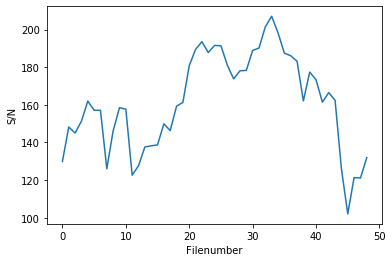

In [11]:
sn_order=[]
for i in range(len(sn)):
    sn_order.append(sn[i][40])
plt.figure()
plt.plot(sn_order)
plt.xlabel('Filenumber')
plt.ylabel('S/N')

Use the exposure with the highest S/N to obtain the continuum profile using IRAF, save it as cont.fits in ../raw/

In [17]:
print ('Filename with the highest S/N= '+str(nirlist[np.argmax(sn_order)]))
print ('Filenumber= '+str(np.argmax(sn_order)))

Filename with the highest S/N= HARPN.2017-08-01T02-42-48.545_e2ds_A.fits.gz
Filenumber= 33


## Stacking the spectrum of  each order to 2D array (wavelength bin vs time) and normalise to the stellar continuum of the reference exposure

In [14]:
#Load the continuum profile
contflux=[]
cont=fits.open(str(dir_data)+'cont.fits')
for i in range(len(cont[0].data)):
    contflux.append(cont[0].data[i])

In [15]:
wvall=[]
fluxall=[]
for order in range(len(flux[0])):
    print (order)
    masknan=~np.isnan(flux[0][order])
    for filenum in range(len(flux)):
        norm=flux[filenum][order][masknan]/contflux[order][masknan]
        masknan*=~np.isnan(norm)
    wvfile=np.zeros((len(flux),len(flux[filenum][order][masknan])))
    fluxfile=np.zeros((len(flux),len(flux[filenum][order][masknan])))
    fluxfil=np.zeros((len(flux),len(flux[filenum][order][masknan])))
    for filenum in range(len(flux)):
        fluxfil[filenum]=flux[filenum][order][masknan]
        wvfile[filenum]=wv[filenum][order][masknan]
            
    for filenum in range(len(flux)):
        norm=flux[filenum][order][masknan]/contflux[order][masknan]
        fluxfile[filenum]=norm/np.median(norm)
    wvall.append(wvfile[0])
    fluxall.append(fluxfile)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68


## Blaze Function Variation Correction

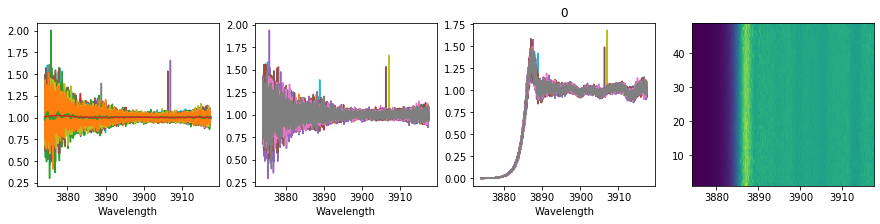

<Figure size 432x288 with 0 Axes>

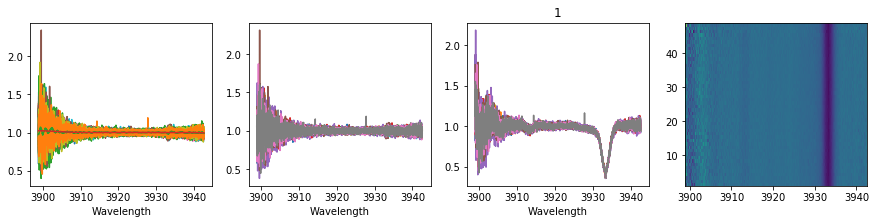

<Figure size 432x288 with 0 Axes>

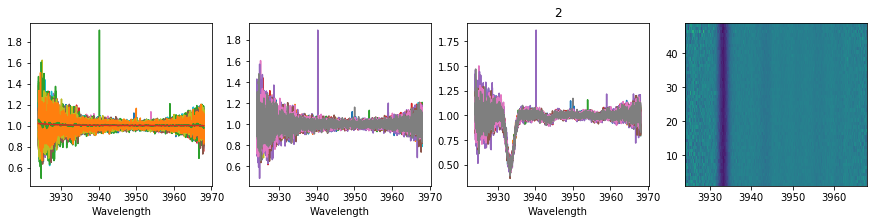

<Figure size 432x288 with 0 Axes>

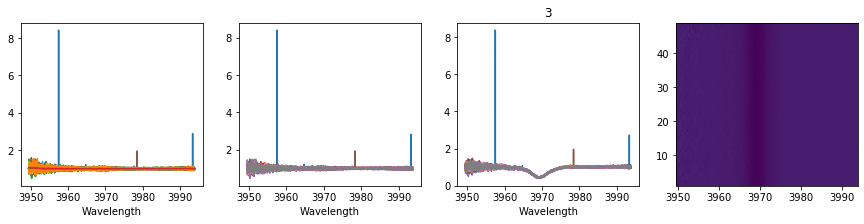

<Figure size 432x288 with 0 Axes>

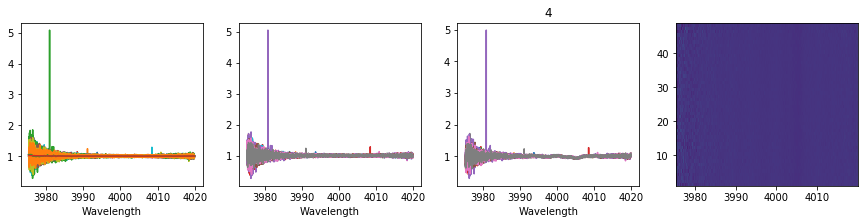

<Figure size 432x288 with 0 Axes>

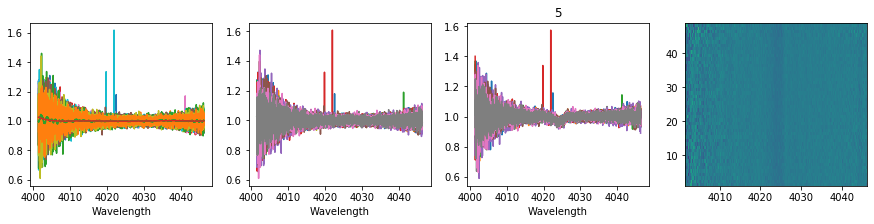

<Figure size 432x288 with 0 Axes>

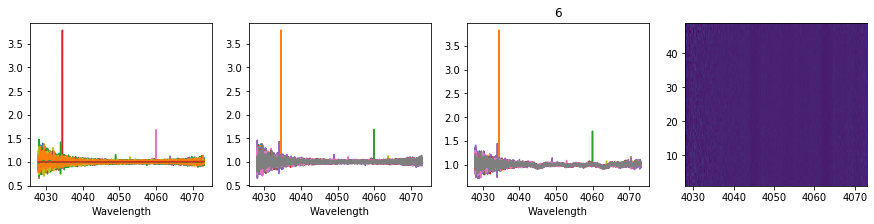

<Figure size 432x288 with 0 Axes>

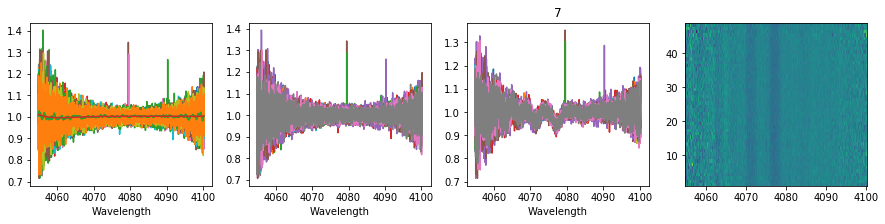

<Figure size 432x288 with 0 Axes>

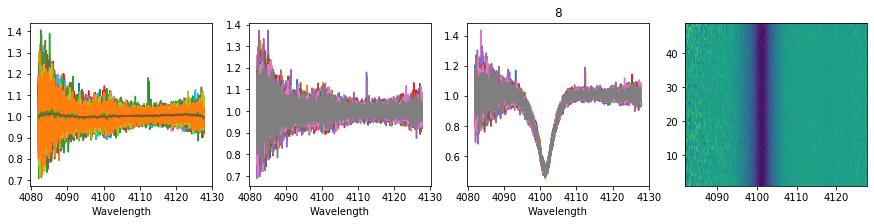

<Figure size 432x288 with 0 Axes>

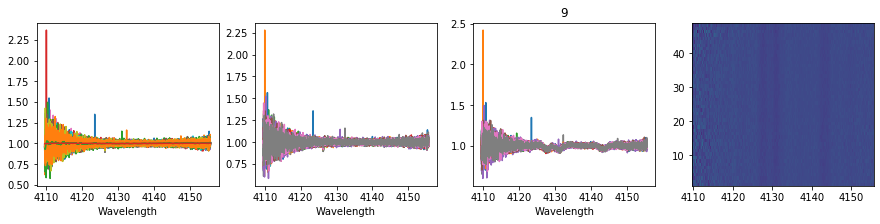

<Figure size 432x288 with 0 Axes>

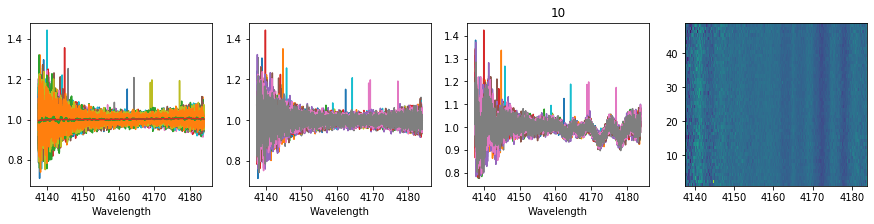

<Figure size 432x288 with 0 Axes>

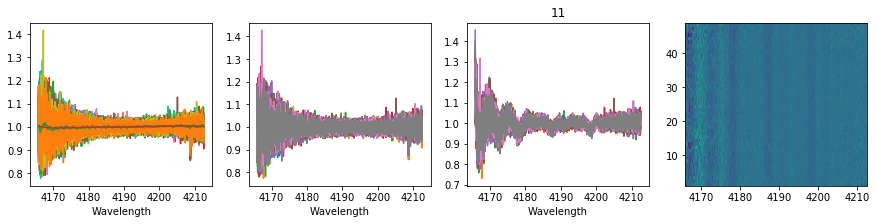

<Figure size 432x288 with 0 Axes>

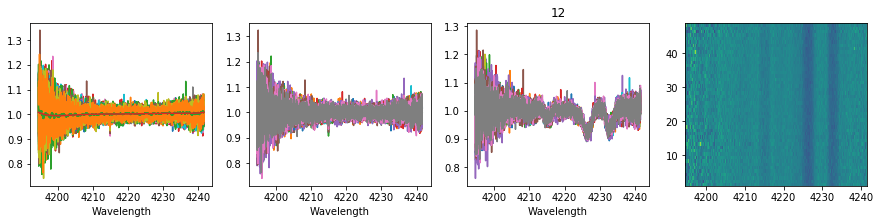

<Figure size 432x288 with 0 Axes>

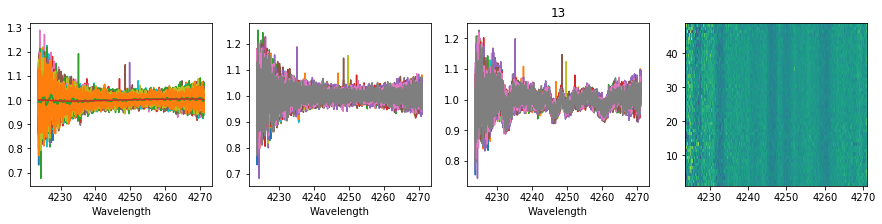

<Figure size 432x288 with 0 Axes>

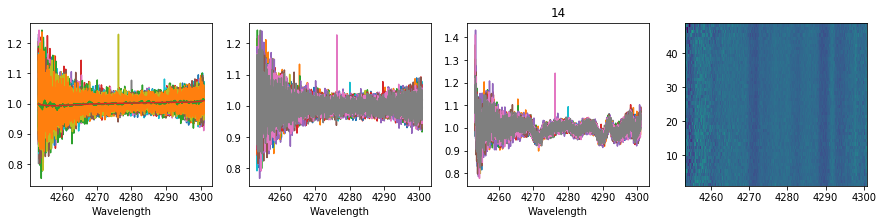

<Figure size 432x288 with 0 Axes>

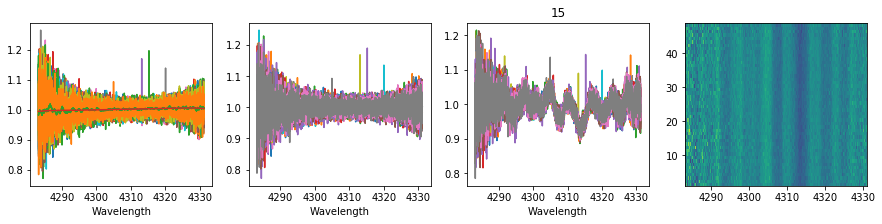

<Figure size 432x288 with 0 Axes>

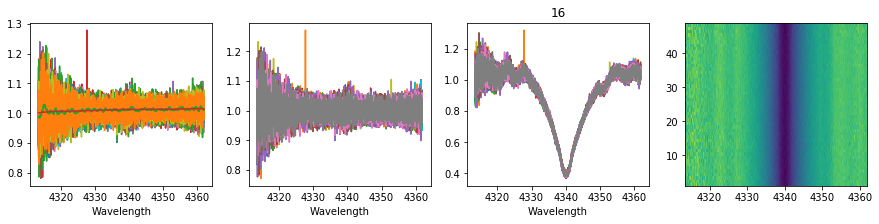

<Figure size 432x288 with 0 Axes>

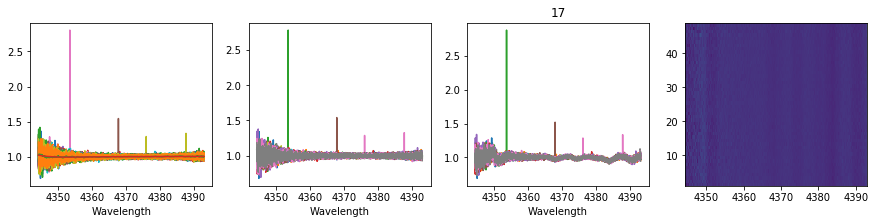

<Figure size 432x288 with 0 Axes>

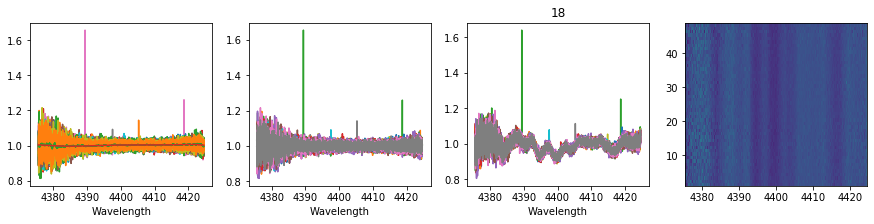

<Figure size 432x288 with 0 Axes>

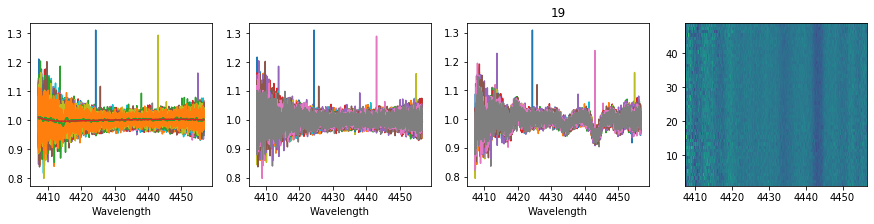

<Figure size 432x288 with 0 Axes>

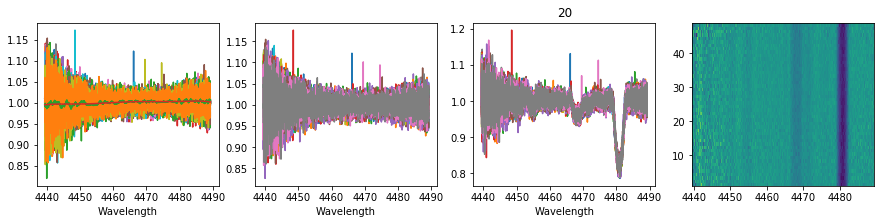

<Figure size 432x288 with 0 Axes>

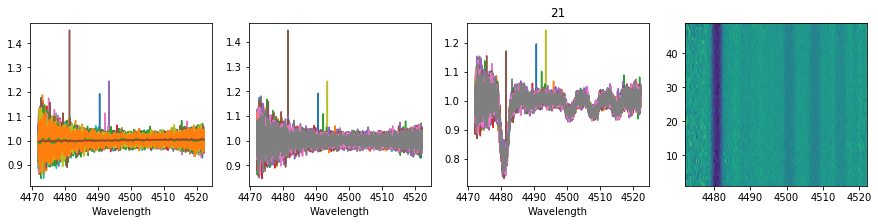

<Figure size 432x288 with 0 Axes>

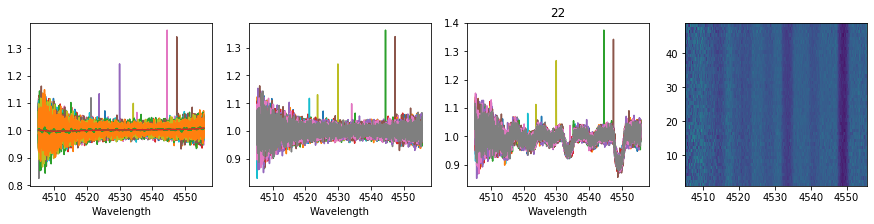

<Figure size 432x288 with 0 Axes>

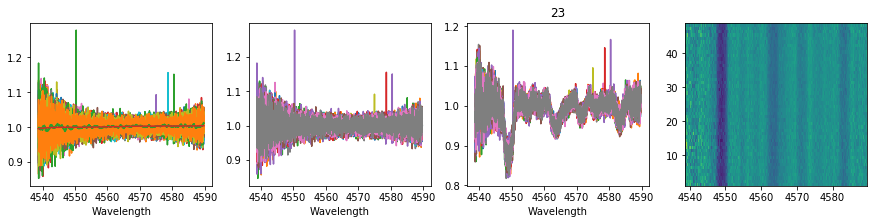

<Figure size 432x288 with 0 Axes>

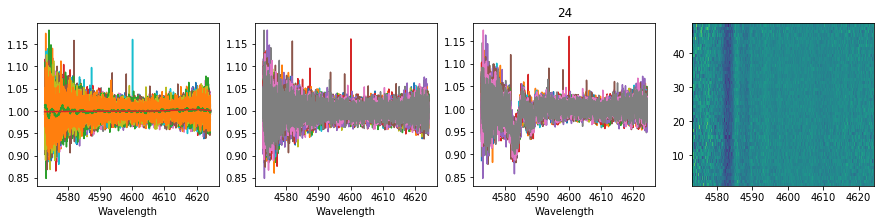

<Figure size 432x288 with 0 Axes>

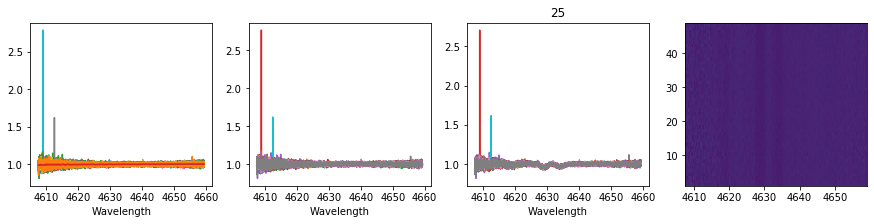

<Figure size 432x288 with 0 Axes>

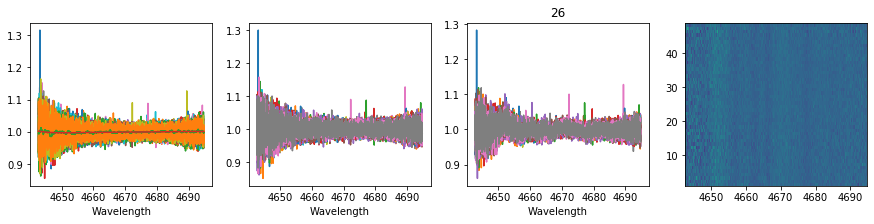

<Figure size 432x288 with 0 Axes>

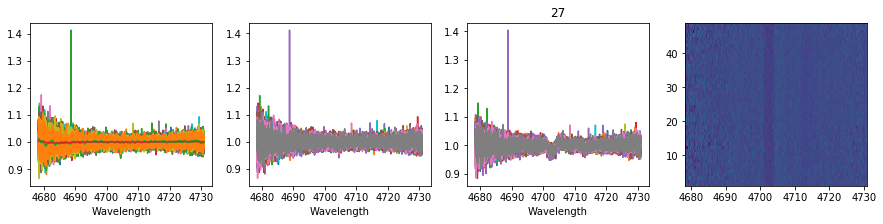

<Figure size 432x288 with 0 Axes>

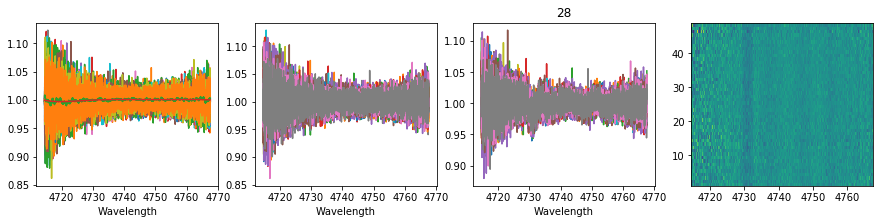

<Figure size 432x288 with 0 Axes>

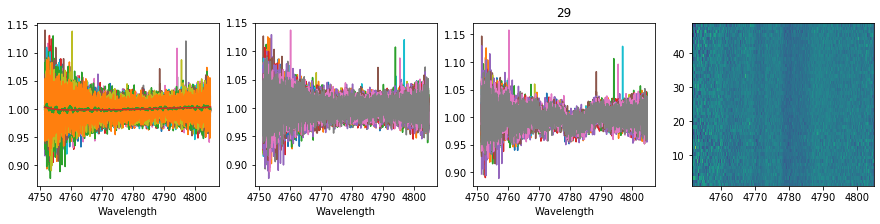

<Figure size 432x288 with 0 Axes>

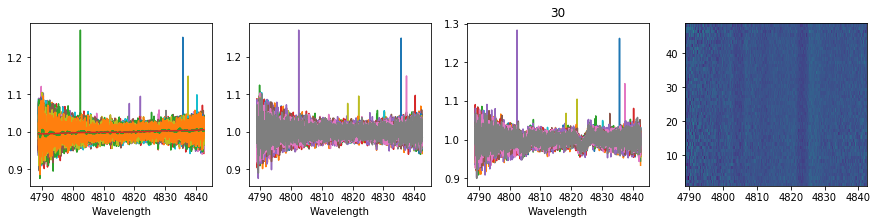

<Figure size 432x288 with 0 Axes>

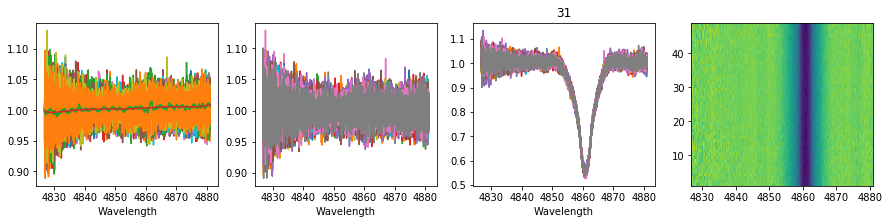

<Figure size 432x288 with 0 Axes>

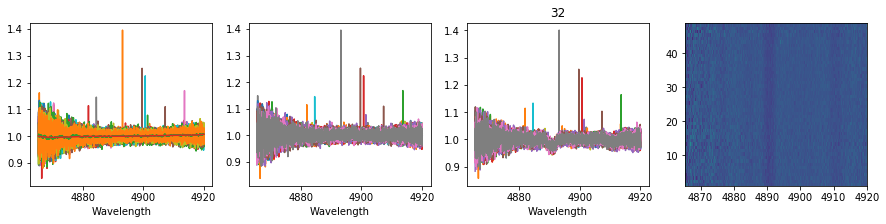

<Figure size 432x288 with 0 Axes>

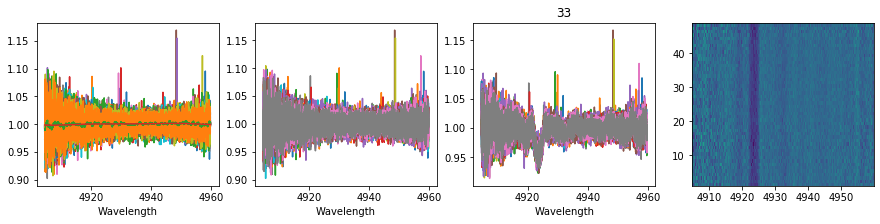

<Figure size 432x288 with 0 Axes>

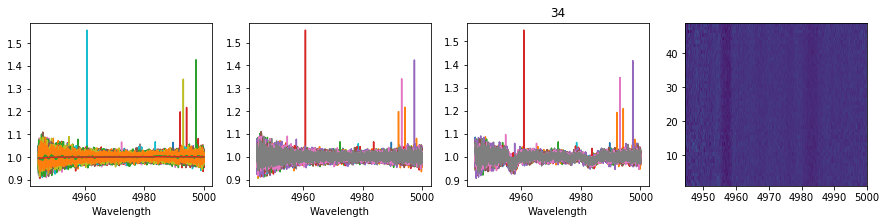

<Figure size 432x288 with 0 Axes>

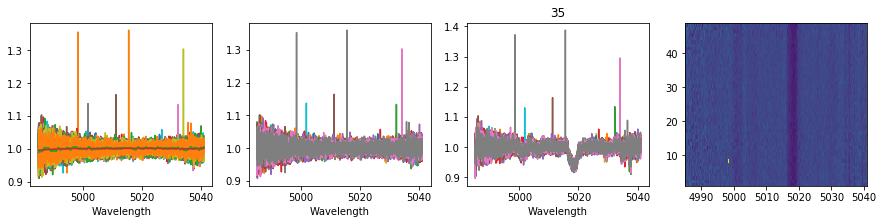

<Figure size 432x288 with 0 Axes>

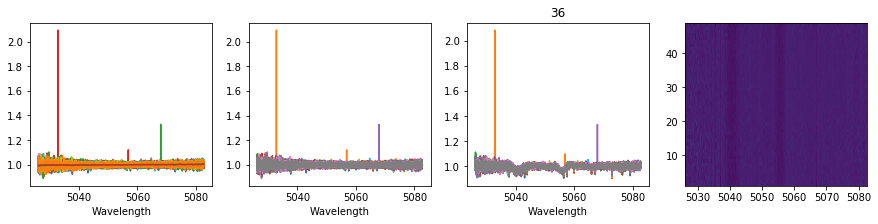

<Figure size 432x288 with 0 Axes>

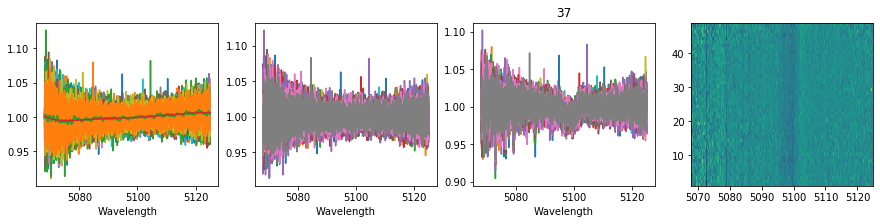

<Figure size 432x288 with 0 Axes>

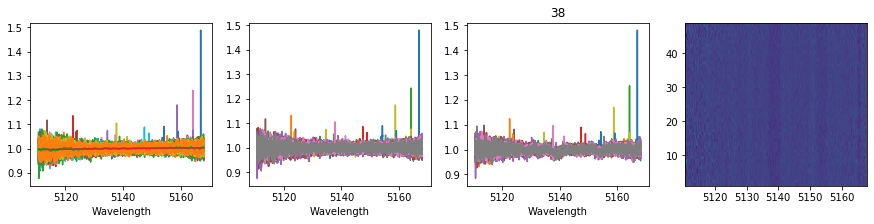

<Figure size 432x288 with 0 Axes>

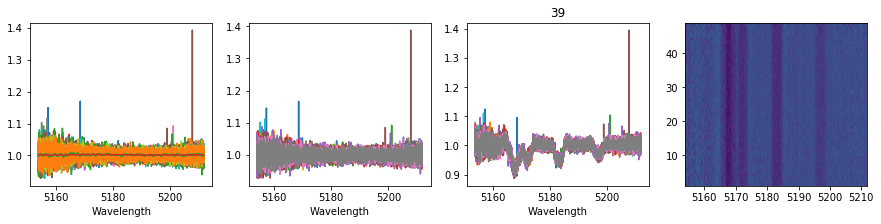

<Figure size 432x288 with 0 Axes>

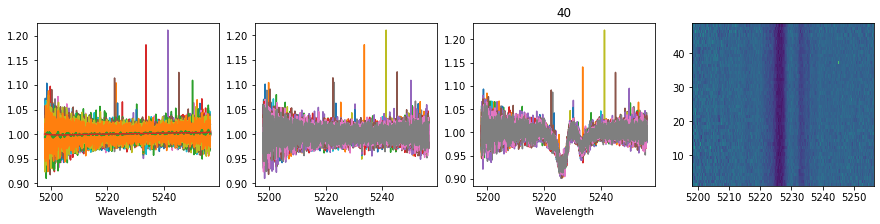

<Figure size 432x288 with 0 Axes>

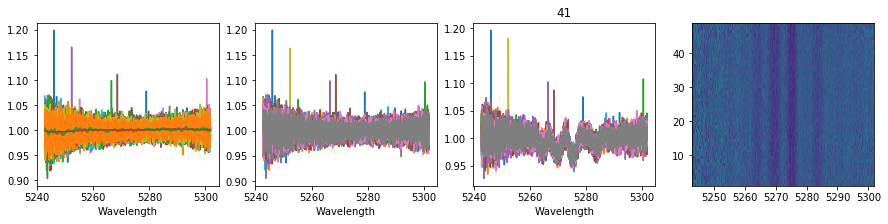

<Figure size 432x288 with 0 Axes>

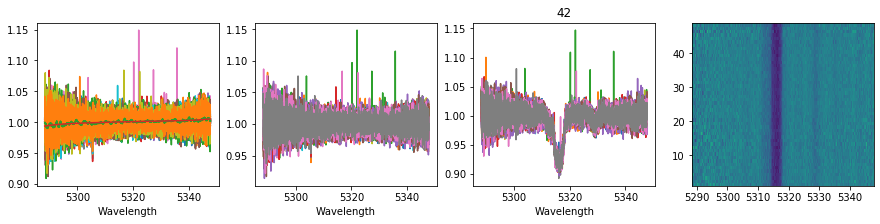

<Figure size 432x288 with 0 Axes>

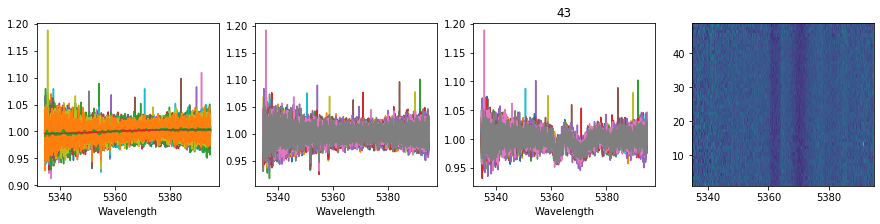

<Figure size 432x288 with 0 Axes>

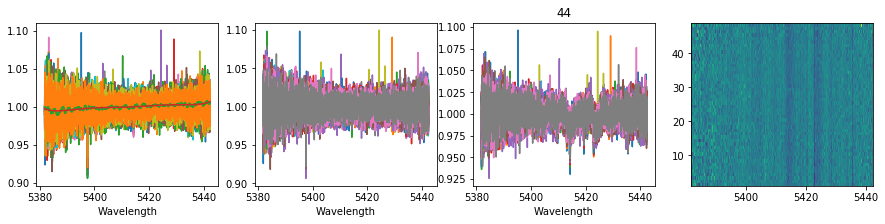

<Figure size 432x288 with 0 Axes>

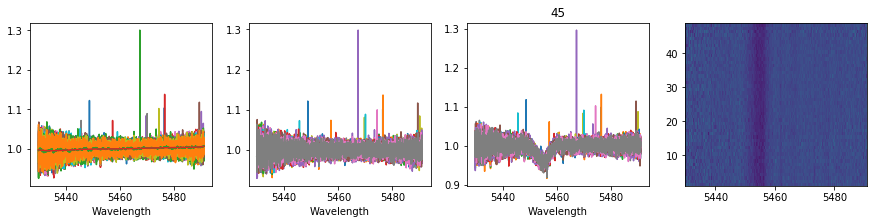

<Figure size 432x288 with 0 Axes>

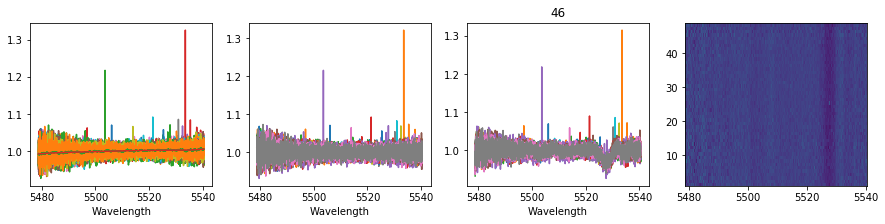

<Figure size 432x288 with 0 Axes>

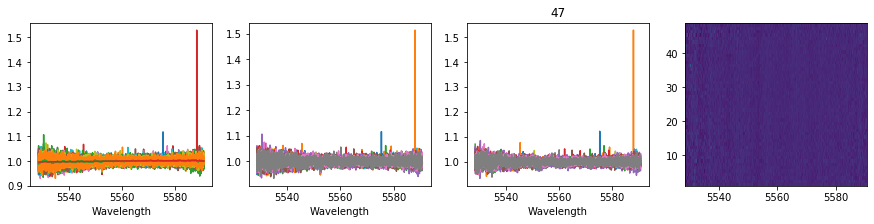

<Figure size 432x288 with 0 Axes>

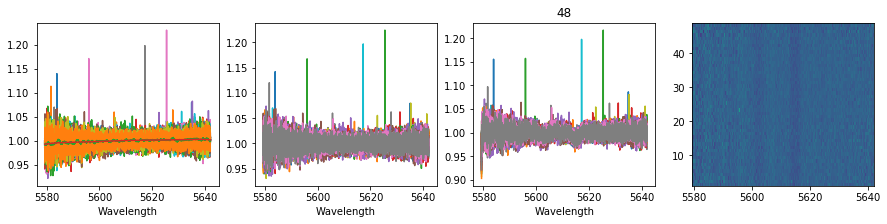

<Figure size 432x288 with 0 Axes>

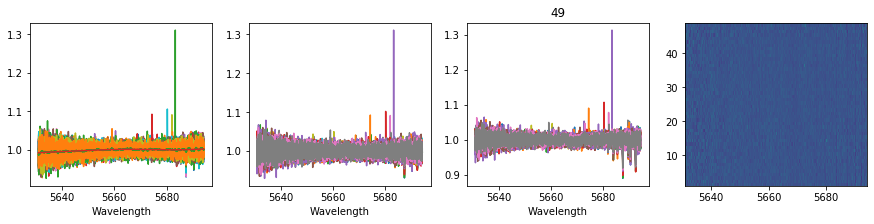

<Figure size 432x288 with 0 Axes>

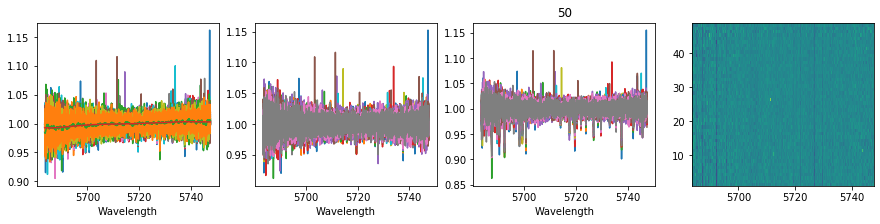

<Figure size 432x288 with 0 Axes>

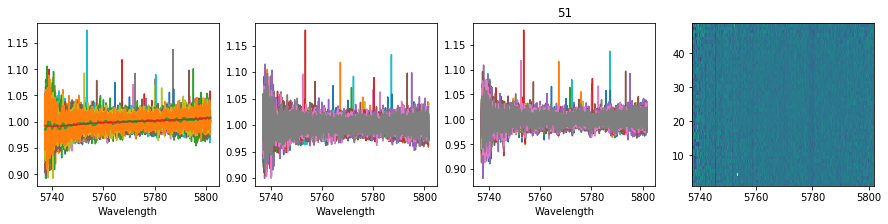

<Figure size 432x288 with 0 Axes>

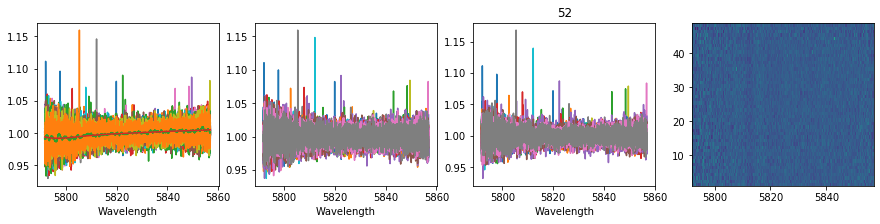

<Figure size 432x288 with 0 Axes>

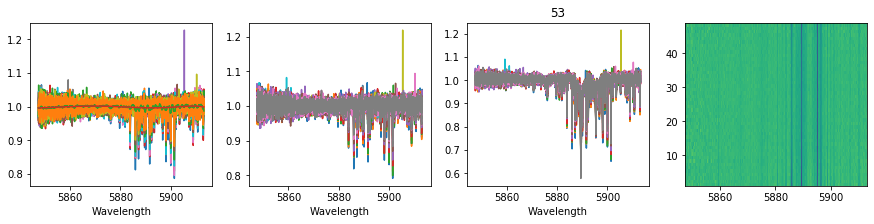

<Figure size 432x288 with 0 Axes>

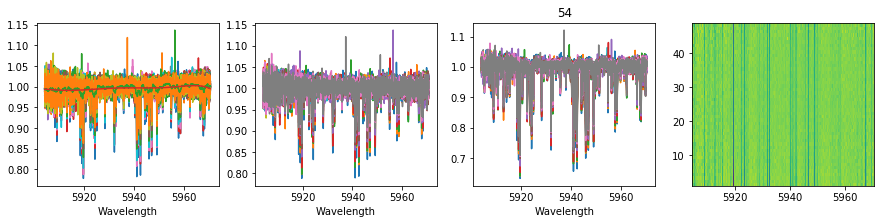

<Figure size 432x288 with 0 Axes>

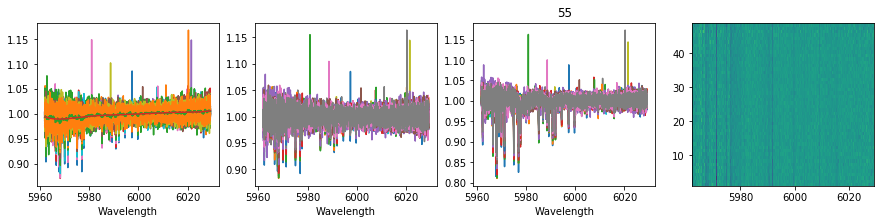

<Figure size 432x288 with 0 Axes>

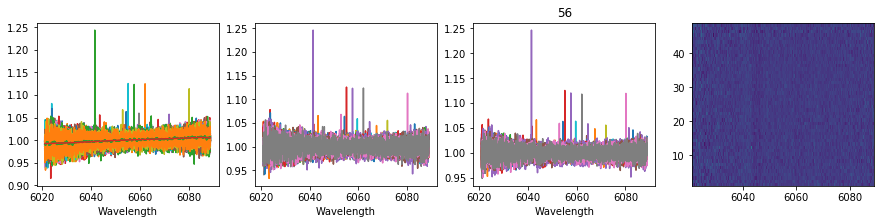

<Figure size 432x288 with 0 Axes>

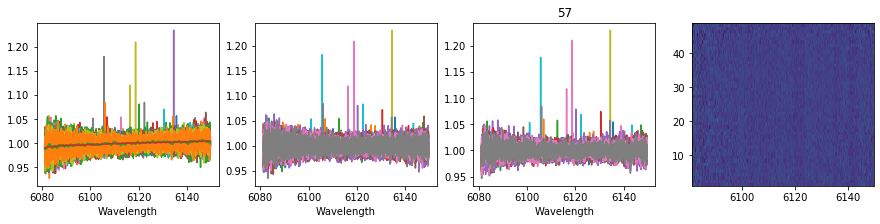

<Figure size 432x288 with 0 Axes>

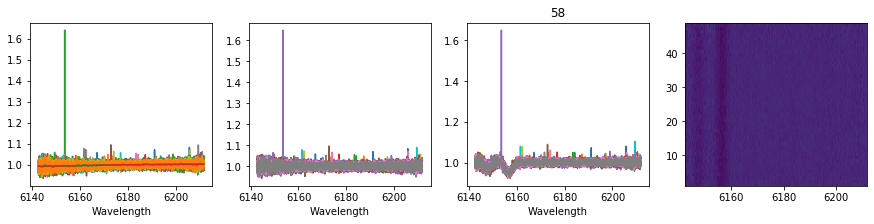

<Figure size 432x288 with 0 Axes>

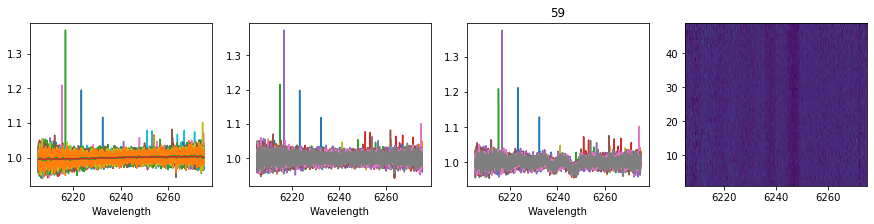

<Figure size 432x288 with 0 Axes>

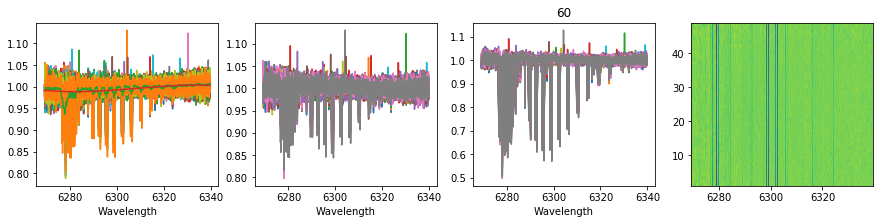

<Figure size 432x288 with 0 Axes>

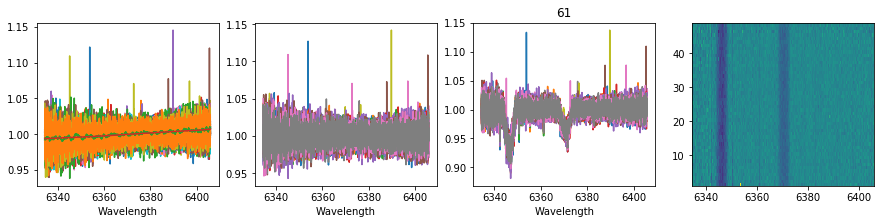

<Figure size 432x288 with 0 Axes>

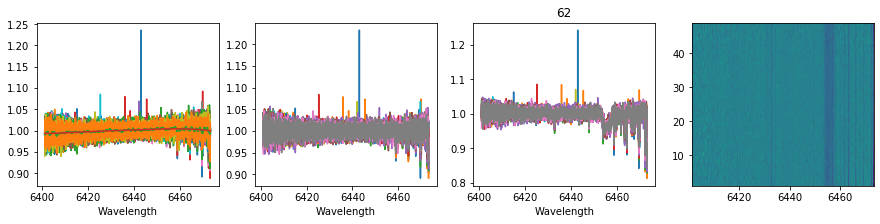

<Figure size 432x288 with 0 Axes>

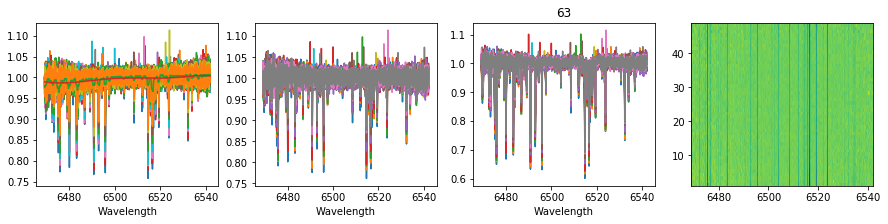

<Figure size 432x288 with 0 Axes>

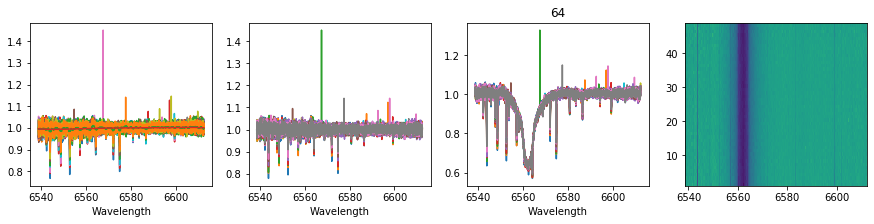

<Figure size 432x288 with 0 Axes>

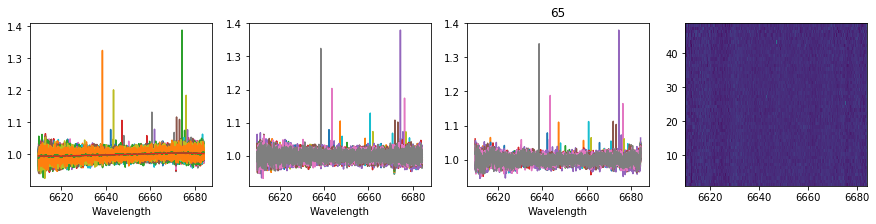

<Figure size 432x288 with 0 Axes>

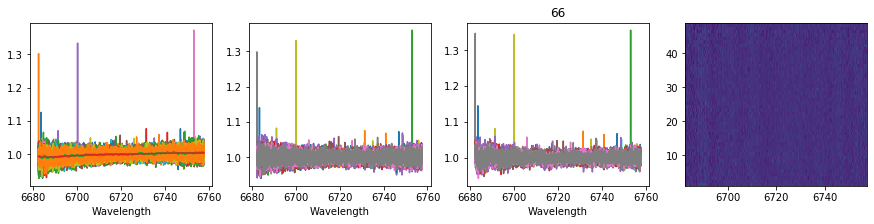

<Figure size 432x288 with 0 Axes>

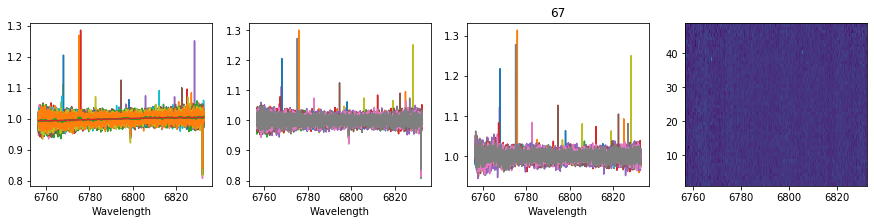

<Figure size 432x288 with 0 Axes>

In [23]:
from scipy.stats import sigmaclip as sigmaclip

reffilenum=33
blazeflux=[]
blazewv=[]

for order in range(len(fluxall)):
    masklow=np.min(fluxall[order],axis=0)>0.
    
    blflux=np.zeros((len(fluxall[order]),len(fluxall[order][0][masklow])))
    blwv=np.zeros((len(fluxall[order]),len(fluxall[order][0][masklow])))
    for filenum in range(len(fluxall[order])):
        blwv[filenum]=wvall[order][masklow]
        
    if order==68:
        for filenum in range(len(fluxall[order])):
            blflux[filenum]=fluxall[order][filenum][masklow]
    else:
        plt.figure(figsize=(15,3))
        ax1=plt.subplot(141)
        ax1.set_xlabel('Wavelength')
        ax2=plt.subplot(142)
        ax2.set_xlabel('Wavelength')
        ax3=plt.subplot(143)        
        ax3.set_xlabel('Wavelength')
        for filenum in range(len(fluxall[order])):
            if filenum == reffilenum:
                blflux[filenum]=fluxall[order][reffilenum][masklow]
            else:
                #Calculating ratio
                ratio=fluxall[order][filenum][masklow]/fluxall[order][reffilenum][masklow]
                sm1i = pyasl.smooth(ratio, 51, 'flat')
                sm2i = pyasl.smooth(ratio, 51, 'flat')
                
                residual=ratio-sm2i
                c, low, upp =sigmaclip(residual, low=3,high=3)
                if order==60:
                    mask=(np.mean(c)-3*np.std(c)<residual) *(residual<np.mean(c)+5*np.std(c))*(ratio>0.97)
                else:                
                    mask=(np.mean(c)-3*np.std(c)<residual) *(residual<np.mean(c)+5*np.std(c))*(ratio>0.9)
                mask[0]=1>0
                mask[-1]=1>0
                if order==60:
                    conti = np.polynomial.Chebyshev.fit(wvall[order][masklow][mask], sm2i[mask],3)
                else:
                    conti = np.polynomial.Chebyshev.fit(wvall[order][masklow][mask], sm2i[mask],6)
                

                ax1.plot(wvall[order][masklow],ratio)
                ax1.plot(wvall[order][masklow][mask],sm2i[mask])
                ax1.plot(wvall[order][masklow],conti(wvall[order][masklow]))
                
                ax2.plot(wvall[order][masklow],ratio/conti(wvall[order][masklow]))
                plt.title(str(order))
                
                ax3.plot(wvall[order][masklow],fluxall[order][reffilenum][masklow]*ratio/conti(wvall[order][masklow]))
                blflux[filenum]=fluxall[order][reffilenum][masklow]*ratio/conti(wvall[order][masklow])
        plt.subplot(144) 
        plt.pcolormesh(wvall[order][masklow],np.arange(1,len(fluxall[order])+1,1),blflux)
        plt.show()
        plt.clf()
    blazeflux.append(blflux)
    blazewv.append(blwv)

## Masking bad pixels

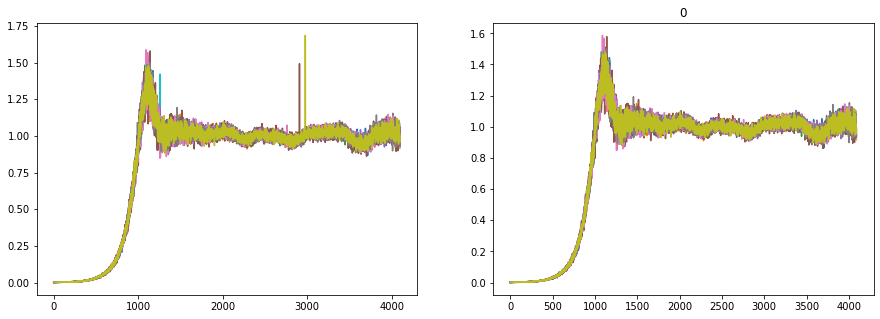

<Figure size 432x288 with 0 Axes>

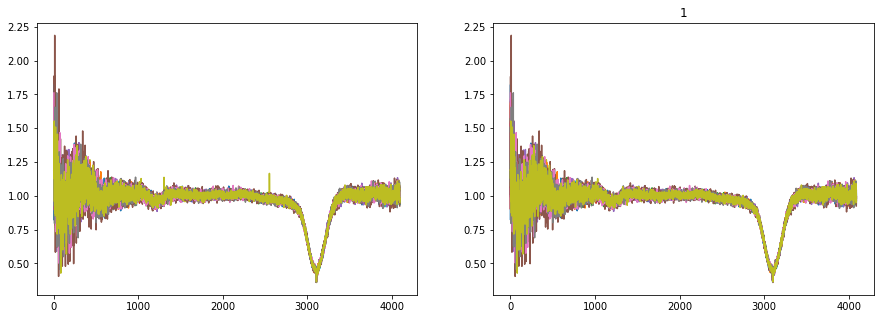

<Figure size 432x288 with 0 Axes>

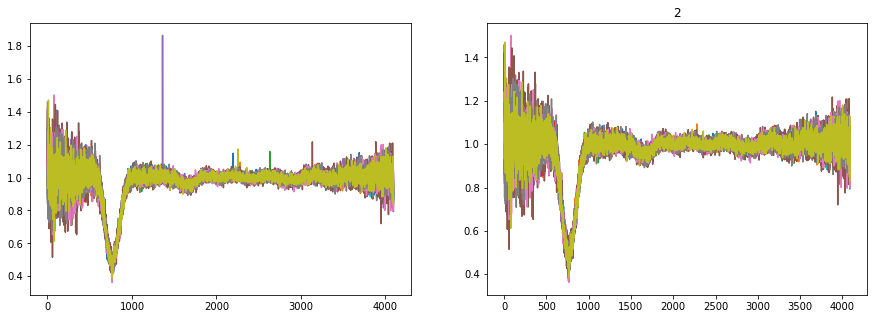

<Figure size 432x288 with 0 Axes>

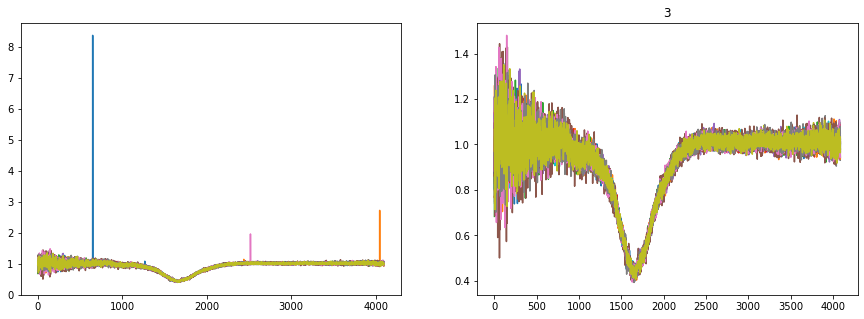

<Figure size 432x288 with 0 Axes>

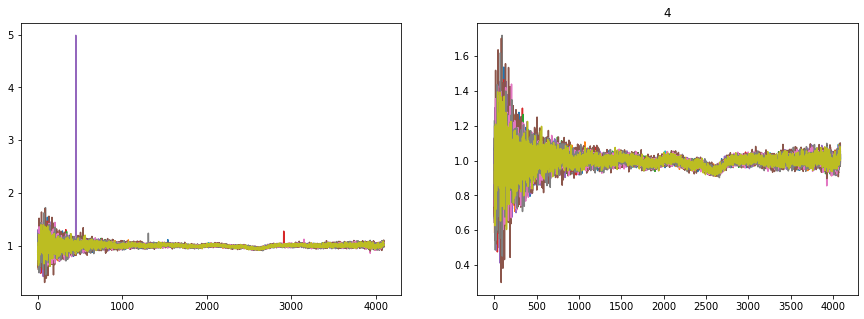

<Figure size 432x288 with 0 Axes>

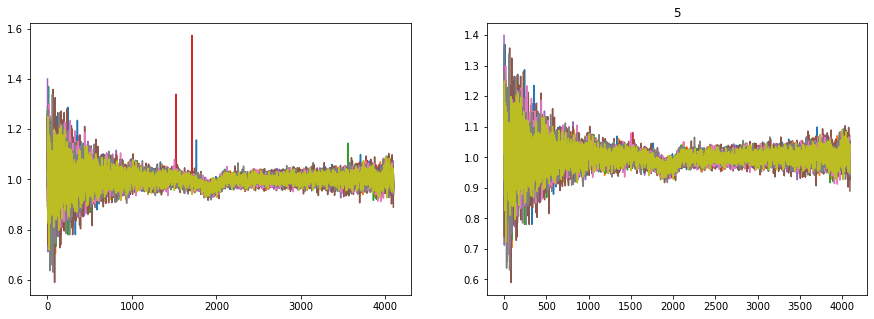

<Figure size 432x288 with 0 Axes>

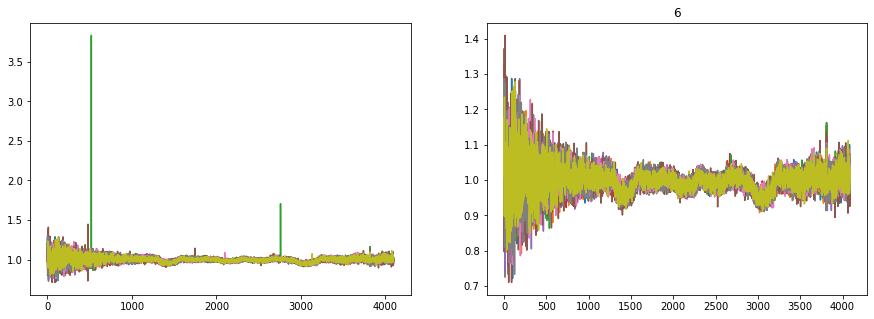

<Figure size 432x288 with 0 Axes>

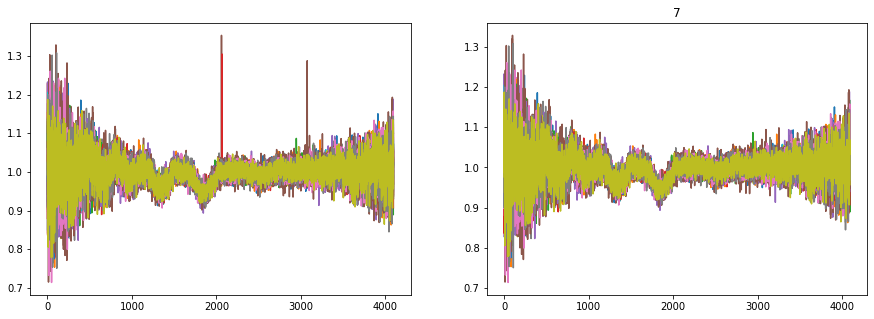

<Figure size 432x288 with 0 Axes>

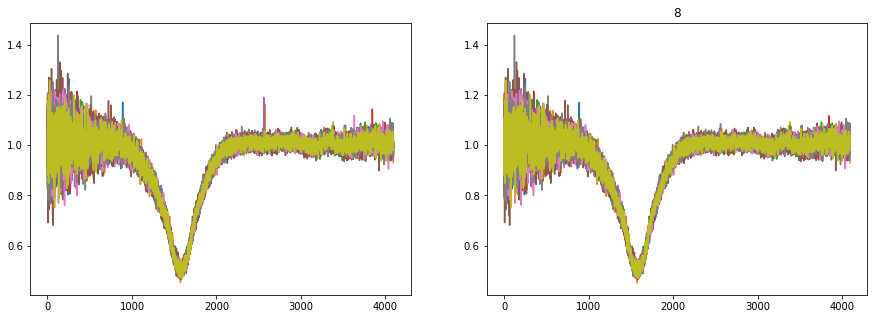

<Figure size 432x288 with 0 Axes>

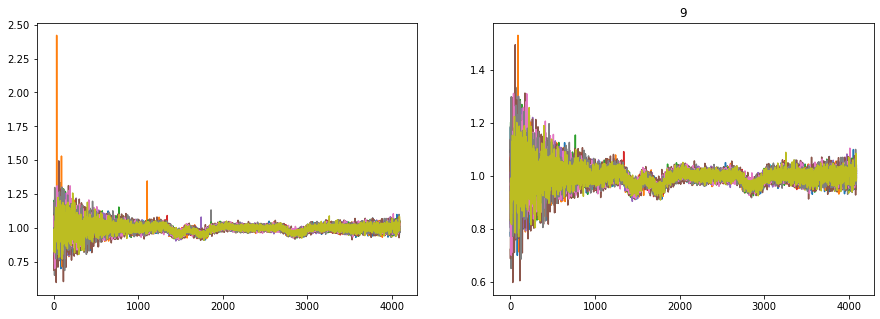

<Figure size 432x288 with 0 Axes>

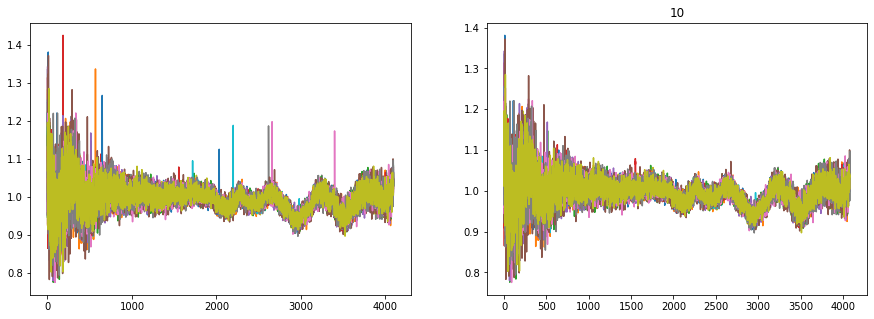

<Figure size 432x288 with 0 Axes>

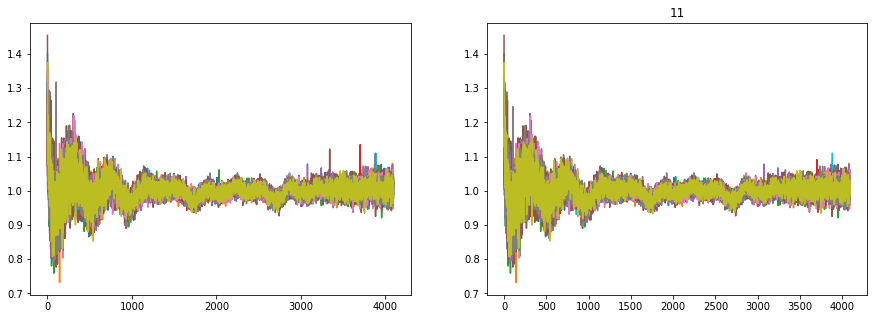

<Figure size 432x288 with 0 Axes>

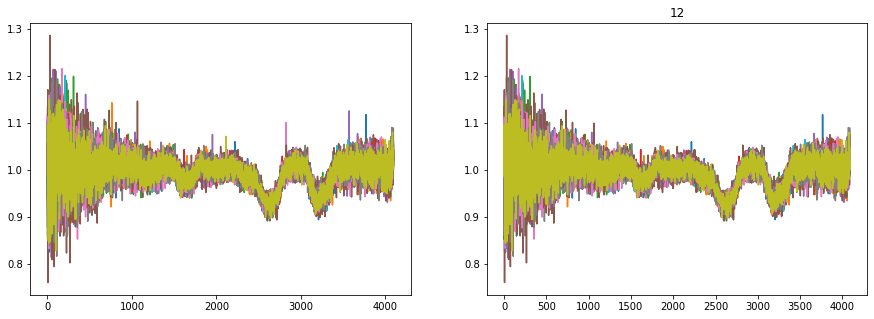

<Figure size 432x288 with 0 Axes>

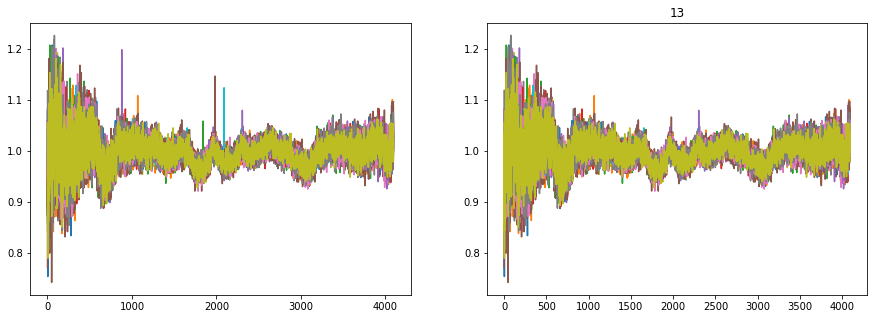

<Figure size 432x288 with 0 Axes>

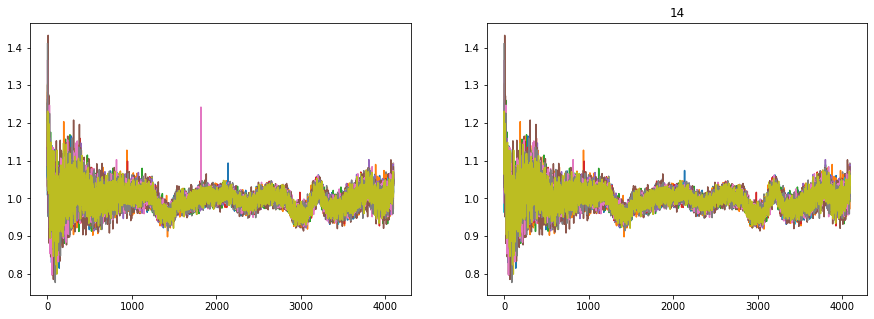

<Figure size 432x288 with 0 Axes>

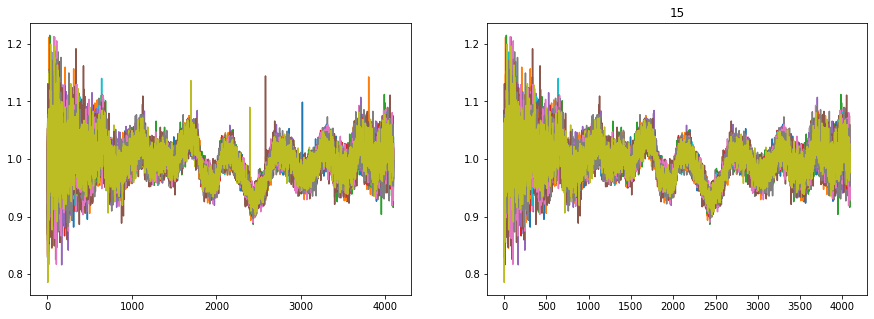

<Figure size 432x288 with 0 Axes>

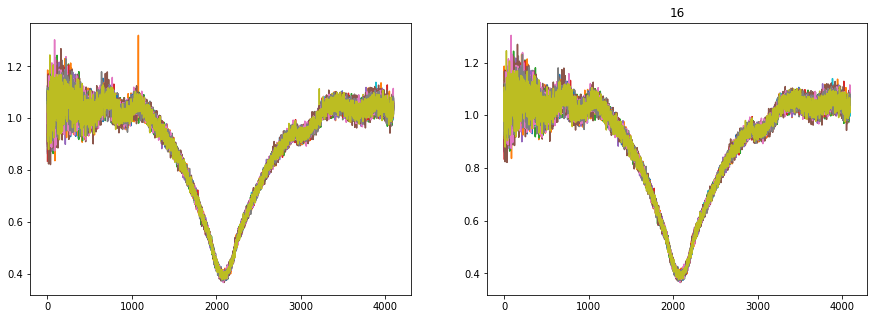

<Figure size 432x288 with 0 Axes>

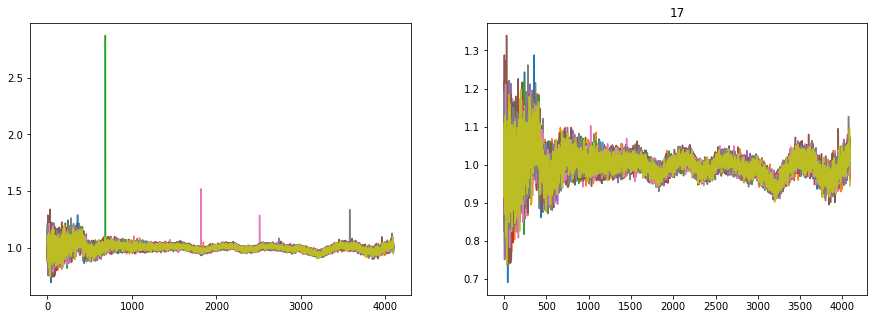

<Figure size 432x288 with 0 Axes>

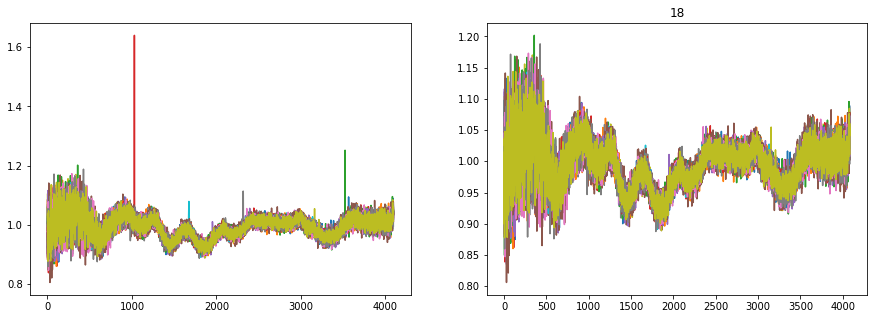

<Figure size 432x288 with 0 Axes>

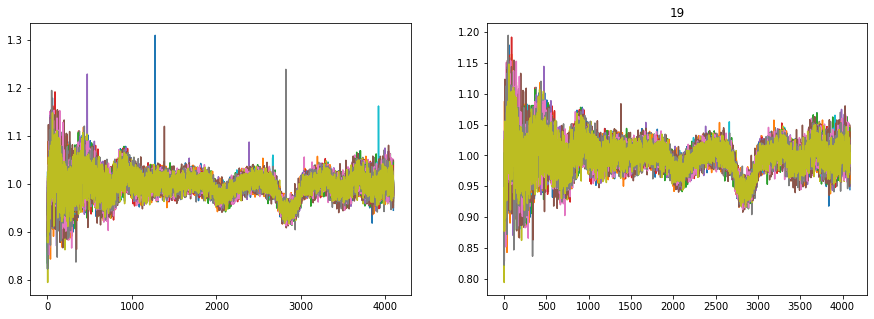

<Figure size 432x288 with 0 Axes>

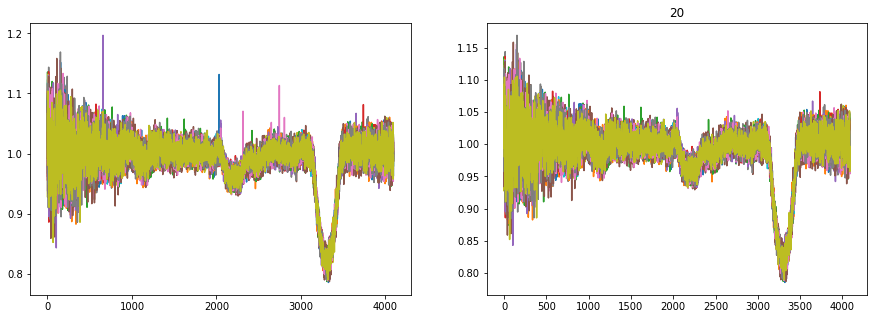

<Figure size 432x288 with 0 Axes>

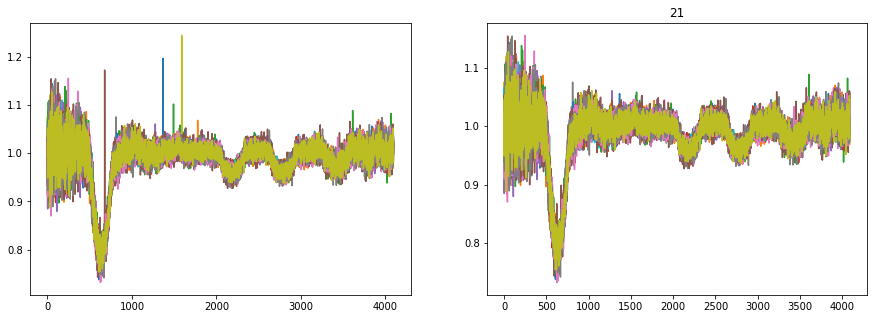

<Figure size 432x288 with 0 Axes>

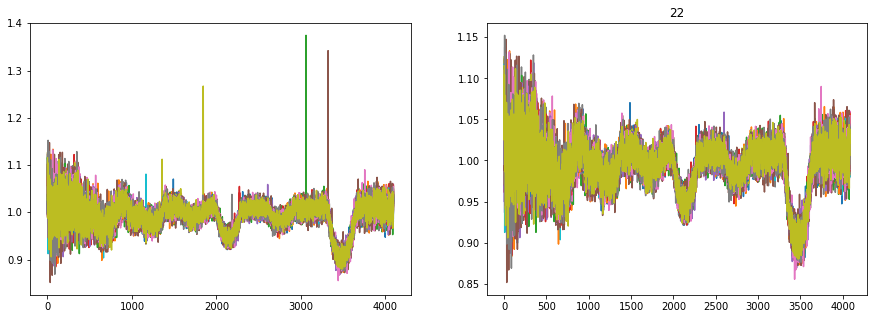

<Figure size 432x288 with 0 Axes>

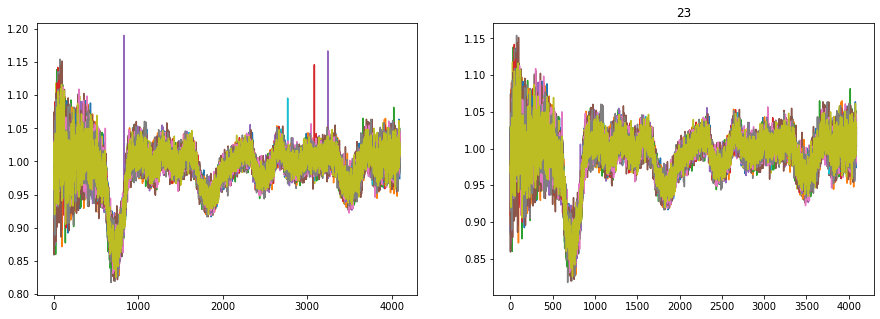

<Figure size 432x288 with 0 Axes>

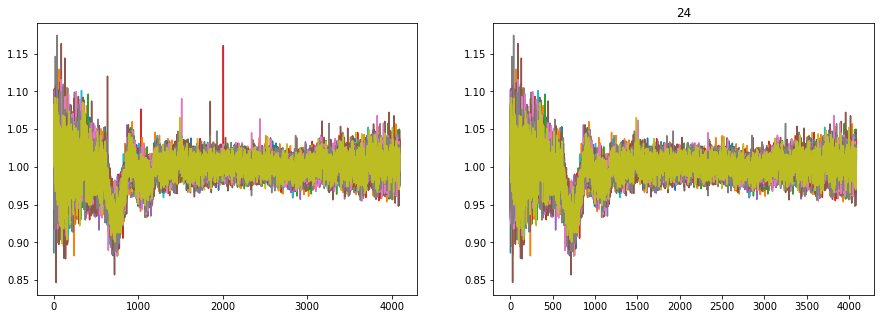

<Figure size 432x288 with 0 Axes>

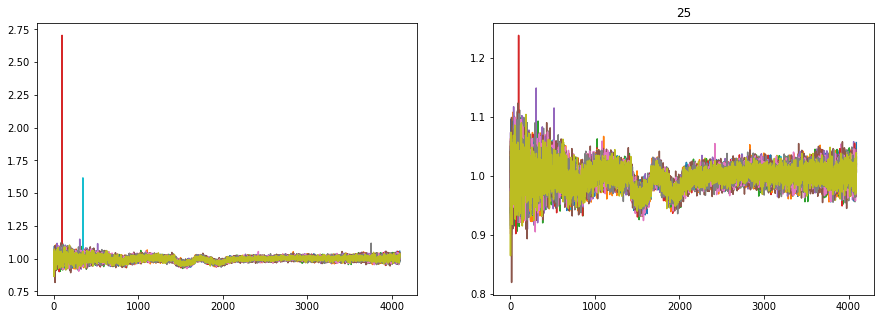

<Figure size 432x288 with 0 Axes>

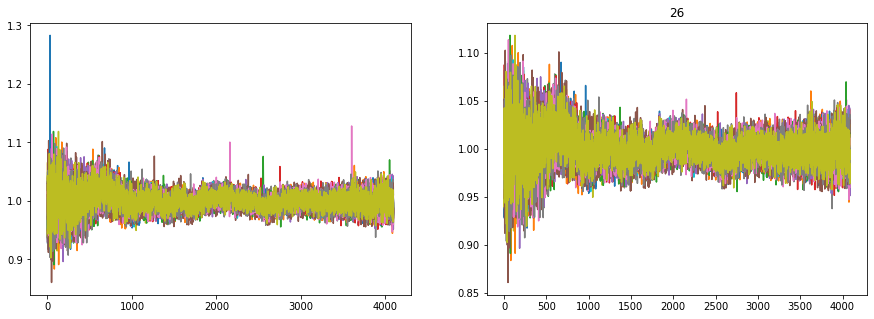

<Figure size 432x288 with 0 Axes>

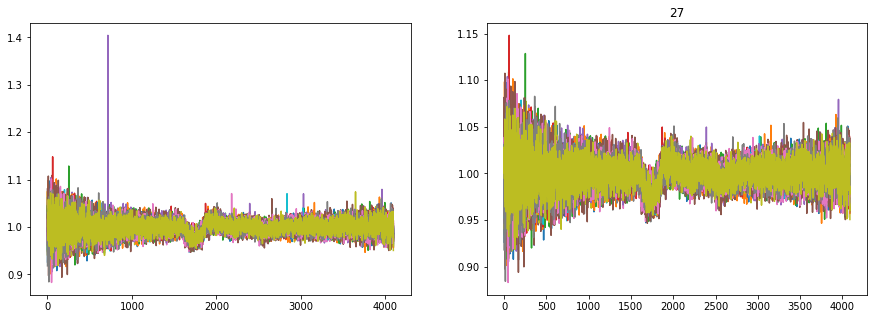

<Figure size 432x288 with 0 Axes>

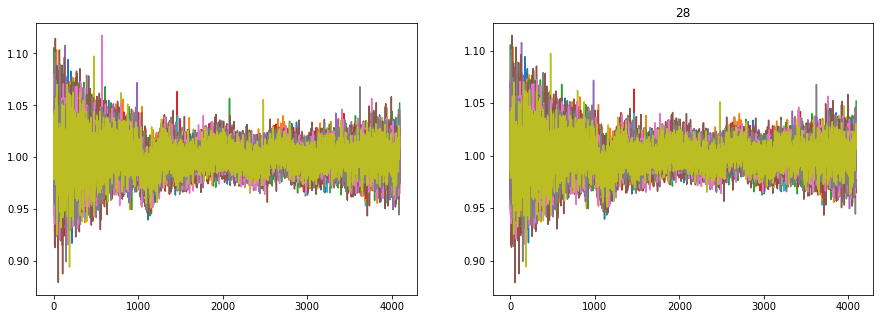

<Figure size 432x288 with 0 Axes>

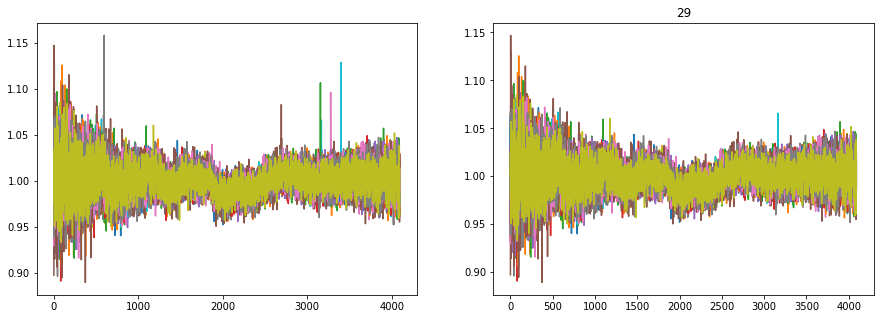

<Figure size 432x288 with 0 Axes>

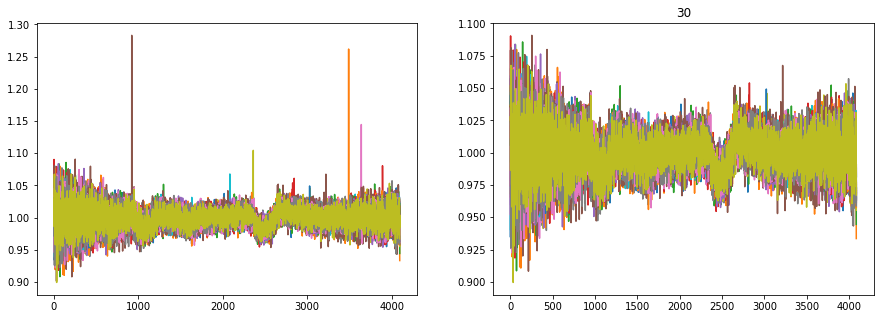

<Figure size 432x288 with 0 Axes>

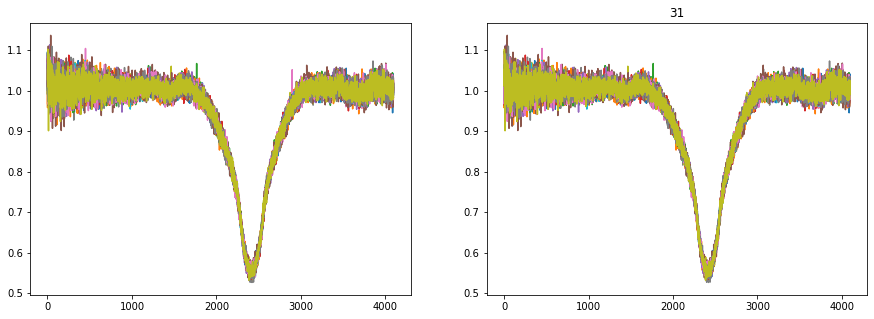

<Figure size 432x288 with 0 Axes>

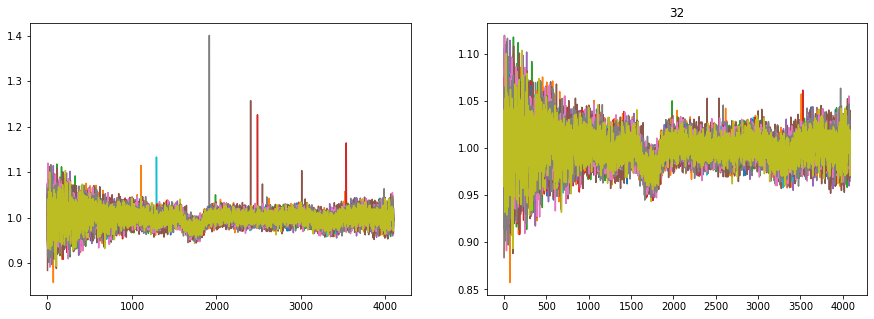

<Figure size 432x288 with 0 Axes>

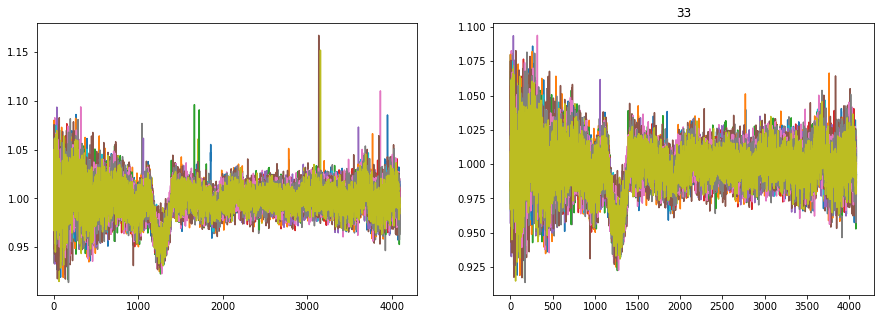

<Figure size 432x288 with 0 Axes>

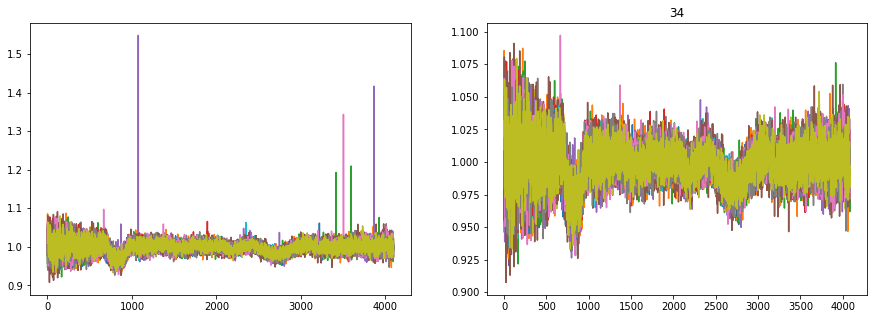

<Figure size 432x288 with 0 Axes>

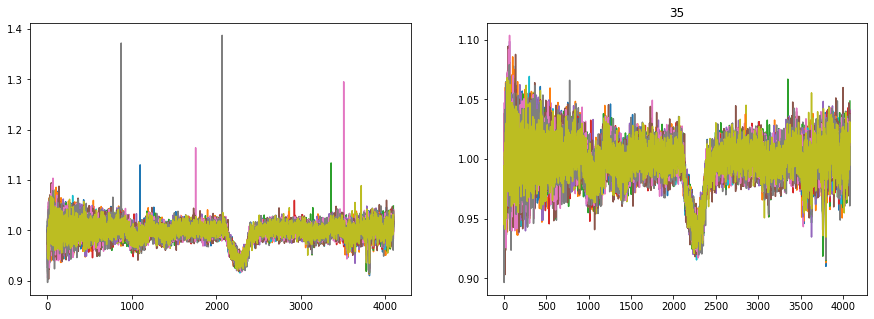

<Figure size 432x288 with 0 Axes>

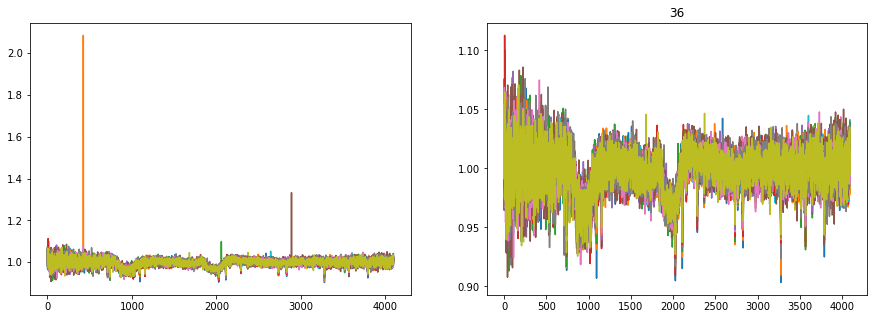

<Figure size 432x288 with 0 Axes>

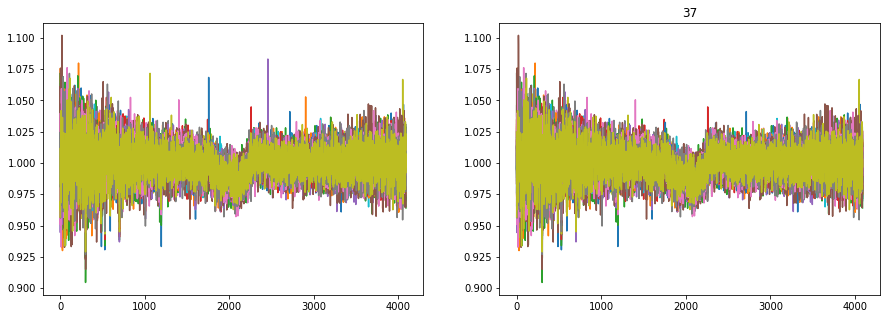

<Figure size 432x288 with 0 Axes>

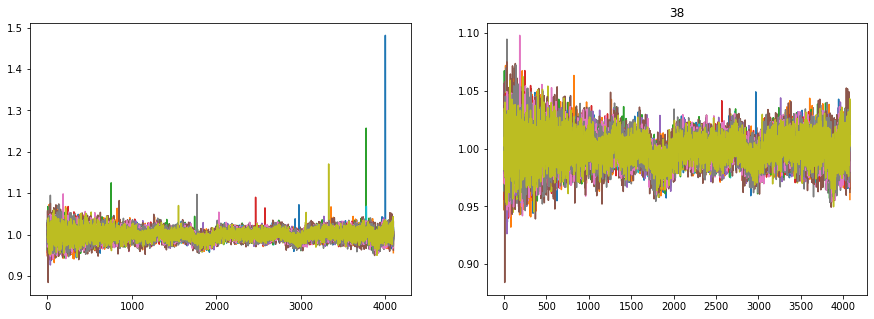

<Figure size 432x288 with 0 Axes>

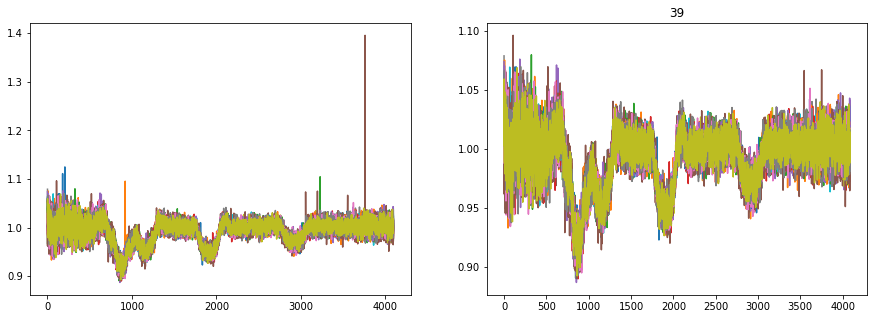

<Figure size 432x288 with 0 Axes>

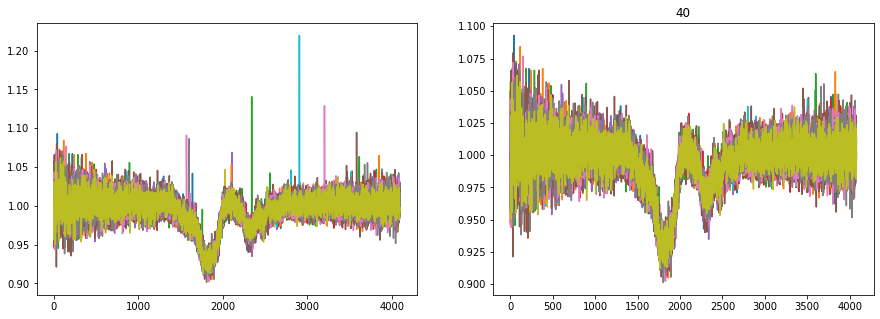

<Figure size 432x288 with 0 Axes>

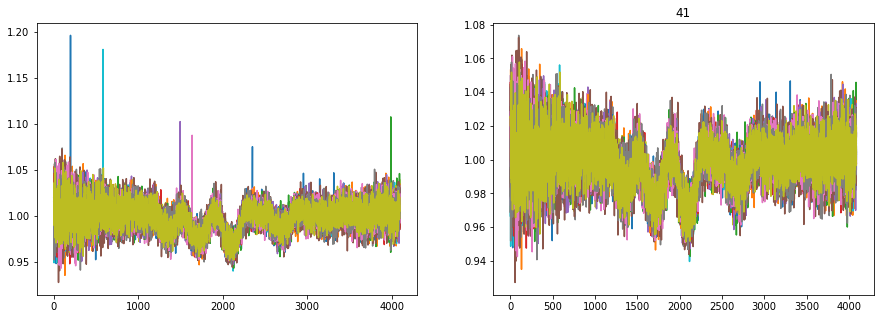

<Figure size 432x288 with 0 Axes>

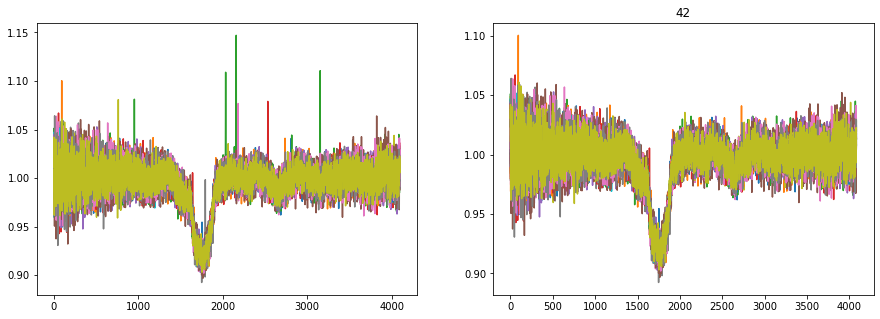

<Figure size 432x288 with 0 Axes>

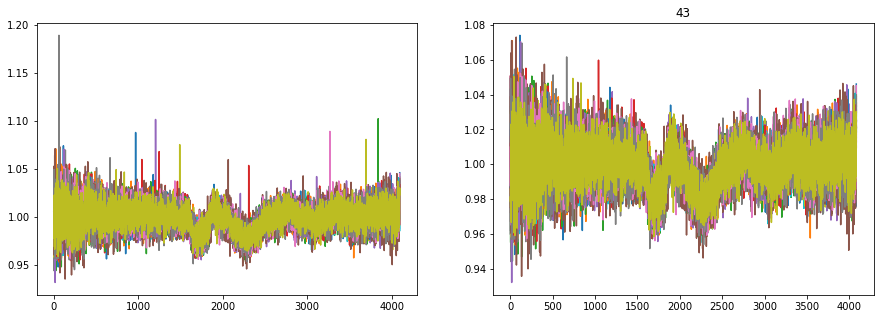

<Figure size 432x288 with 0 Axes>

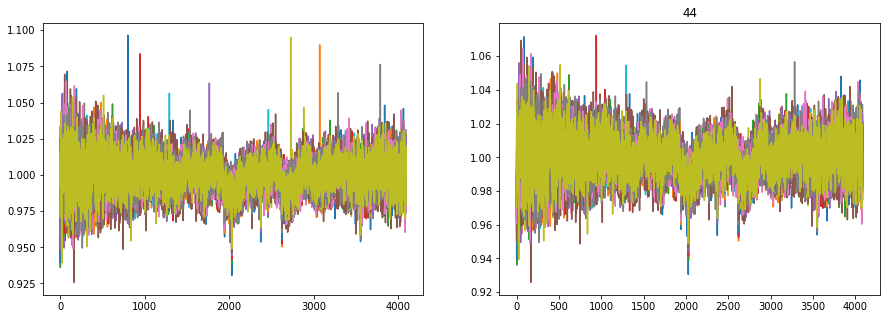

<Figure size 432x288 with 0 Axes>

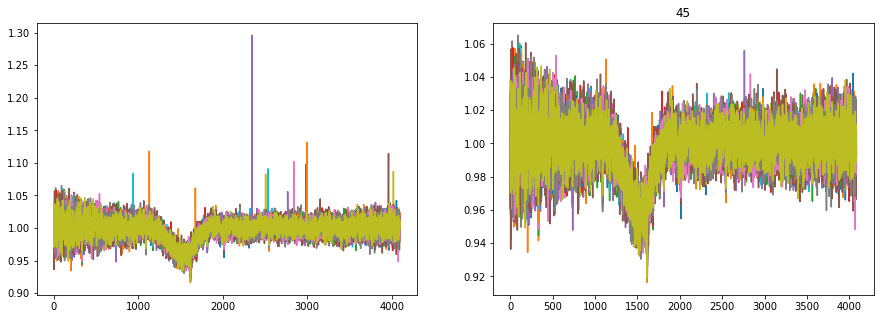

<Figure size 432x288 with 0 Axes>

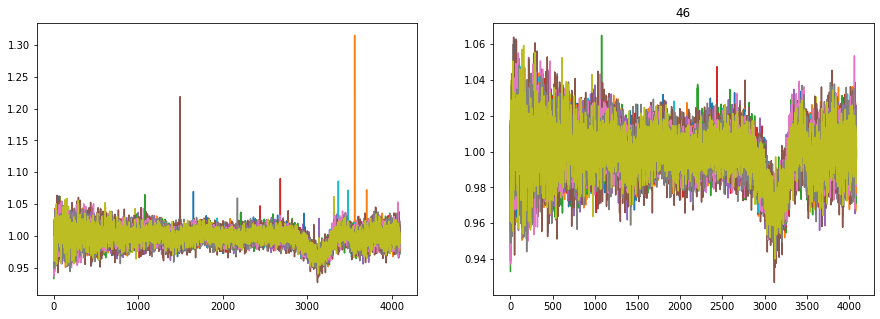

<Figure size 432x288 with 0 Axes>

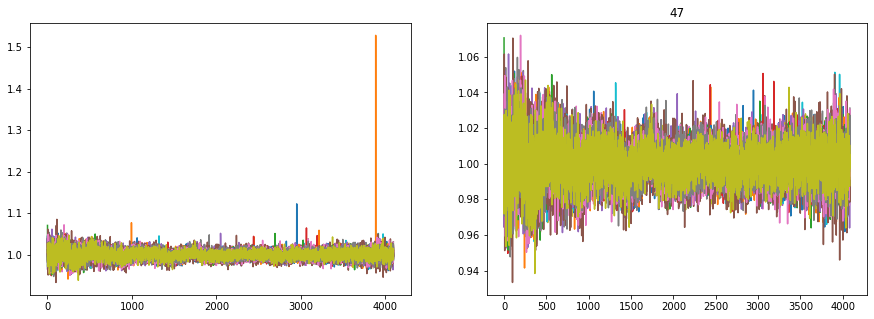

<Figure size 432x288 with 0 Axes>

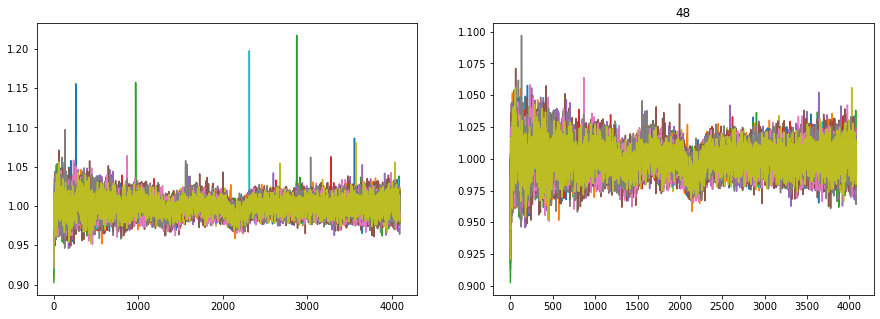

<Figure size 432x288 with 0 Axes>

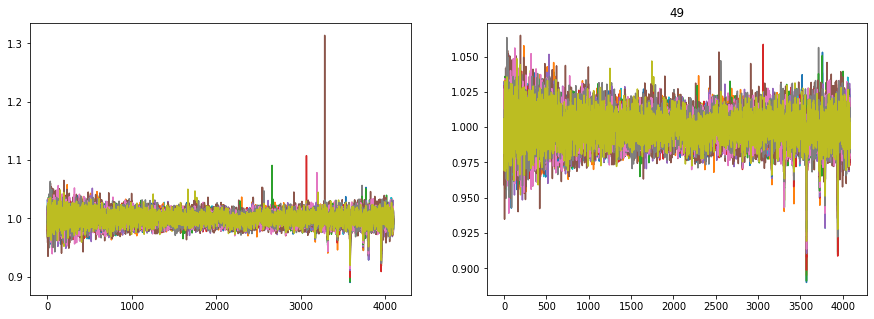

<Figure size 432x288 with 0 Axes>

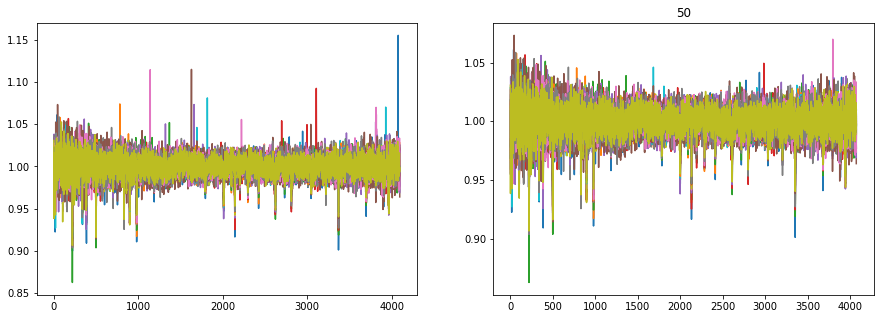

<Figure size 432x288 with 0 Axes>

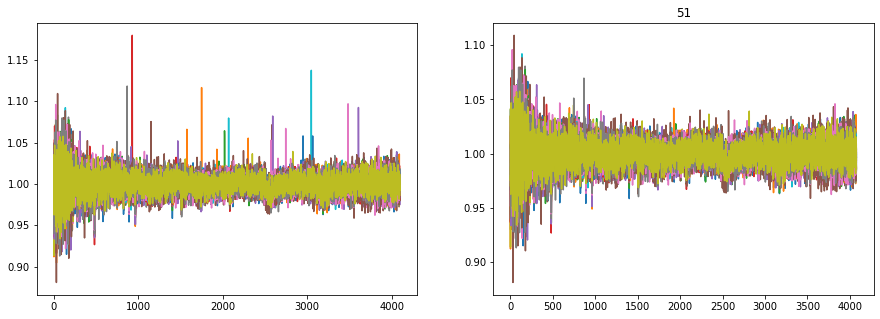

<Figure size 432x288 with 0 Axes>

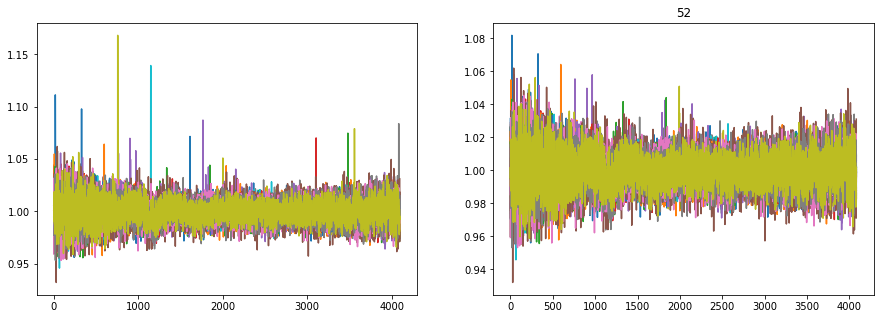

<Figure size 432x288 with 0 Axes>

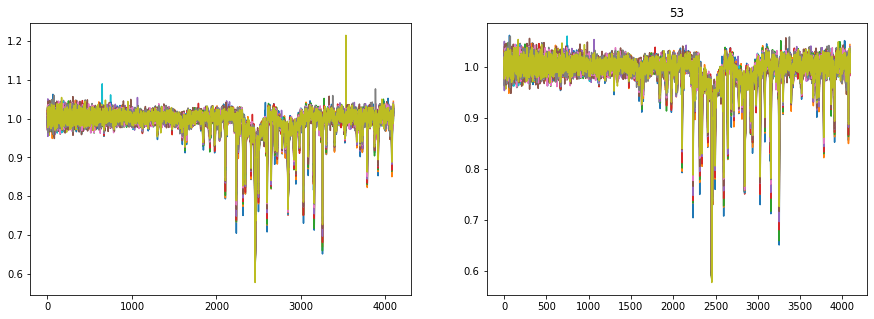

<Figure size 432x288 with 0 Axes>

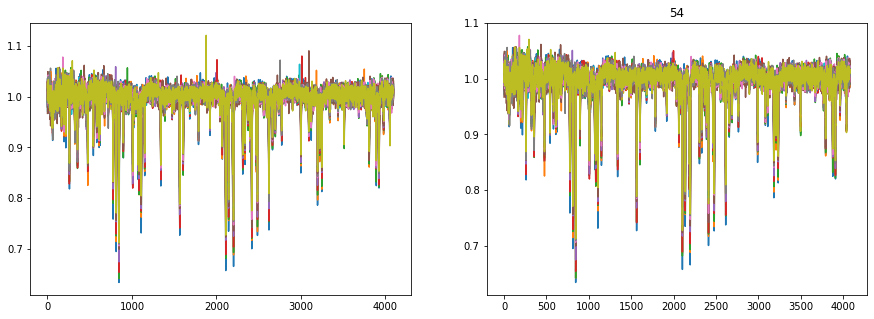

<Figure size 432x288 with 0 Axes>

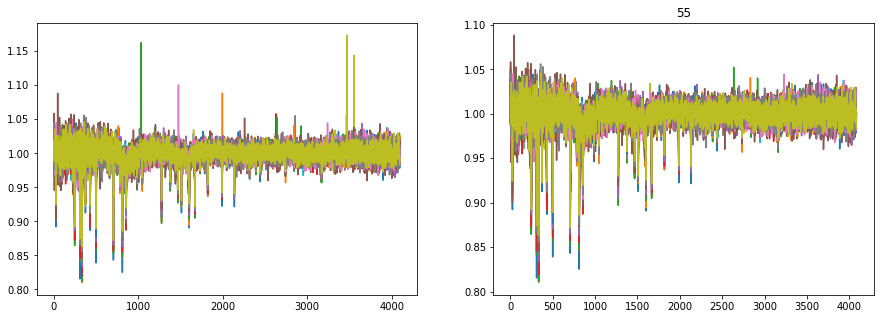

<Figure size 432x288 with 0 Axes>

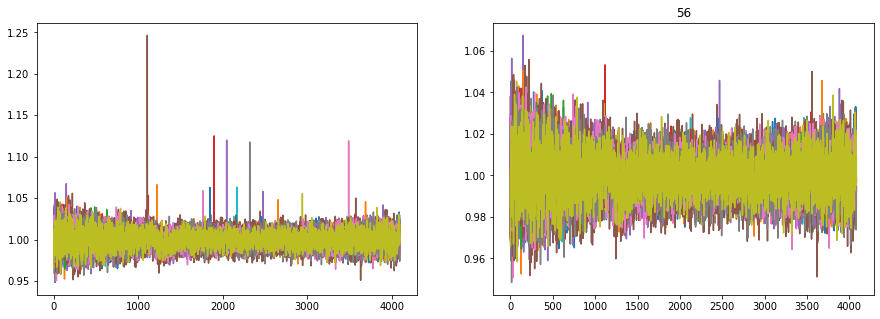

<Figure size 432x288 with 0 Axes>

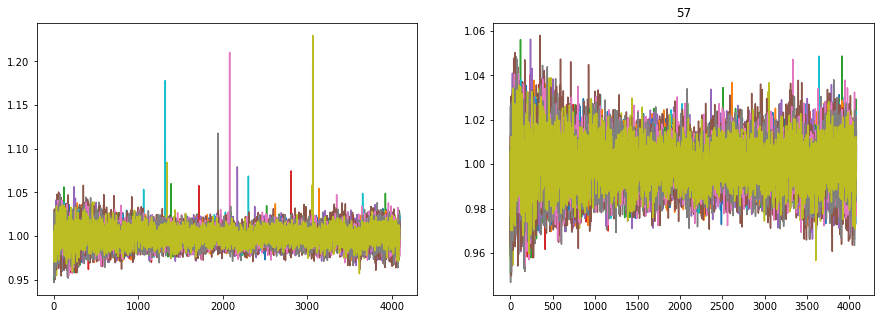

<Figure size 432x288 with 0 Axes>

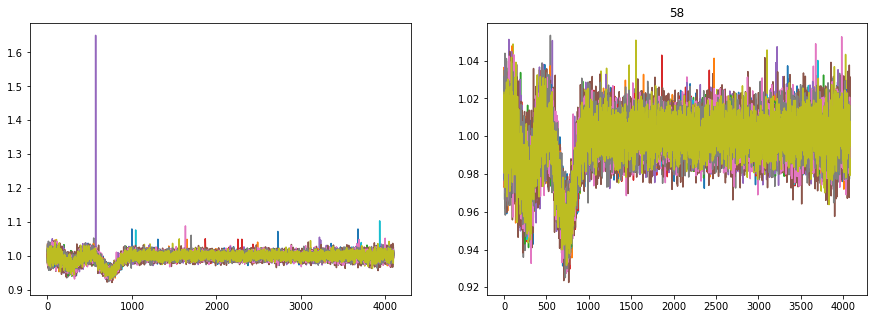

<Figure size 432x288 with 0 Axes>

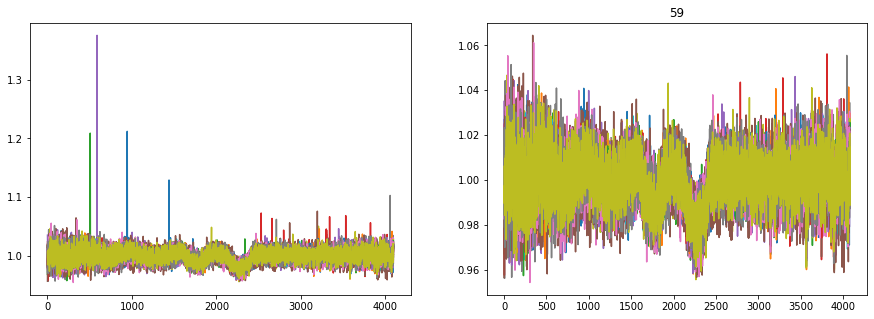

<Figure size 432x288 with 0 Axes>

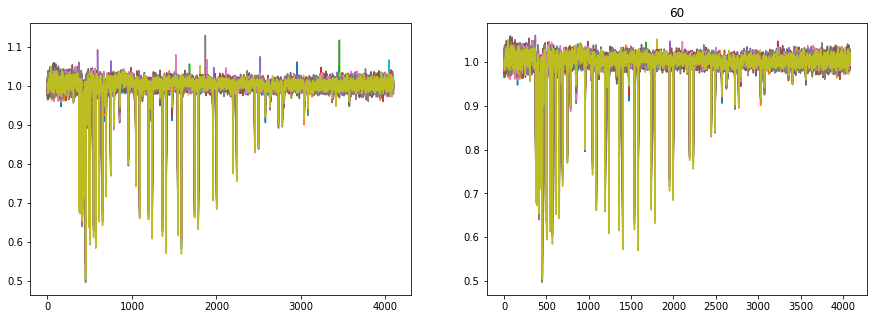

<Figure size 432x288 with 0 Axes>

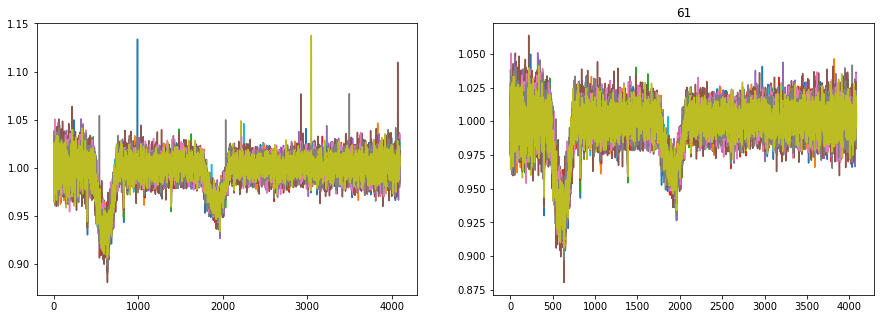

<Figure size 432x288 with 0 Axes>

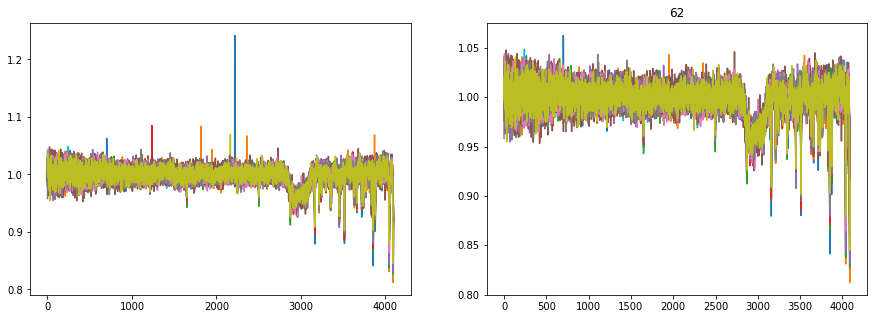

<Figure size 432x288 with 0 Axes>

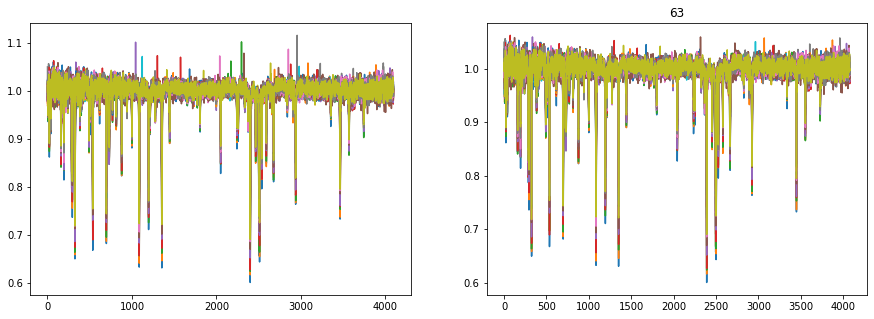

<Figure size 432x288 with 0 Axes>

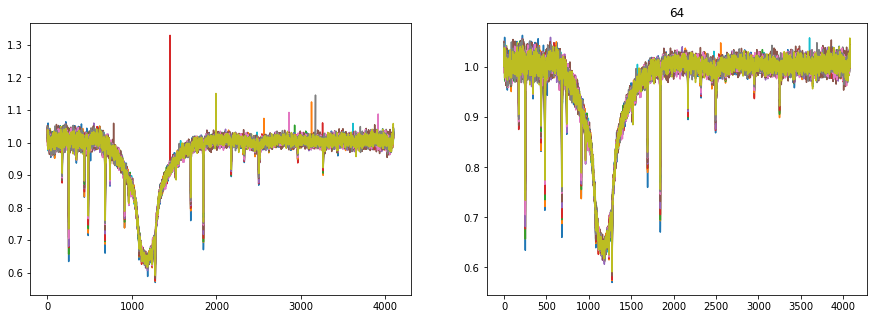

<Figure size 432x288 with 0 Axes>

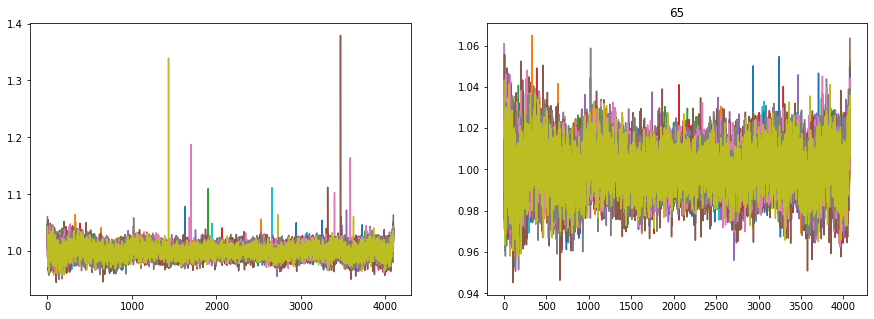

<Figure size 432x288 with 0 Axes>

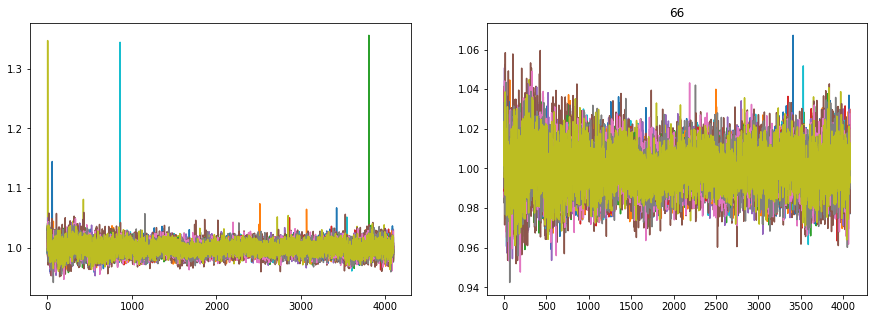

<Figure size 432x288 with 0 Axes>

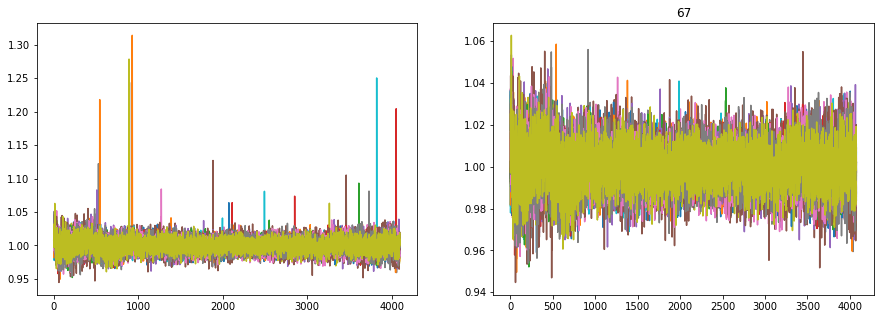

<Figure size 432x288 with 0 Axes>

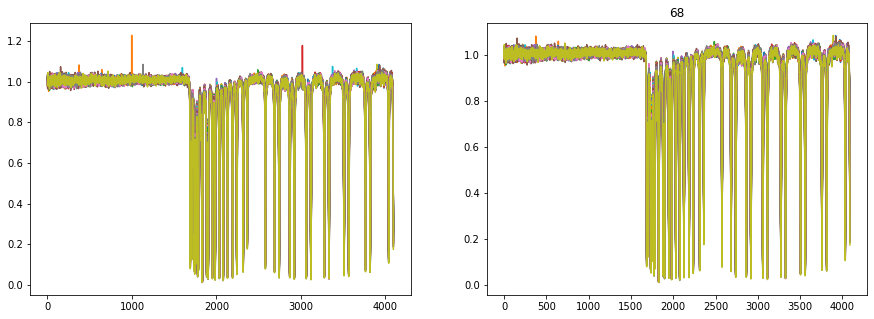

<Figure size 432x288 with 0 Axes>

In [25]:
finalflux=[]
finalwv=[]

for order in range(len(blazeflux)):
    plt.figure(figsize=(15,5))
    plt.subplot(121)
    for filenum in range(len(blazeflux[order])):
        plt.plot(blazeflux[order][filenum])

    finmask=blazeflux[order]>-4
    for wvbin in range(len(blazeflux[order][0])):
        fl=blazeflux[order][:,wvbin]
        c, low, upp =sigmaclip(fl, low=5,high=5)
        maskbad=np.abs(fl-np.mean(c))<+5*np.std(c)
        finmask[:,wvbin][~maskbad]= 1<0
    masknumerical=finmask[-1]
    for filenum in range(len(finmask)-1):
        masknumerical*=finmask[filenum]

    finflux=np.zeros((len(blazeflux[order]),len(blazeflux[order][0][masknumerical])))
    finwv=np.zeros((len(blazeflux[order]),len(blazeflux[order][0][masknumerical])))

    
    plt.subplot(122)
    for filenum in range(len(blazeflux[order])):
        finflux[filenum]=blazeflux[order][filenum][masknumerical]
        finwv[filenum]=blazewv[order][filenum][masknumerical]

        plt.plot(finflux[filenum])
    plt.title(order)
    plt.show()
    plt.clf()
    finalflux.append(finflux)
    finalwv.append(finwv)

## Checking the wavelength stability

Telluric model can be obtained by using SkyModelCalculator (https://www.eso.org/observing/etc/bin/gen/form?INS.MODE=swspectr+INS.NAME=SKYCALC) 

In [26]:
xte,ytel=np.loadtxt(str(dir_model)+'telluric-lines-visual.dat',unpack=True) #telluric model
xtel=vac2air(np.array(xte)*10.) #the model is in vacuum wavelenggth while harpsn wavelength is in the air
ytel=np.array(ytel)

stepsize= 0.01
wv_temp=np.arange(xtel[0],xtel[-1],stepsize)
tck=interpolate.splrep(xtel,ytel)
flx=interpolate.splev(wv_temp,tck,der=0)
flx_temp = pyasl.instrBroadGaussFast(wv_temp, flx,115000,edgeHandling="firstlast")


In [30]:
def cc_dop(w, f, tw, tf, rvmin, rvmax, drv):
    drvs = np.arange(rvmin, rvmax, drv)
    cc = []
    for rv in drvs:
        fi = sci.interp1d(tw*(1+ rv*1000./const.c.value), tf)
        up=np.sum((f-np.mean(f))*(fi(w)-np.mean(fi(w))))
        bottom=np.sum((f-np.mean(f))**2) * np.sum((fi(w)-np.mean(fi(w)))**2)
        cc.append(up/bottom**0.5)
    return drvs, cc

In [28]:
tel_order=np.array([53,54,60,63,68])

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:5: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`
  """


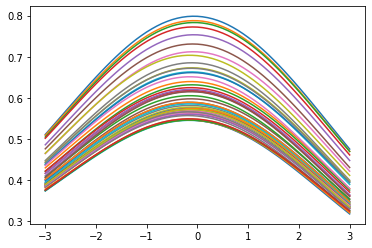

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:5: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`
  """


<Figure size 432x288 with 0 Axes>

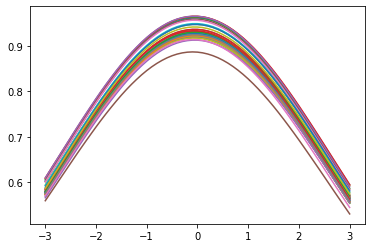

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:5: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`
  """


<Figure size 432x288 with 0 Axes>

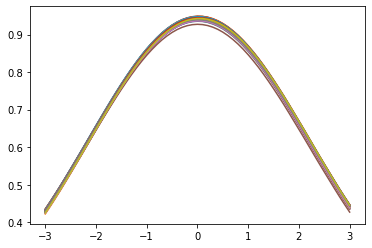

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:5: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`
  """


<Figure size 432x288 with 0 Axes>

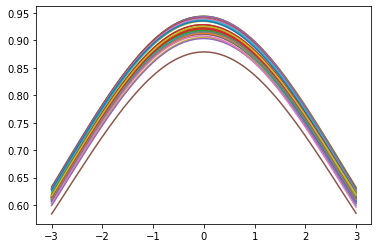

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:5: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`
  """


<Figure size 432x288 with 0 Axes>

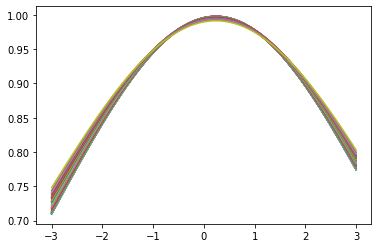

<Figure size 432x288 with 0 Axes>

In [31]:
ccfile=[]
for order in tel_order:
    plt.figure()
    ccorder=[]
    for filenum in tnrange(len(finalflux[0])):
        masktemp=(wv_temp>finalwv[order][filenum][0]-5)*(wv_temp<finalwv[order][filenum][-1]+5)
    
        xtemp,ytemp=wv_temp[masktemp],flx_temp[masktemp]
        
        drvst,cc=cc_dop(finalwv[order][filenum],finalflux[order][filenum],xtemp,ytemp,-3,3+0.1,0.1)
        ccorder.append(cc)
        plt.plot(drvst,cc)

    ccfile.append(ccorder)
    plt.show()
    plt.clf()

In [32]:
shifts=[]
w_cc=[]
for order in range(len(ccfile[0])):
    shifts_order=[]
    w_ccorder=[]
    for filenum in range(len(ccfile)):
        shiftpix=np.arange(-3,3+0.1,0.1) #pixel
        shiftpixsmooth=np.arange(-1,1+0.01,0.001) #pixel
        smoothcc=sci.interp1d(shiftpix,ccfile[filenum][order],kind='cubic')(shiftpixsmooth)
        shifts_order.append(shiftpixsmooth[np.argmax(smoothcc)])
        w_ccorder.append(smoothcc[np.argmax(smoothcc)])
    w_cc.append(w_ccorder)
    shifts.append(shifts_order)

array([-0.14379592, -0.05820408,  0.02238776, -0.01673469,  0.24032653])

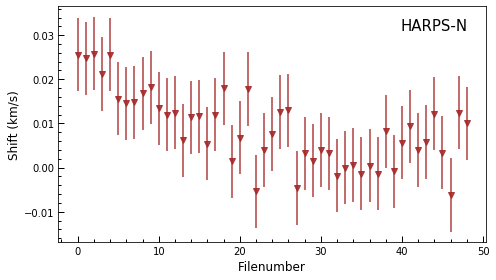

<Figure size 432x288 with 0 Axes>

In [41]:
relorder=[]
for order in range(len(shifts)):
    relorder.append(shifts[order][:])

plt.figure(figsize=(7,4))
ax1=plt.subplot(111)
ax1.errorbar(np.arange(len(finalflux[0])),np.mean(relorder,axis=1),np.std(np.mean(relorder,axis=1)),fmt='v', color='brown',xuplims=True, xlolims=True,alpha=0.9)
ax1.set_xlabel('Filenumber',size=12)
ax1.set_ylabel('Shift (km/s)',size=12)
plt.text(0.8,0.9,'HARPS-N',size=15, transform = ax1.transAxes)
# plt.ylim(-0.12,0.12)
plt.minorticks_on()
plt.tick_params(which="both",direction='in',width=1)
plt.tick_params(which="major",length=6,direction='in')
plt.tick_params(which="minor",length=3,direction='in')
plt.tight_layout()

# plt.savefig("wv-check.png",format="png",dpi=300,bbox_inches="tight",pad_inches=0.1)
# plt.savefig("wv-check.eps",format="eps",dpi=300,bbox_inches="tight",pad_inches=0.1)
plt.show()
plt.clf()

## Transit parameters

In [44]:
#Gaudi et al. 2017
P=1.4811235#days
T0=2457095.68572

tingress=0.01319 #days
ttransit=0.16316 #days

phase=(np.array(bjd)-T0)/P% 1
phase_p=[]

for p in range(len(phase)):
    if phase[p] >0.5:
        phase_p.append(phase[p]-1.)
    else:
        phase_p.append(phase[p])
phase_p=np.array(phase_p)        

Mp= 2.88*const.M_jup.value
inc= 86.79*np.pi/180

Ms= 2.52*const.M_sun.value

kppredict=(2.*np.pi*const.G.value/(P*24*3600))**(1./3)*(Ms*np.sin(inc))/(Mp+Ms)**(2./3)/1000.
print (kppredict)
rvpredict=kppredict*np.sin(2.*np.pi*phase_p)-rvcor



253.5895624832285


## Transit Lightcurve Modelling 

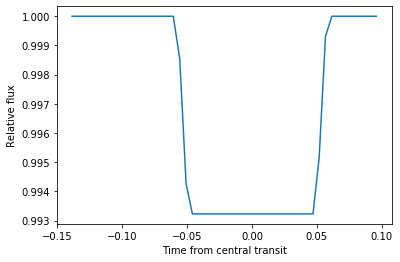

In [46]:
import batman
import numpy as np
import matplotlib.pyplot as plt
params = batman.TransitParams()
params.t0 = T0                       #time of inferior conjunction
params.per = P                      #orbital period
params.rp = 0.08228                 #planet radius (in units of stellar radii)
params.a = 0.03368*const.au.value/ const.R_sun.value/2.418              #semi-major axis (in units of stellar radii)
params.inc =  86.79                  #orbital inclination (in degrees)
params.ecc = 0.                      #eccentricity
params.w = 90.                       #longitude of periastron (in degrees)
params.u = [0.]#[1.082, -0.2315]                #limb darkening coefficients [u1, u2]
params.limb_dark = "linear"       #limb darkening model

t = np.array(bjd)

m = batman.TransitModel(params, t)    #initializes model
t_model = m.light_curve(params)          #calculates light curve
plt.plot(phase_p, t_model)
plt.xlabel("Time from central transit")
plt.ylabel("Relative flux")
plt.show()

scaletrans=np.abs(t_model-1)/np.max(np.abs(t_model-1))
for i in range(len(t_model)):
    if scaletrans[i]>0:
        scaletrans[i]=1
        
#Transit weight
tw=(1.-t_model)
tw=tw/np.sum(tw)     

## Saving the spectra

In [92]:
with h5py.File(str(dir_data)+"kelt9b-raw.h5", 'w') as h5f_raw:
    for order in range(len(finalflux)):
        data=finalflux[order]
        h5f_raw.create_dataset("flux-order-"+str(order),data=data)
        #Estimating the variance per pixels
        var=np.square((np.outer(np.std(data,axis=1),np.std(data,axis=0))/np.std(data)))
        h5f_raw.create_dataset("variance-order-"+str(order),data=var)
        h5f_raw.create_dataset("wv-order-"+str(order),data=finalwv[order][0])
    h5f_raw.create_dataset("exptime",data=exptime)     
    h5f_raw.create_dataset("airmass",data=airmass) 
    h5f_raw.create_dataset("rvcor",data=rvcor) 
    h5f_raw.create_dataset("bjd",data=bjd)
    h5f_raw.create_dataset("phase",data=phase_p)
    h5f_raw.create_dataset("scaletrans",data=scaletrans)
    h5f_raw.create_dataset("tw",data=tw)

# Removing Telluric and Stellar Lines

There are many methods that can be used to remove telluric and stellar lines, in this notebook, I provide two technique: airmass polynomial fitting (e.g. Brogi et al. 2019), and SysRem (Tamuz et al. 2014, see Birkby et al. 2017 for the reference to use it in high-resolution spectroscopy data).

## Airmass polynomial fitting 

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:15: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`
  from ipykernel import kernelapp as app


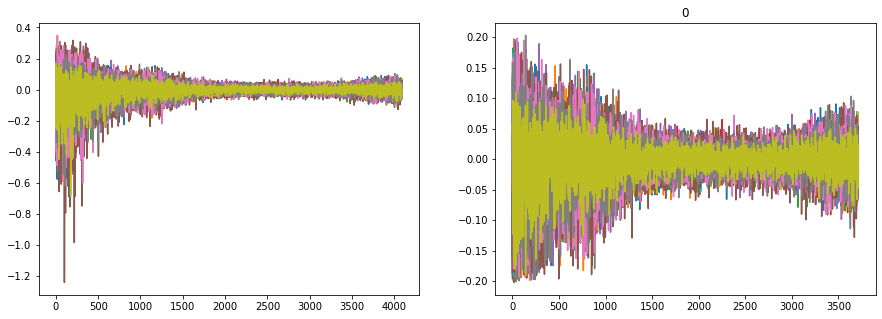

<Figure size 432x288 with 0 Axes>

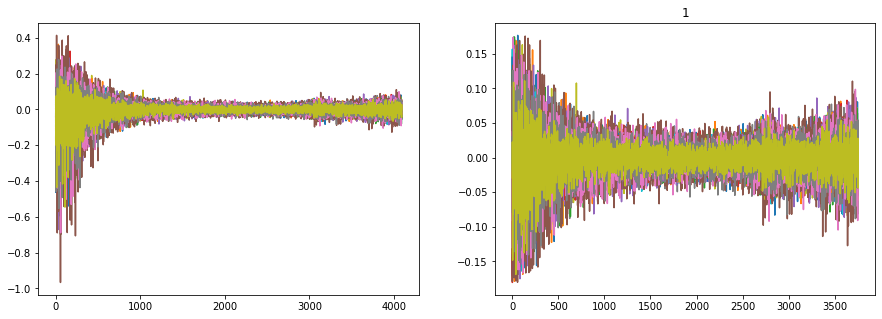

<Figure size 432x288 with 0 Axes>

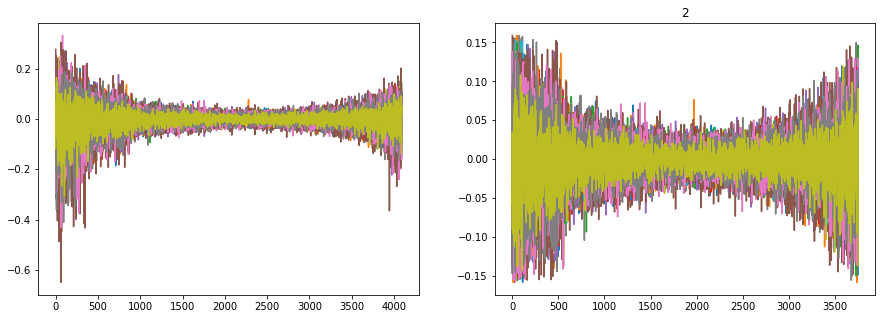

<Figure size 432x288 with 0 Axes>

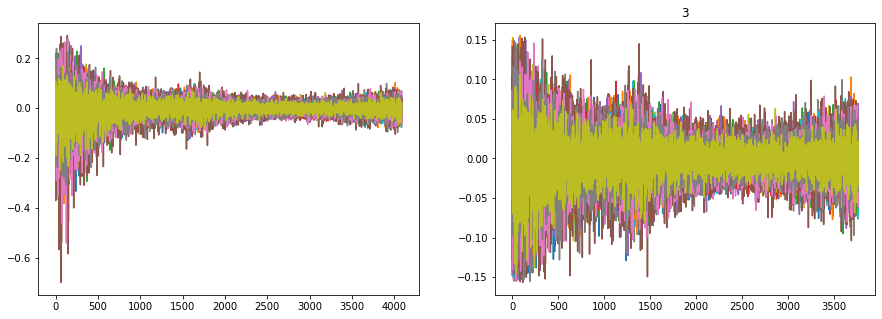

<Figure size 432x288 with 0 Axes>

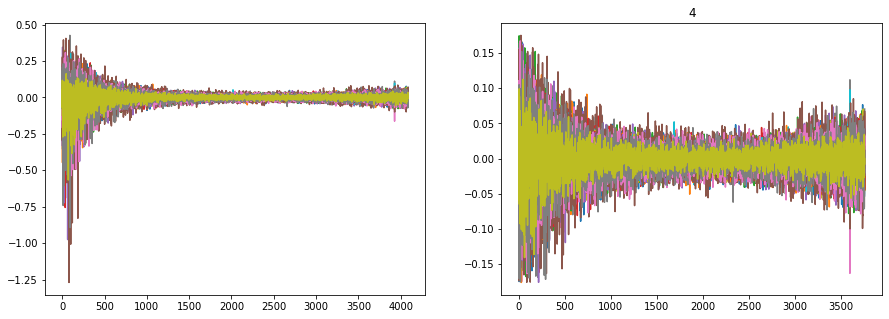

<Figure size 432x288 with 0 Axes>

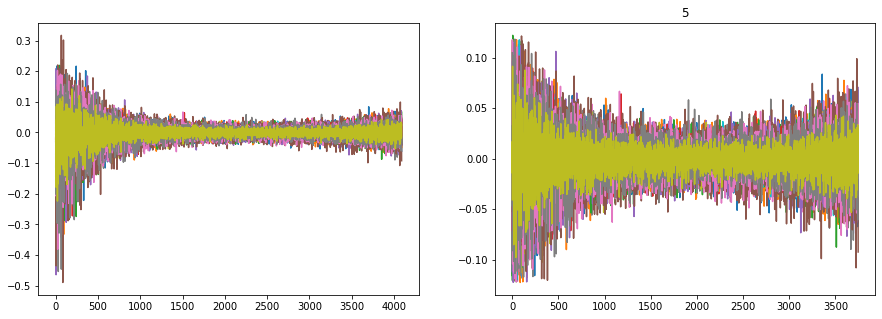

<Figure size 432x288 with 0 Axes>

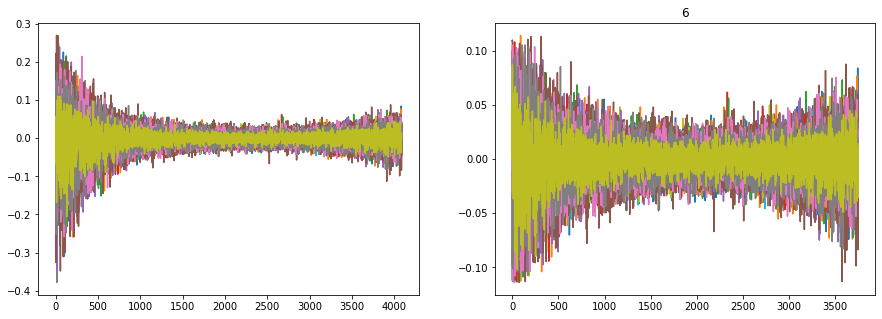

<Figure size 432x288 with 0 Axes>

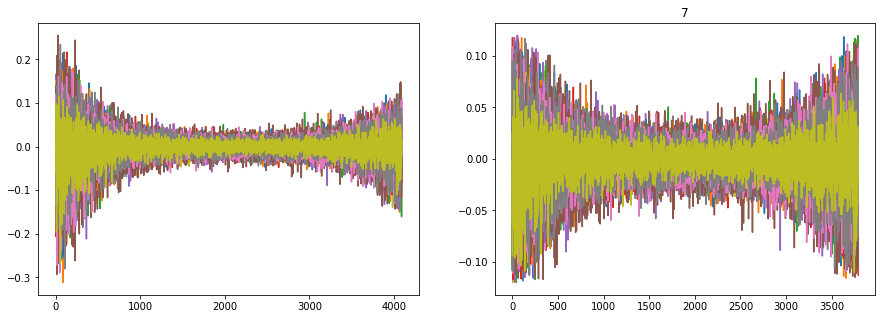

<Figure size 432x288 with 0 Axes>

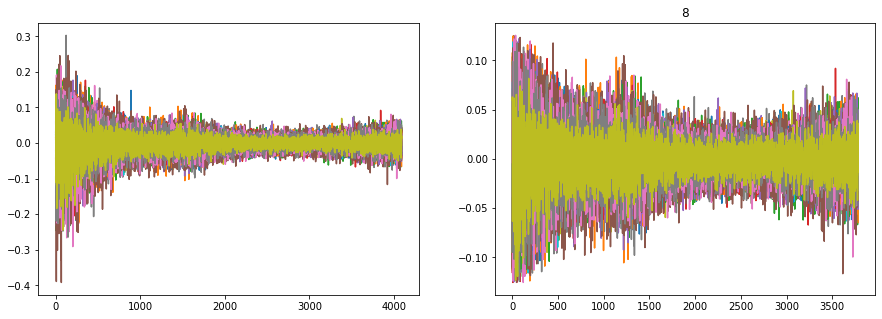

<Figure size 432x288 with 0 Axes>

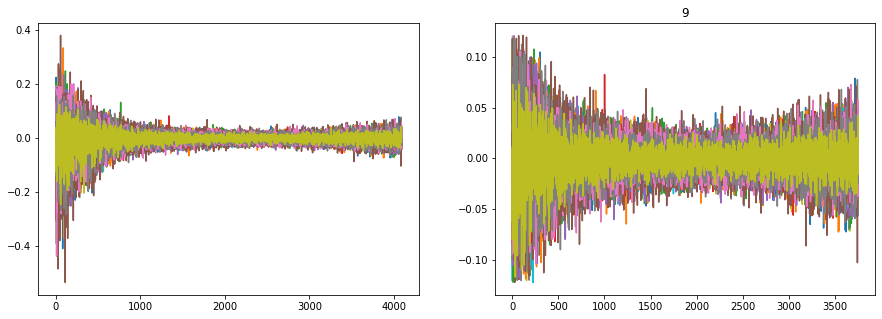

<Figure size 432x288 with 0 Axes>

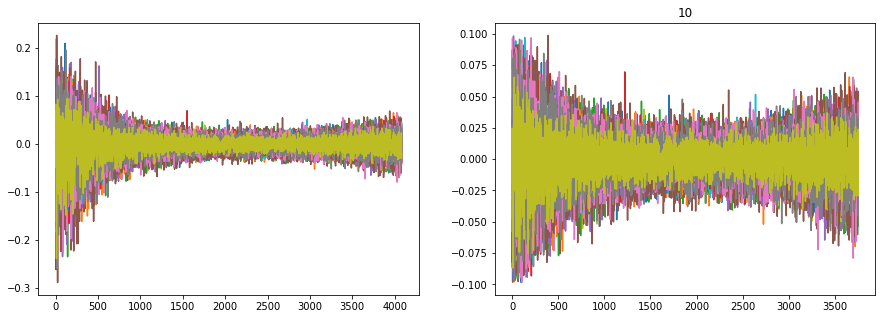

<Figure size 432x288 with 0 Axes>

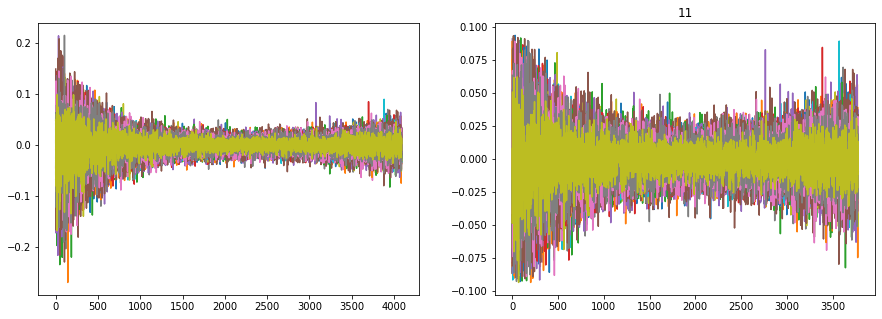

<Figure size 432x288 with 0 Axes>

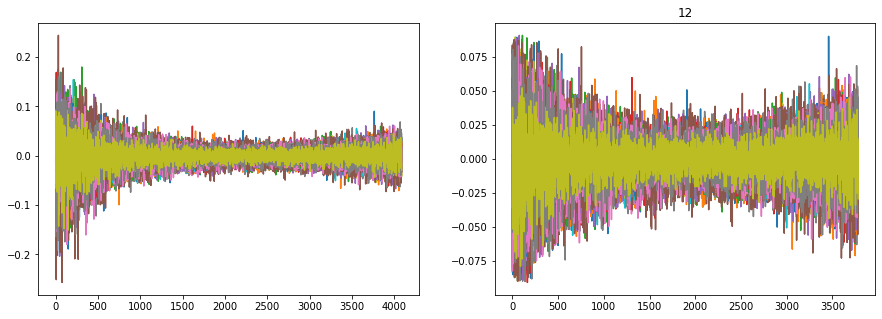

<Figure size 432x288 with 0 Axes>

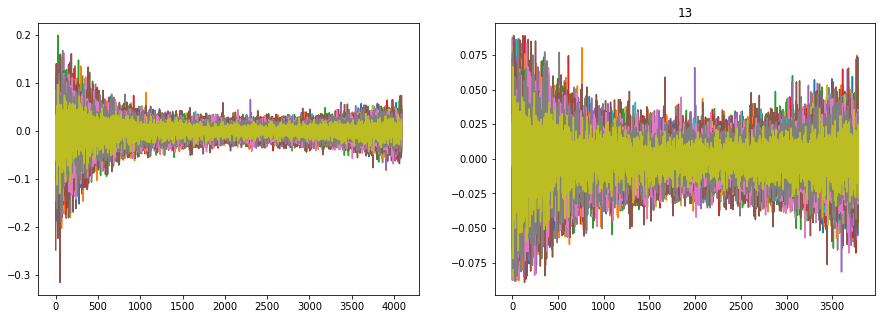

<Figure size 432x288 with 0 Axes>

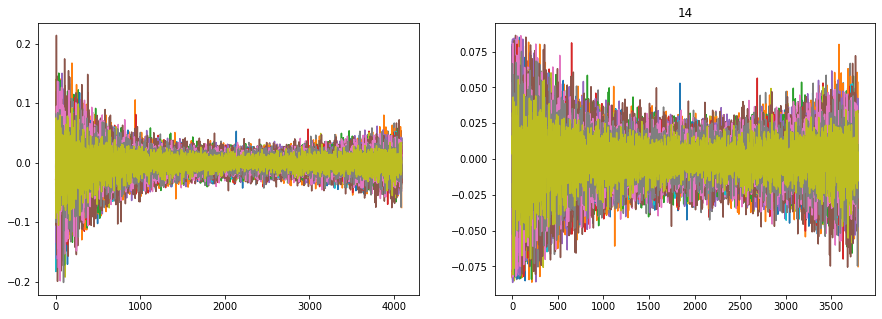

<Figure size 432x288 with 0 Axes>

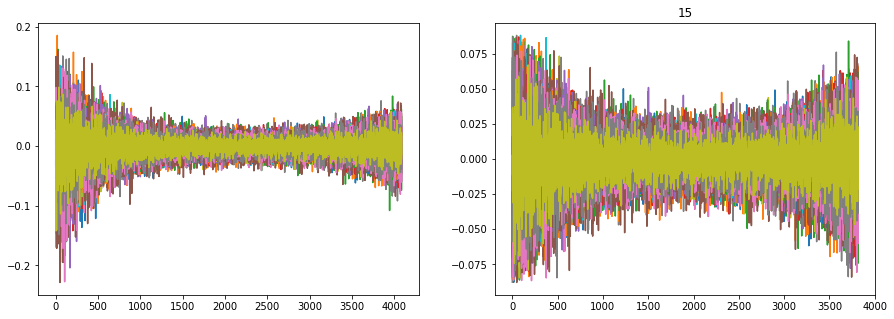

<Figure size 432x288 with 0 Axes>

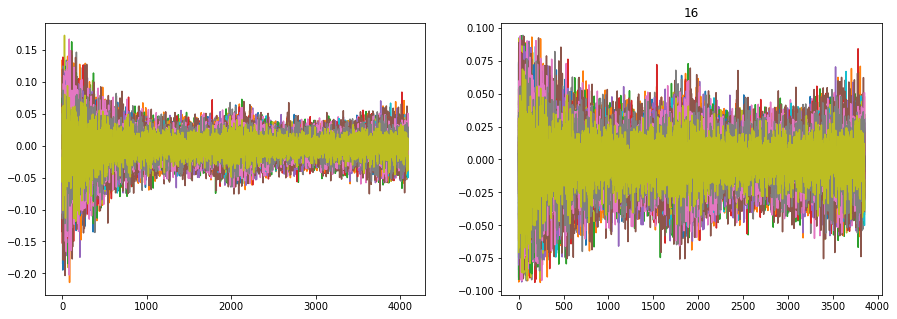

<Figure size 432x288 with 0 Axes>

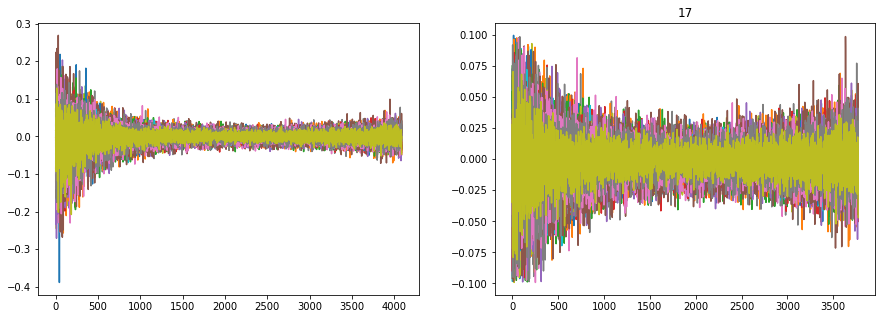

<Figure size 432x288 with 0 Axes>

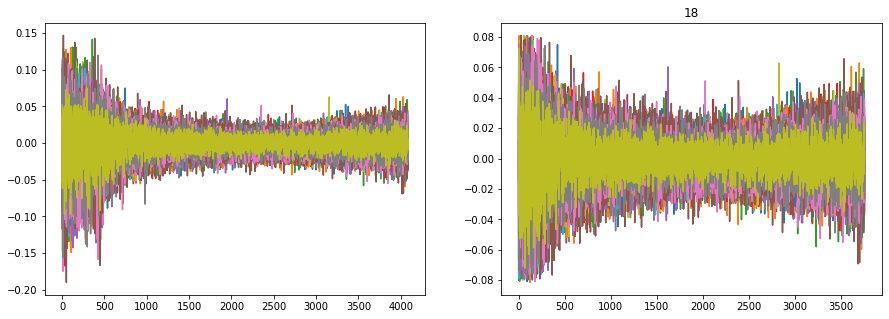

<Figure size 432x288 with 0 Axes>

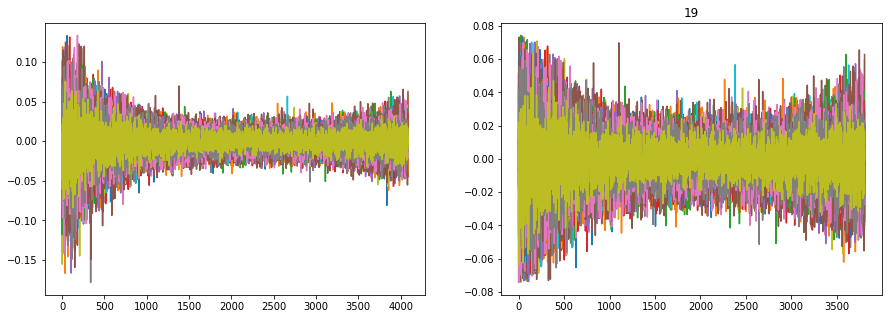

<Figure size 432x288 with 0 Axes>

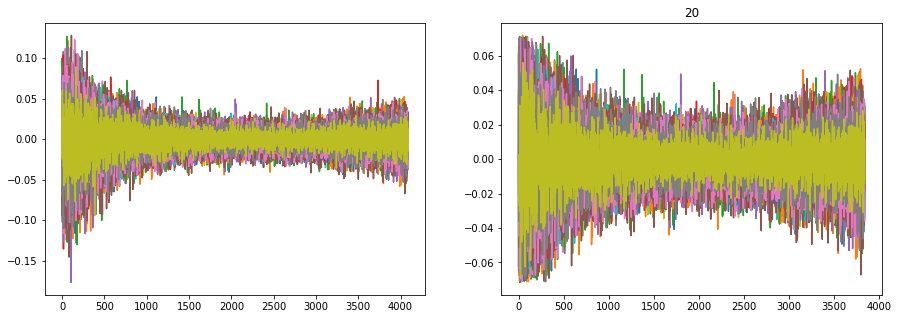

<Figure size 432x288 with 0 Axes>

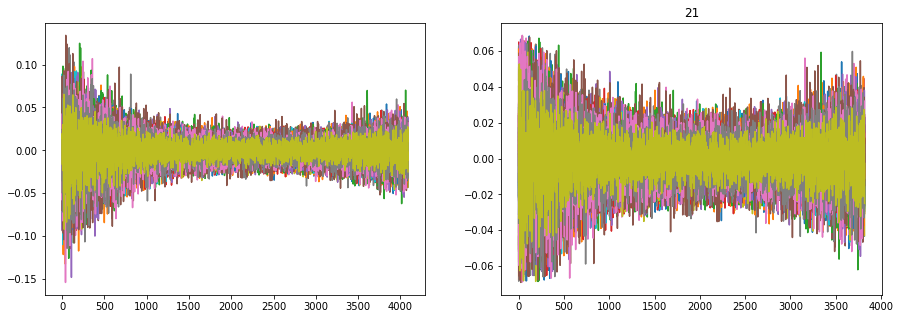

<Figure size 432x288 with 0 Axes>

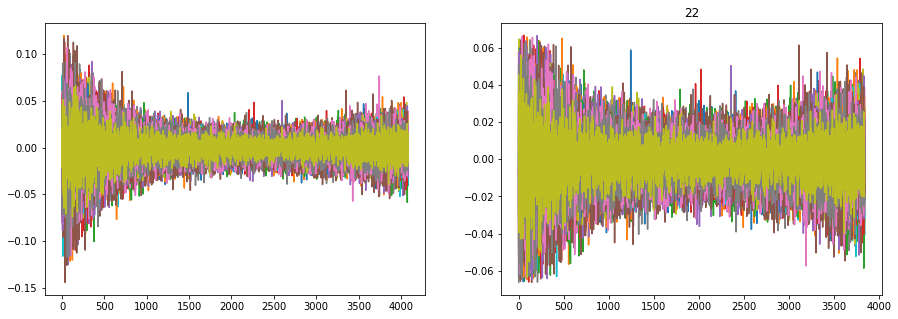

<Figure size 432x288 with 0 Axes>

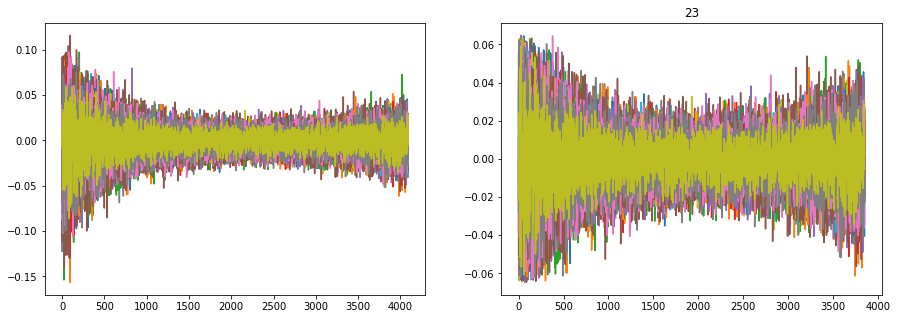

<Figure size 432x288 with 0 Axes>

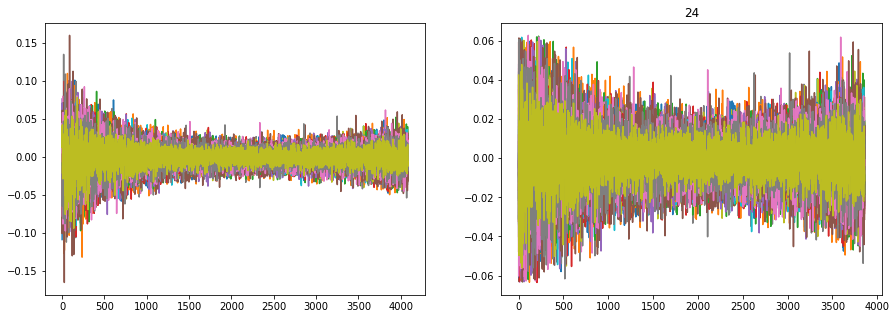

<Figure size 432x288 with 0 Axes>

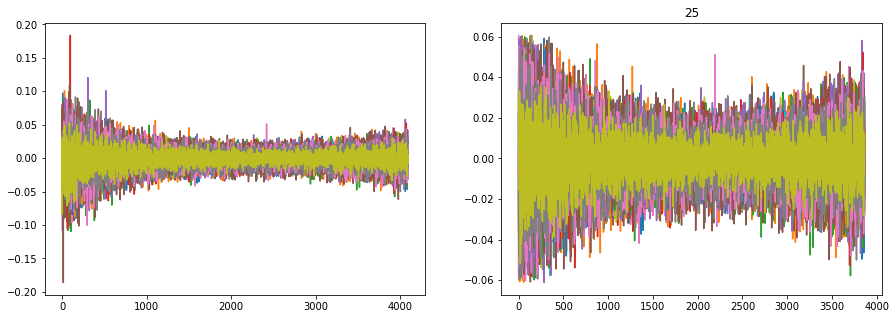

<Figure size 432x288 with 0 Axes>

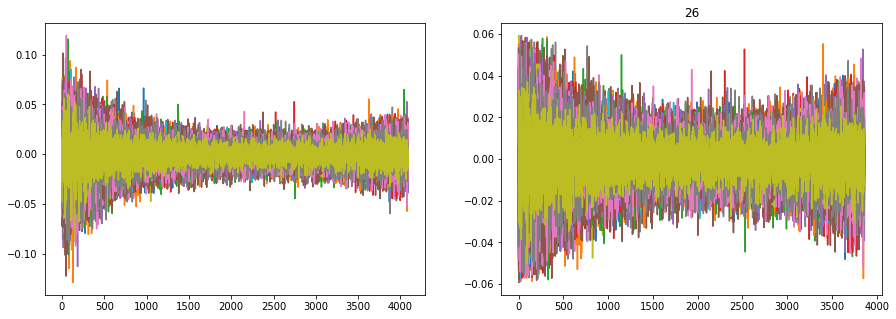

<Figure size 432x288 with 0 Axes>

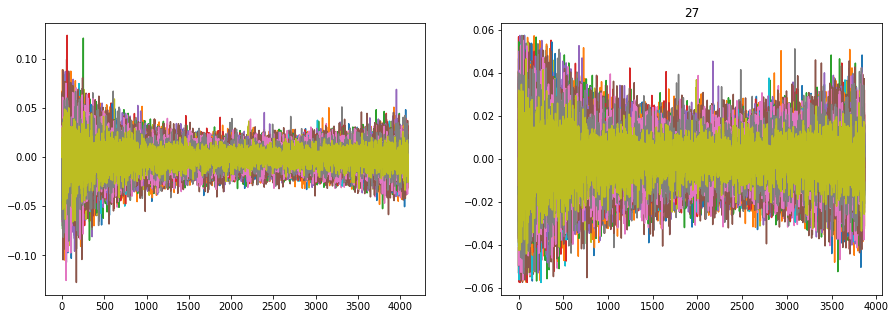

<Figure size 432x288 with 0 Axes>

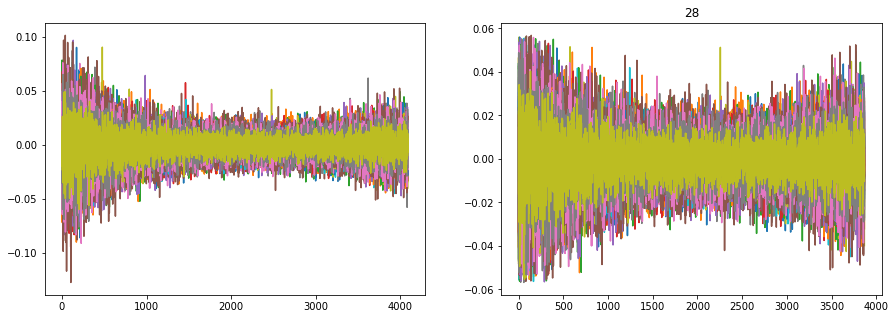

<Figure size 432x288 with 0 Axes>

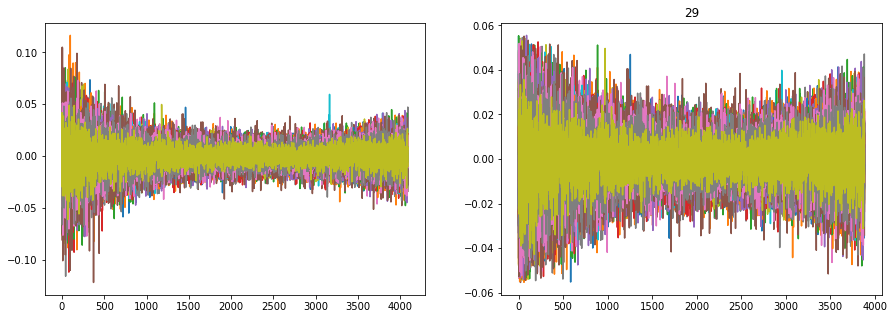

<Figure size 432x288 with 0 Axes>

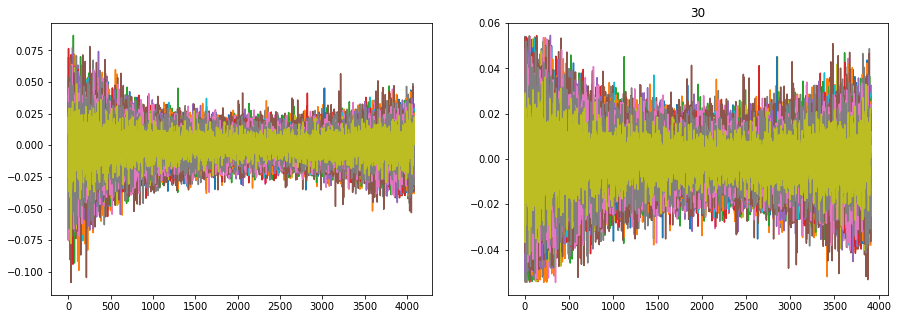

<Figure size 432x288 with 0 Axes>

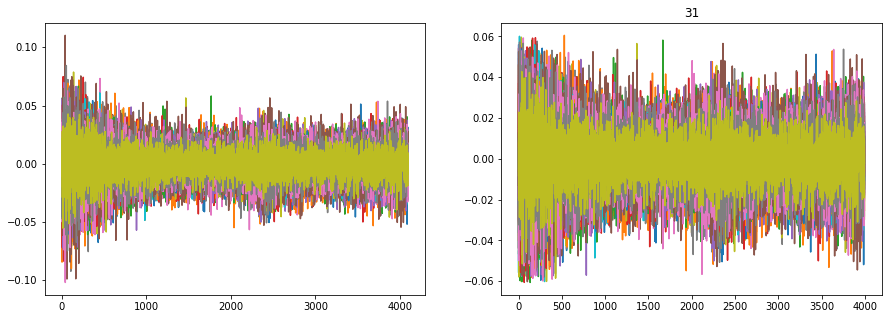

<Figure size 432x288 with 0 Axes>

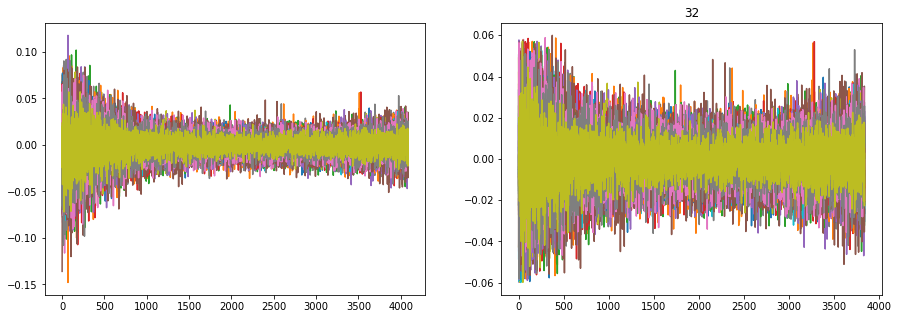

<Figure size 432x288 with 0 Axes>

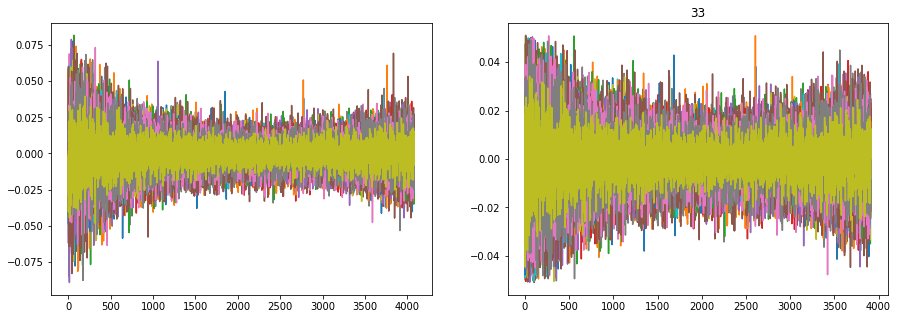

<Figure size 432x288 with 0 Axes>

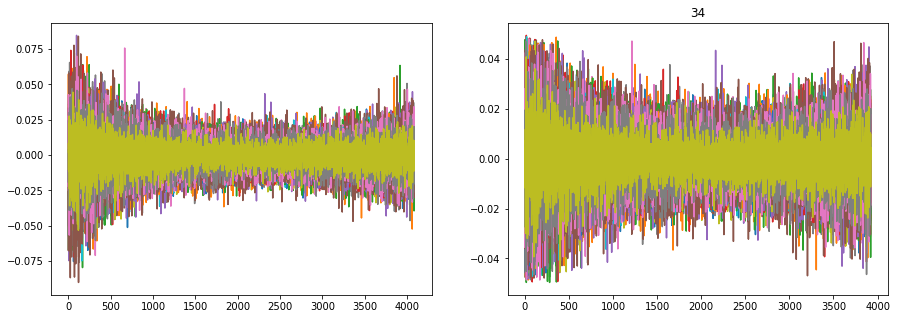

<Figure size 432x288 with 0 Axes>

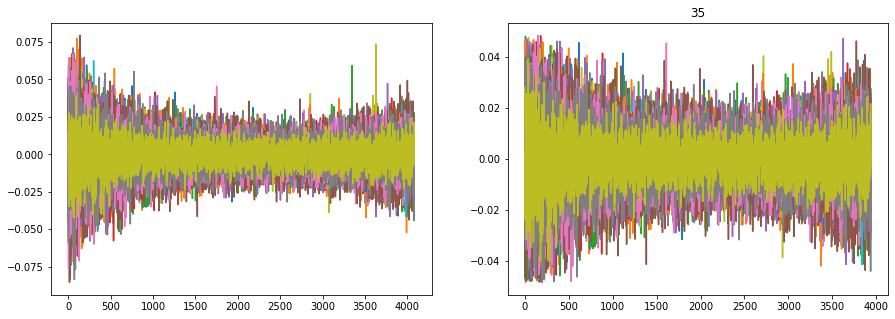

<Figure size 432x288 with 0 Axes>

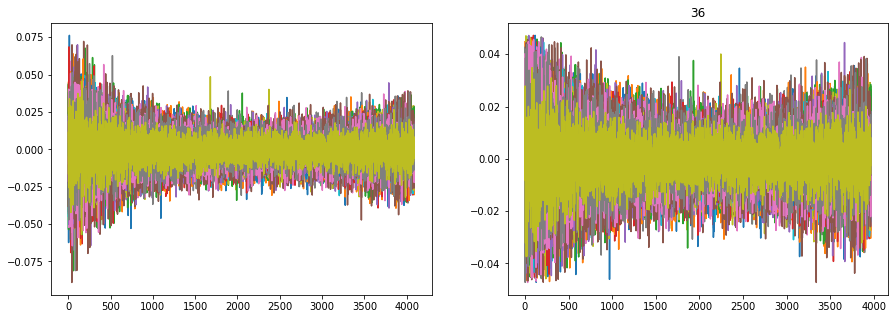

<Figure size 432x288 with 0 Axes>

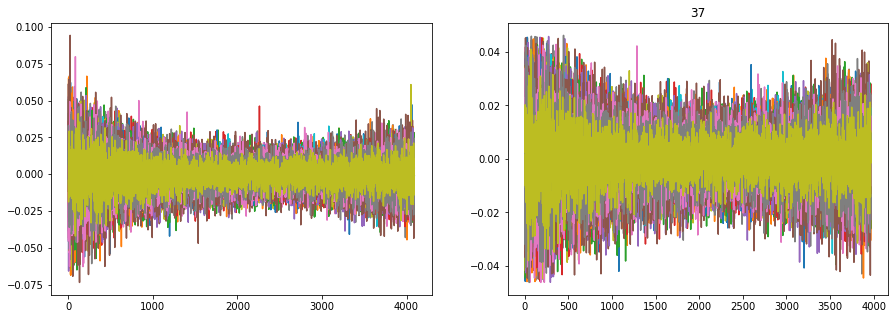

<Figure size 432x288 with 0 Axes>

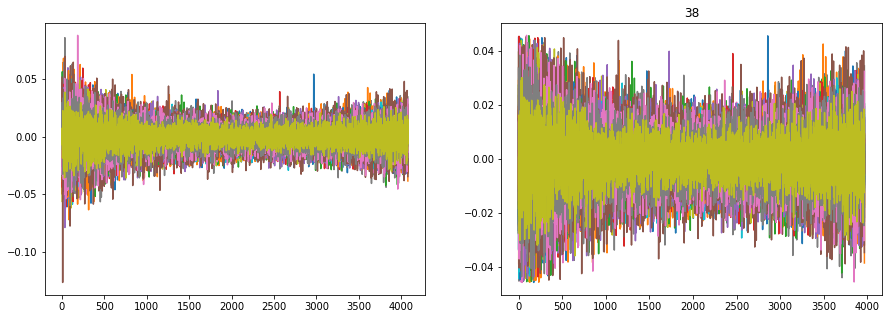

<Figure size 432x288 with 0 Axes>

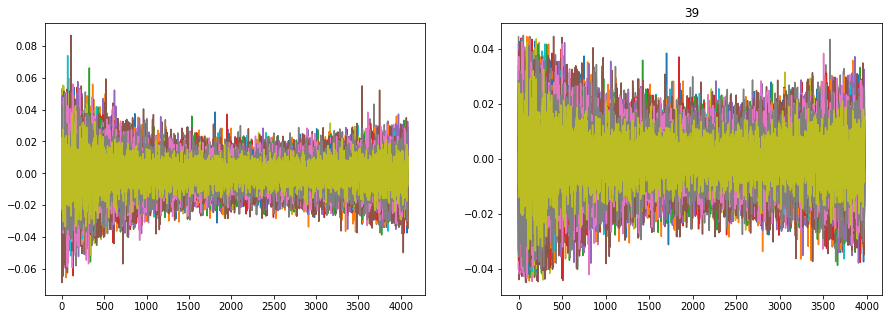

<Figure size 432x288 with 0 Axes>

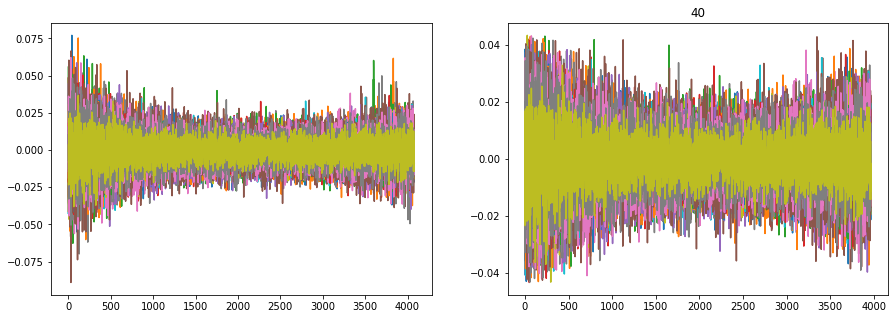

<Figure size 432x288 with 0 Axes>

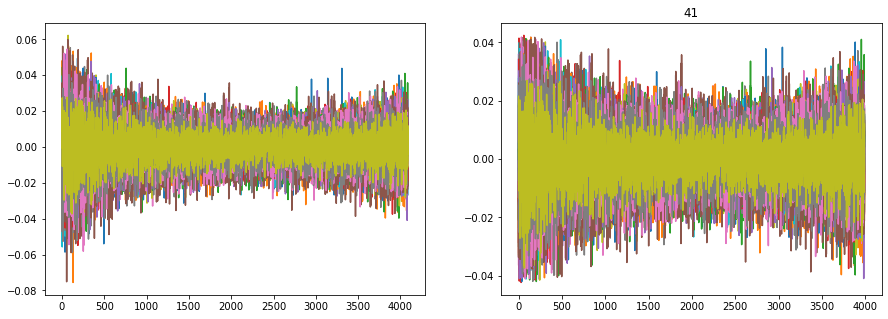

<Figure size 432x288 with 0 Axes>

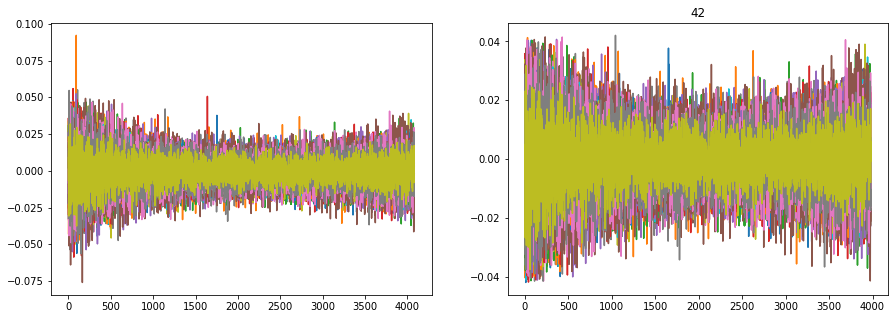

<Figure size 432x288 with 0 Axes>

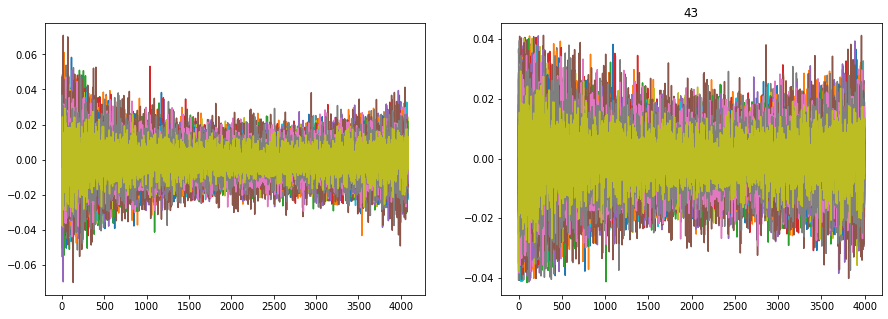

<Figure size 432x288 with 0 Axes>

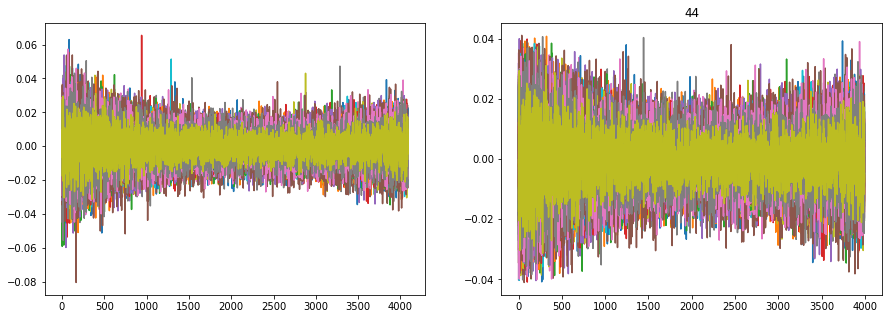

<Figure size 432x288 with 0 Axes>

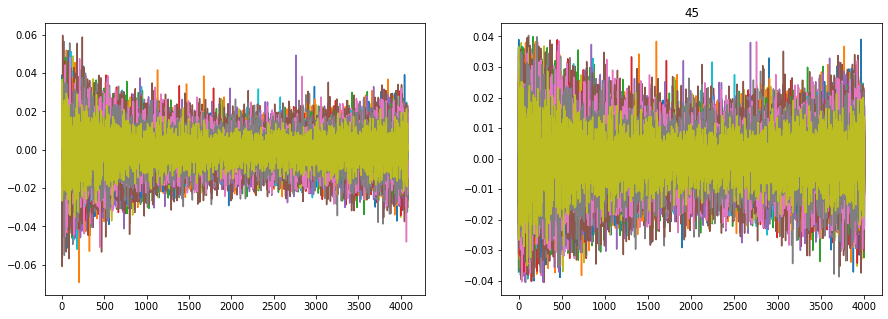

<Figure size 432x288 with 0 Axes>

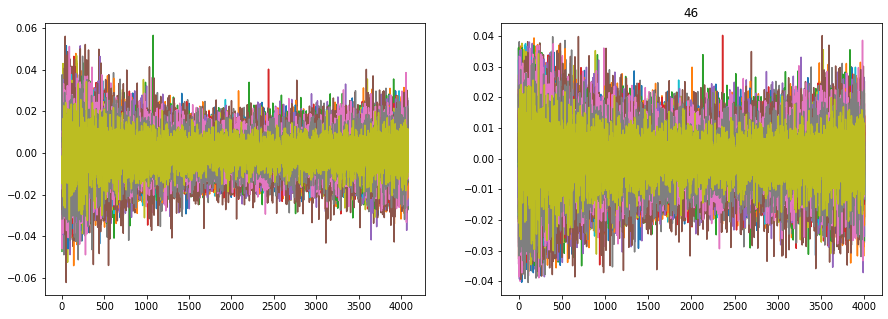

<Figure size 432x288 with 0 Axes>

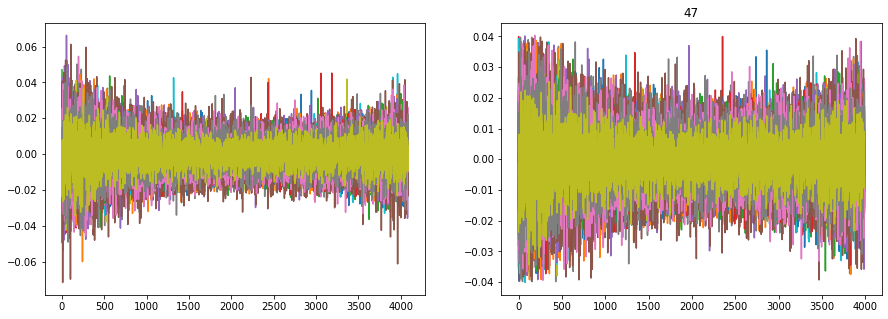

<Figure size 432x288 with 0 Axes>

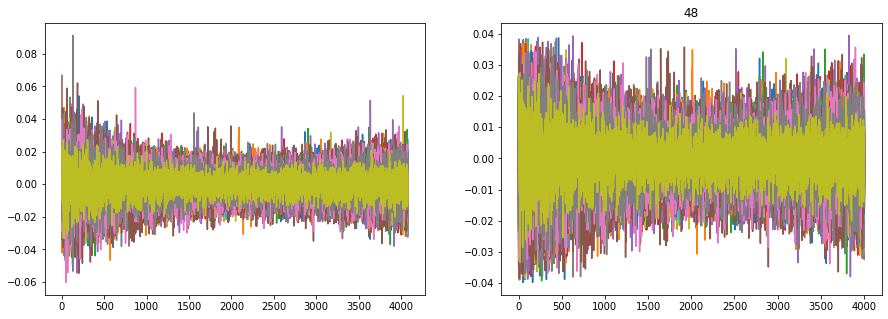

<Figure size 432x288 with 0 Axes>

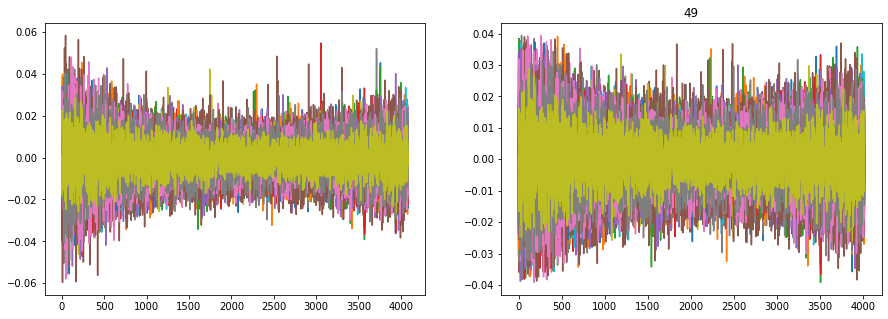

<Figure size 432x288 with 0 Axes>

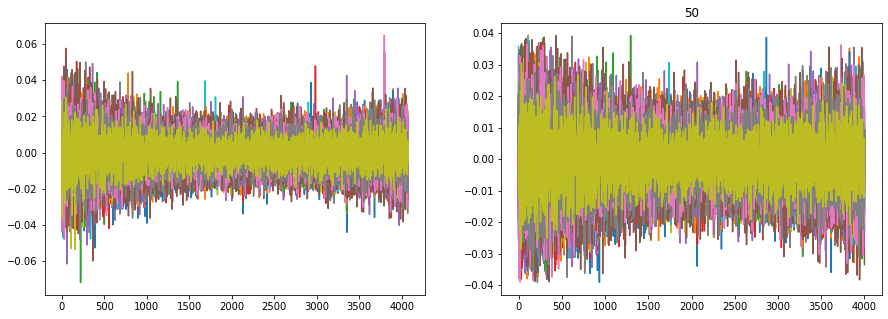

<Figure size 432x288 with 0 Axes>

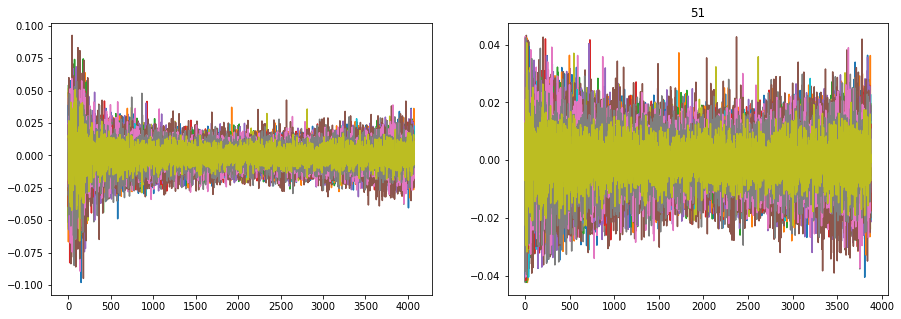

<Figure size 432x288 with 0 Axes>

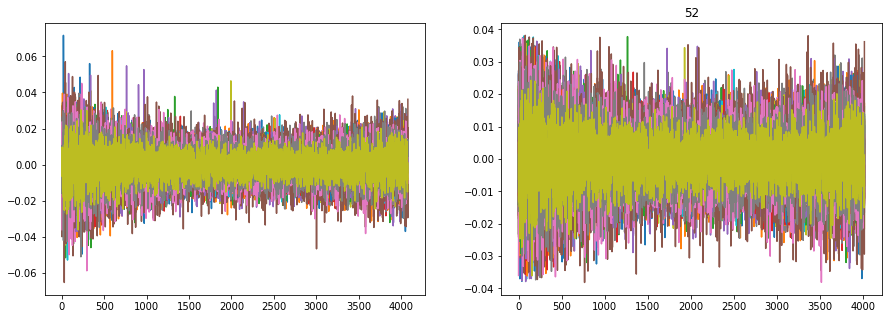

<Figure size 432x288 with 0 Axes>

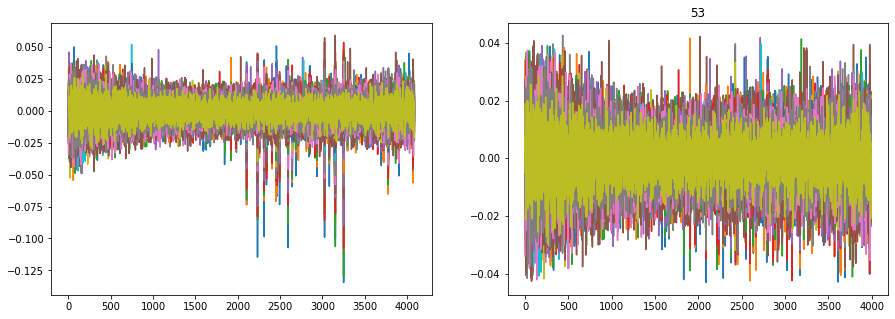

<Figure size 432x288 with 0 Axes>

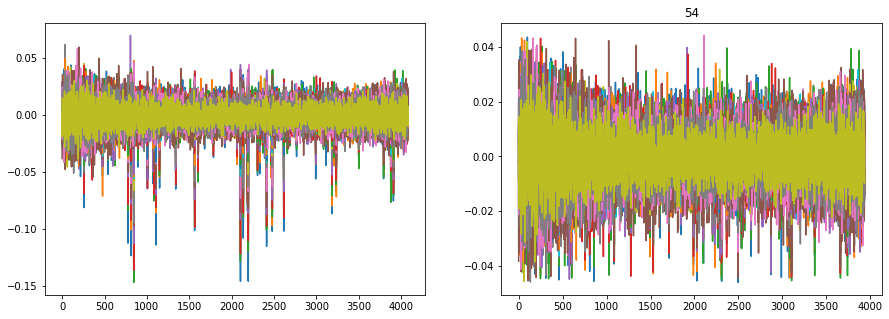

<Figure size 432x288 with 0 Axes>

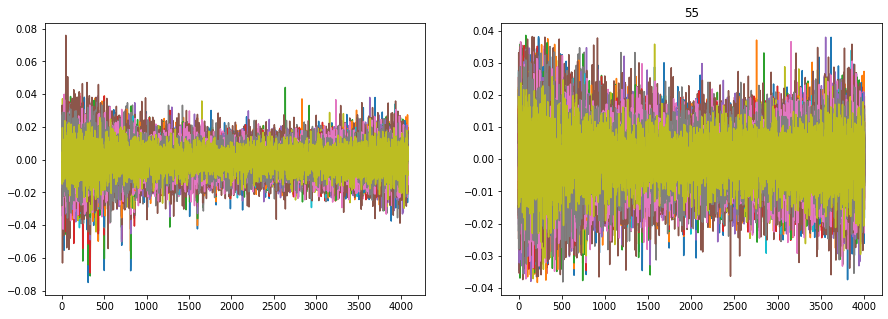

<Figure size 432x288 with 0 Axes>

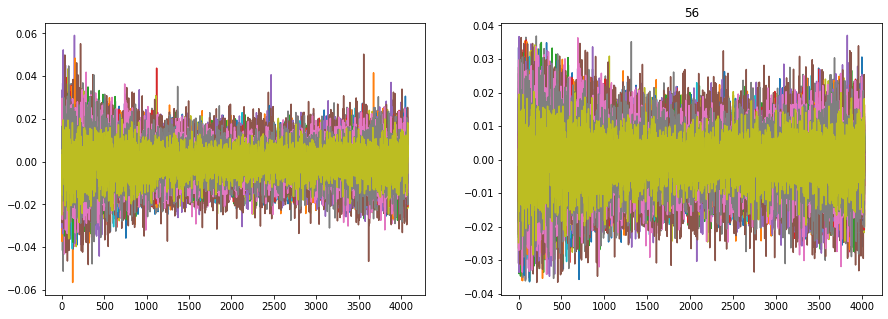

<Figure size 432x288 with 0 Axes>

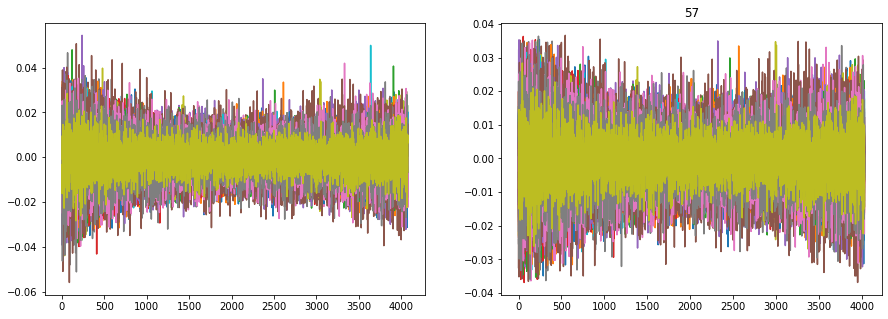

<Figure size 432x288 with 0 Axes>

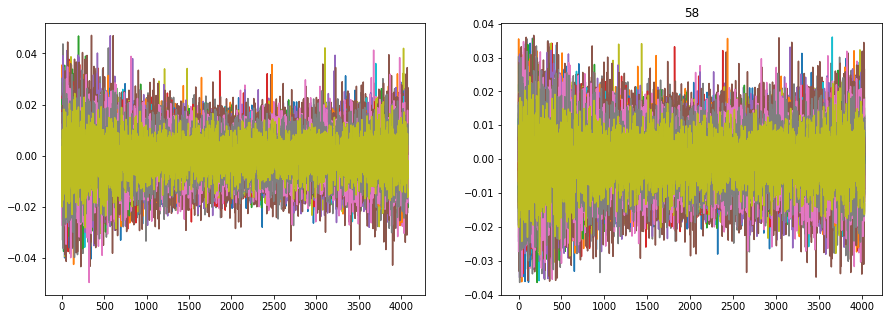

<Figure size 432x288 with 0 Axes>

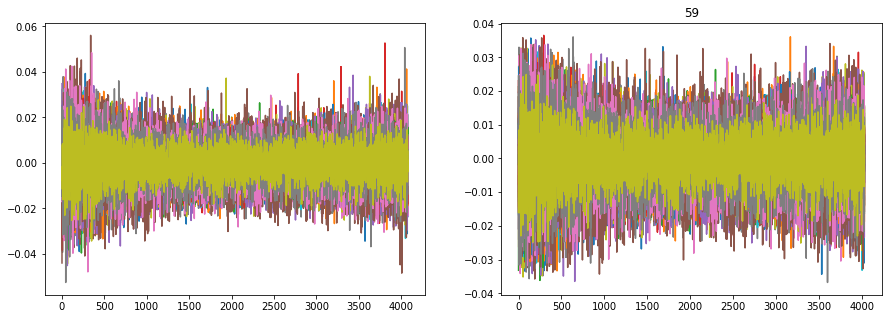

<Figure size 432x288 with 0 Axes>

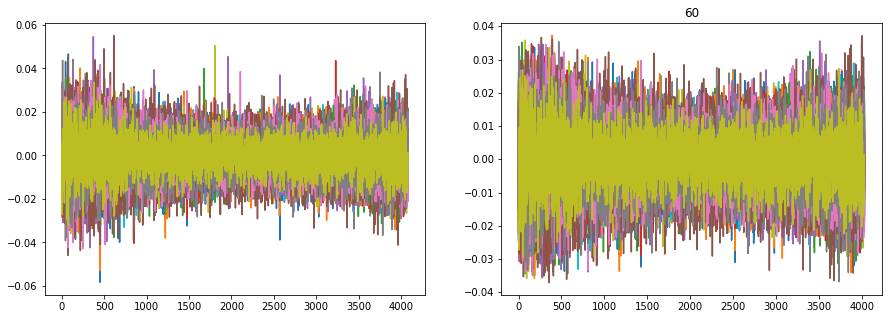

<Figure size 432x288 with 0 Axes>

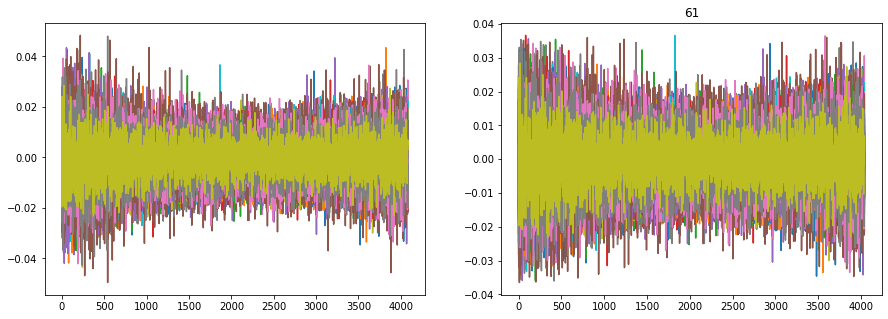

<Figure size 432x288 with 0 Axes>

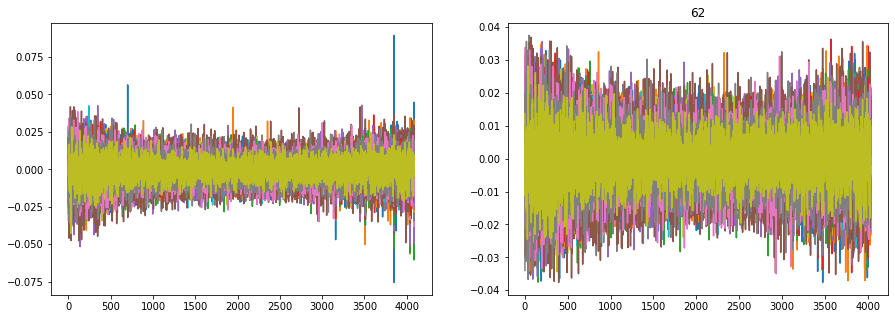

<Figure size 432x288 with 0 Axes>

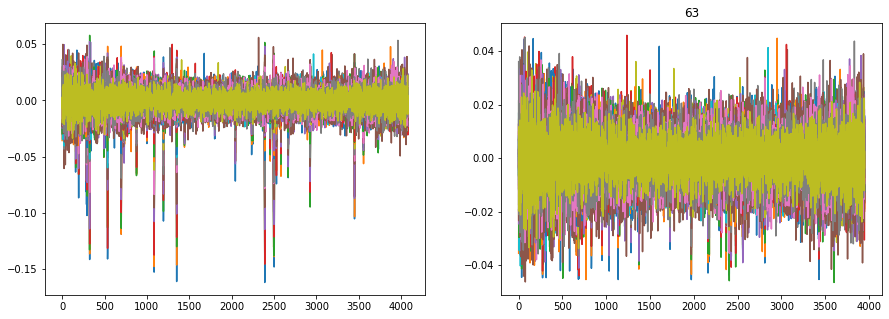

<Figure size 432x288 with 0 Axes>

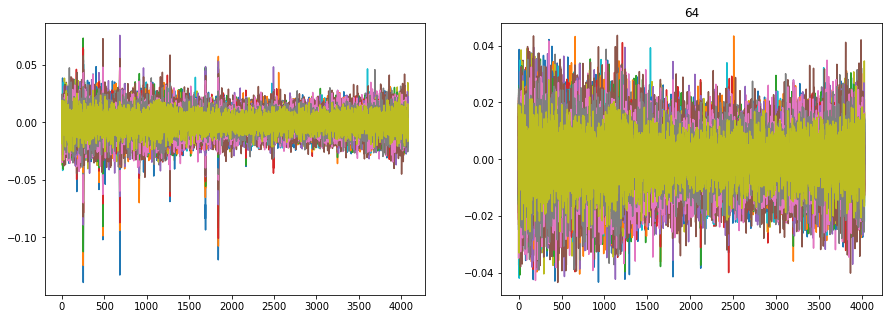

<Figure size 432x288 with 0 Axes>

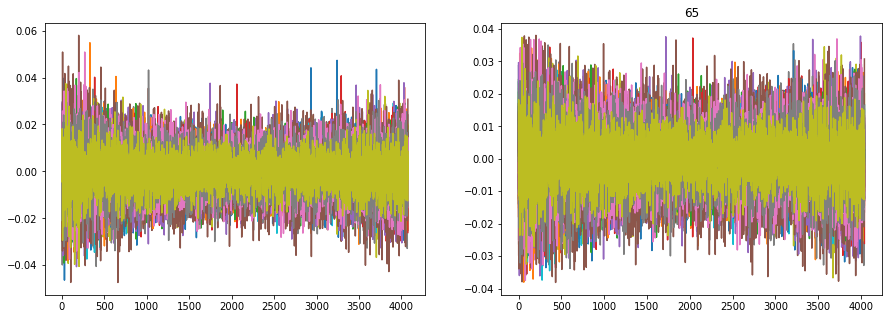

<Figure size 432x288 with 0 Axes>

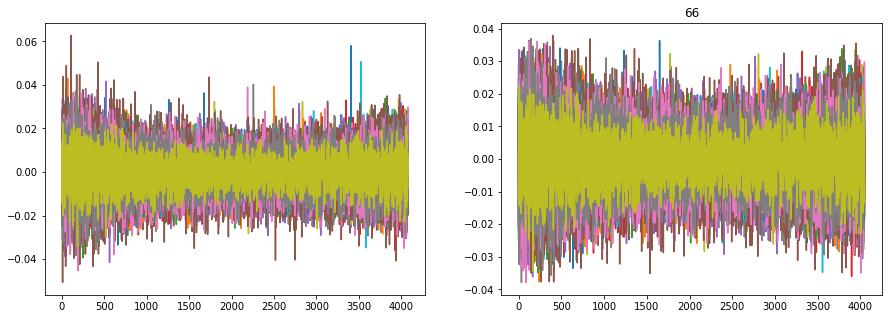

<Figure size 432x288 with 0 Axes>

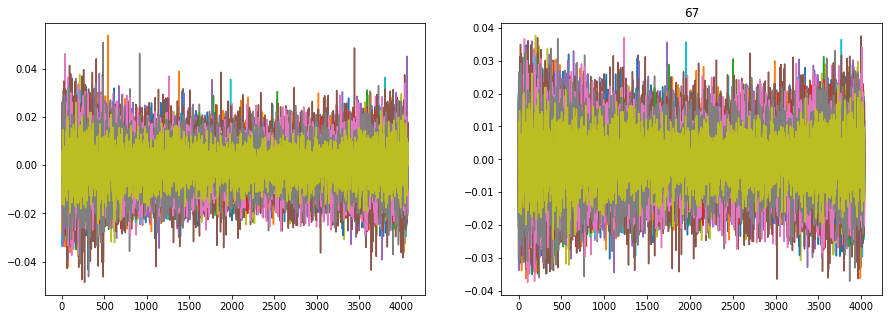

<Figure size 432x288 with 0 Axes>

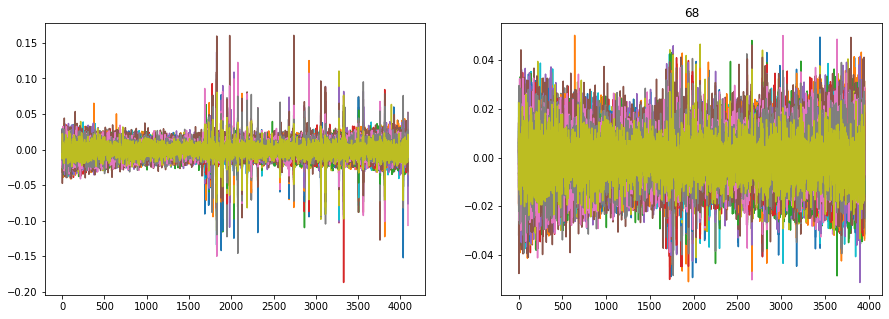

<Figure size 432x288 with 0 Axes>

In [50]:
def polair(x,c0,c1,c2):
    val=c0+c1*airmass+c2*np.square(airmass)
    return val

input_file= "kelt9b-raw.h5"
h5f_raw = h5py.File(str(dir_data)+str(input_file), 'r')


output_file= input_file[:-3]+".airpol"
h5f_clean = h5py.File(str(dir_result)+str(output_file), 'w')


airmass=h5f_raw["airmass"][:]

for order in tnrange (69,ascii="True",desc= " Order:"):
    
    flux = h5f_raw["flux-order-"+str(order)][:]
    Se= h5f_raw["variance-order-"+str(order)][:]
    wv=h5f_raw["wv-order-"+str(order)][:]
    
    data=np.log(flux)-np.mean(np.log(flux),axis=0).transpose()
    error= np.sqrt(Se/np.square(flux))

    model=np.zeros(np.shape(data))
    for wvbin in range(len(data[0])):
        popt, pcov = curve_fit(polair, airmass,data[:,wvbin],sigma=error[:,wvbin])
        polfit=polair(airmass, *popt)
        model[:,wvbin]=polfit
    clean=data-model
    
    
    plt.figure(figsize=(15,5))
    plt.subplot(121)
    for filenum in range(len(clean)):
        plt.plot(clean[filenum])

    finmask=np.abs(clean)>-4
    sigma_value=np.std(clean.ravel())
    
    for wvbin in range(len(clean[0])):
        fl=clean[:,wvbin]
        maskbad=np.abs(fl)<5*sigma_value
        finmask[:,wvbin][~maskbad]= 1<0

    masknumerical=finmask[-1]
    
    for filenum in range(len(finmask)-1):
        masknumerical*=finmask[filenum]

    finflux=np.zeros((len(clean),len(clean[0][masknumerical])))
    finsig=np.zeros((len(clean),len(clean[0][masknumerical])))
    
    plt.subplot(122)
    for filenum in range(len(finflux)):
        finflux[filenum]=clean[filenum][masknumerical]
        finsig[filenum]=Se[filenum][masknumerical]

        plt.plot(finflux[filenum])
    plt.title(order)
    plt.show()
    plt.clf()
    
    final_clean=np.exp(finflux)
    final_clean=final_clean-np.mean(final_clean,axis=0).transpose()
    h5f_clean.create_dataset("flux-order-"+str(order), data=final_clean)
    h5f_clean.create_dataset("variance-order-"+str(order), data=finsig)
    h5f_clean.create_dataset("wv-order-"+str(order), data=wv[masknumerical])

    
h5f_clean.close()
h5f_raw.close()


## SysRem

SysRem is systematic removal algorithm which was originally developed to fit and removed systematics in the light-curve of large photo-metric survey (Tamuz et al. 2014) and has since been successfully applied to high-resolution Doppler spectroscopy (Birkby et al. 2013, Esteves et al. 2017, Nugroho et al. 2017, Turner et al. 2020, Gibson et al. 2020, Merrit et al. 2020, Nugroho et al. 2020)

## Definition

In [51]:
def sysrem_iter(order_spec,error,airmass,iteran):
    # SYSREM Iteration sequence to find the 'optimized airmass' and 'optimized color'
    a_fake=[] # 'airmass'
    c_fake=[] # 'color'
    a_fake_std=[]
    c_fake_std=[]
    sysrem_iter=[]

    a_fake.append(airmass)
    a0=1e-6
    c0=1e-6

    for iter in range (iteran):
        c_i=[] # iterated color
        a_j=[] # iterated airmass
        

        c_up=np.dot((order_spec/np.square(error)).transpose(),a_fake[-1])
        c_down=np.dot(1./np.square(error).transpose(),np.square(a_fake[-1]))
        c_fake.append(c_up/c_down)
        

        a_up=np.dot((order_spec/np.square(error)),c_fake[-1])
        a_down=np.dot(1./np.square(error),np.square(c_fake[-1]))
        a_fake.append(a_up/a_down)

        a_fake_std.append(np.nansum(np.abs(a_fake[-1]-a0))/np.nansum(np.abs(a0)))
        c_fake_std.append(np.nansum(np.abs(c_fake[-1]-c0))/np.nansum(np.abs(c0)))
        
        a0=a_fake[-1]
        c0=c_fake[-1]
        
        if iter >10:
            if a_fake_std[-1] <1e-5 and c_fake_std[-1] <1e-5:
                break        

    sysrem_iter=np.outer(a_fake[-1],c_fake[-1])
    return sysrem_iter, a_fake, c_fake,a_fake_std,c_fake_std
def sysrem_full_flux(spec,error,n_sys,airmass,iteran):
    # SYSREM
    data=spec-np.mean(spec,axis=0)[np.newaxis,:]
    
    error=error

    reduced_collect=[]
    sysrem_collect=[]
    error_sys=[]
    a_sys=[]
    c_sys=[]
    a_std_sys=[]
    c_std_sys=[]
    model_sys=[]
    sysrem_collect.append(np.mean(spec,axis=0)[np.newaxis,:]*np.ones(np.shape(spec)))
    
    for systematics in tnrange(n_sys,ascii="True",desc="Systematics:"):
        sysrem_systematics,a_fake,c_fake,a_fake_std,c_fake_std=sysrem_iter(data,error,airmass,iteran)
        data=data-sysrem_systematics
        sysrem_collect.append(sysrem_systematics)        
        a_sys.append(a_fake)
        c_sys.append(c_fake)
        a_std_sys.append(a_fake_std)
        c_std_sys.append(c_fake_std)

    for systematics in range(n_sys+1):
        model= np.sum(sysrem_collect[:systematics+1],axis=0)
        residual= spec/model
        model_sys.append(model)
        reduced_collect.append(residual)
        error_sys.append(error/model)

    reduced_collect=np.array(reduced_collect,dtype="float")
    model_sys=np.array(model_sys,dtype="float")
    return reduced_collect,model_sys, a_sys, c_sys,a_std_sys,c_std_sys,error_sys

## Calculation

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:12: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`
  if sys.path[0] == '':


/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


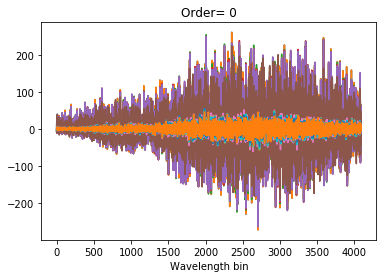

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

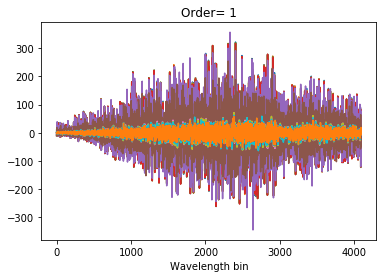

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

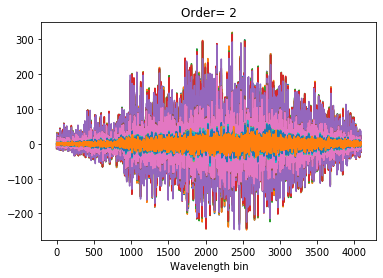

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

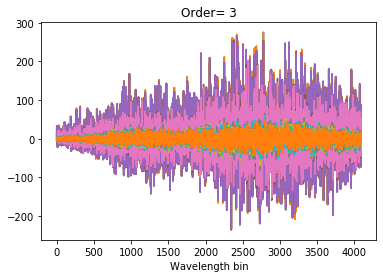

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

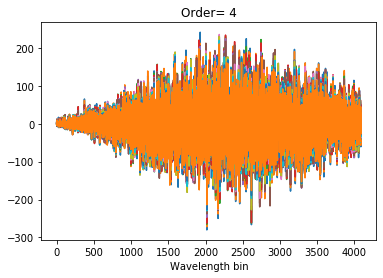

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

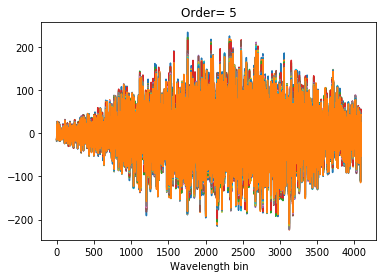

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

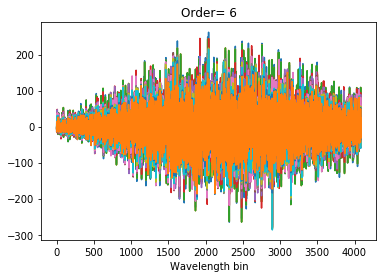

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

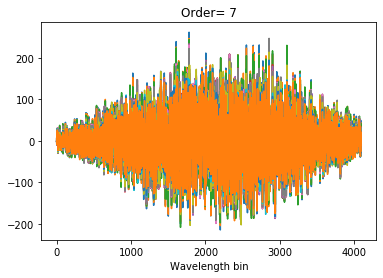

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

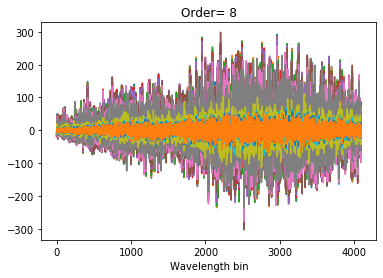

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

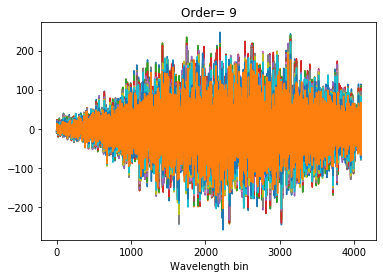

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

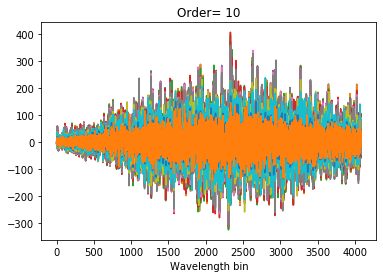

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

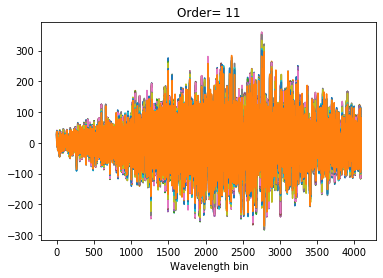

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

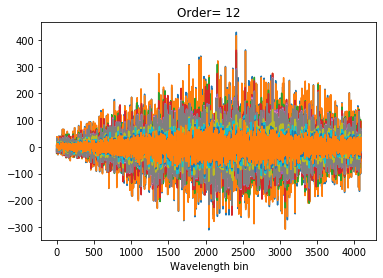

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

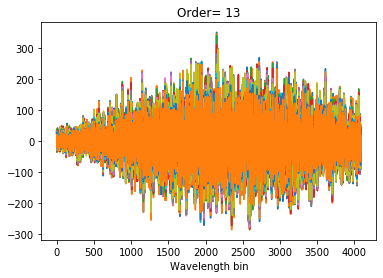

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

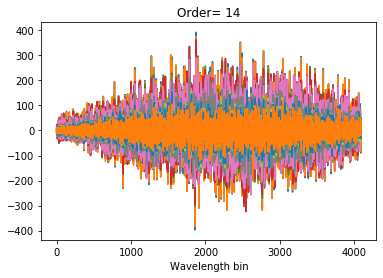

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

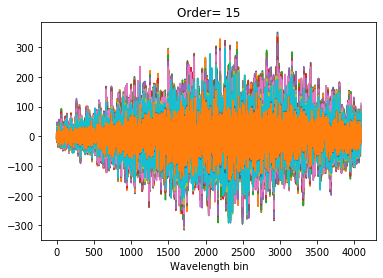

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

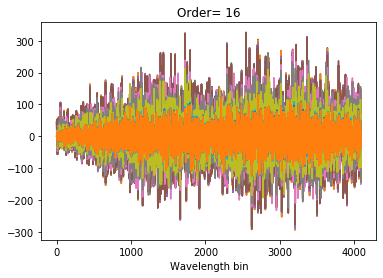

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

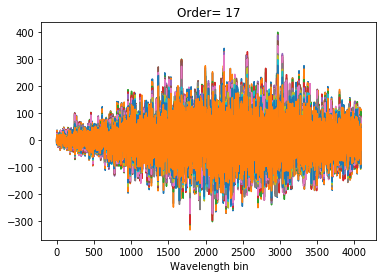

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

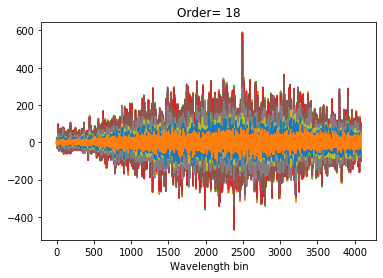

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

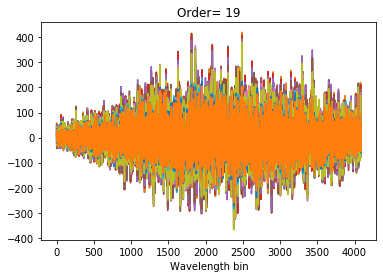

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

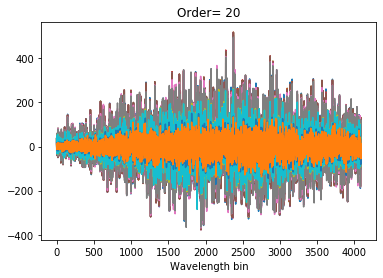

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

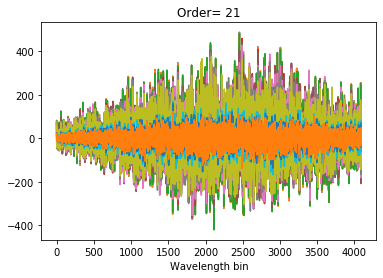

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

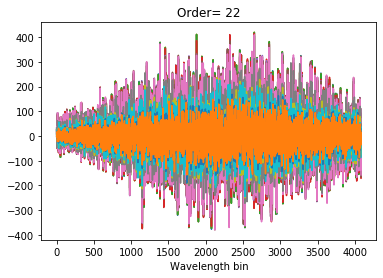

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

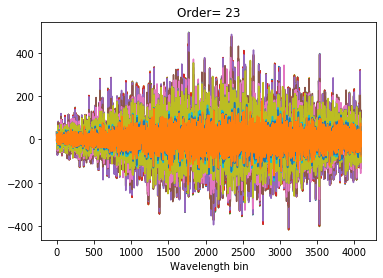

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

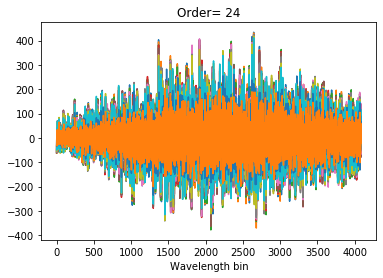

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

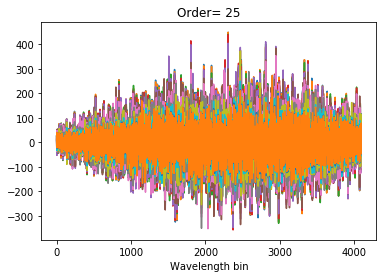

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

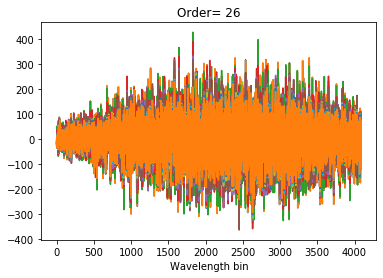

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

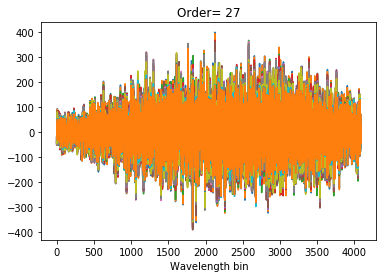

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

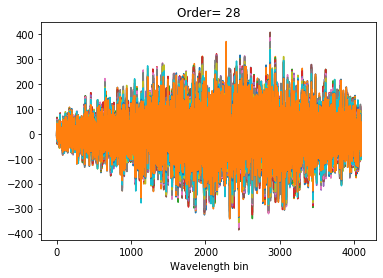

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

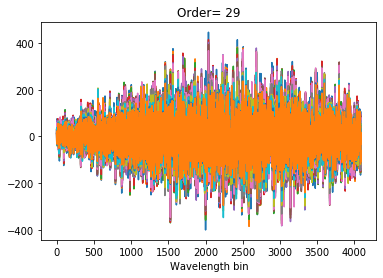

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

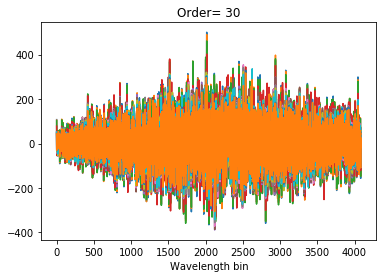

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

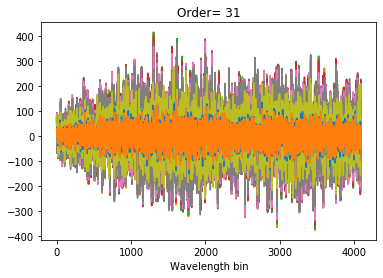

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

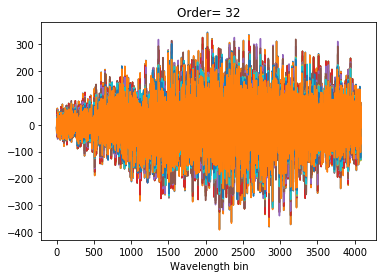

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

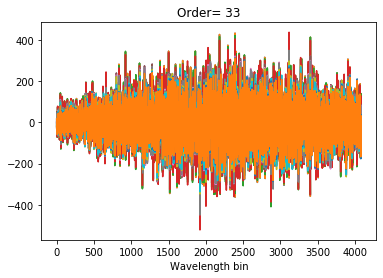

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

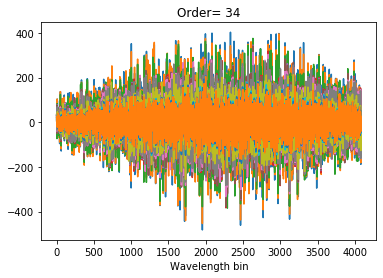

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

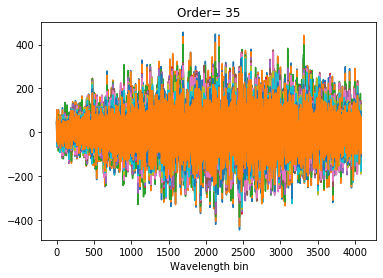

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

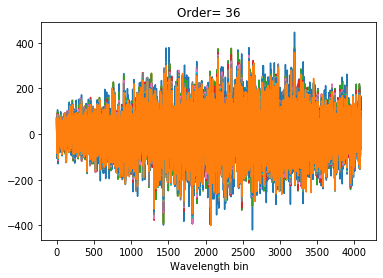

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

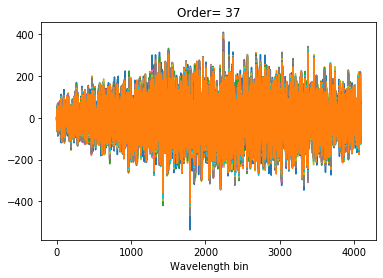

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

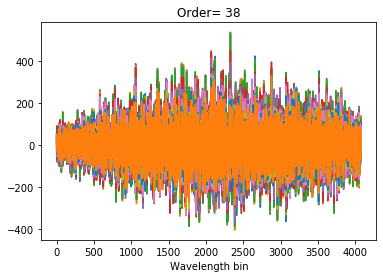

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

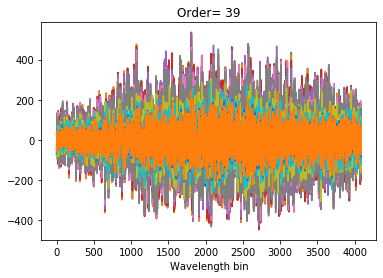

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

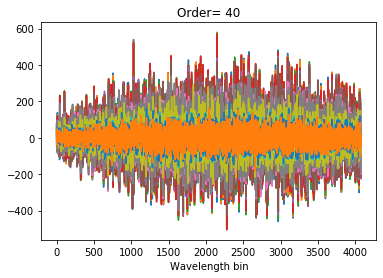

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

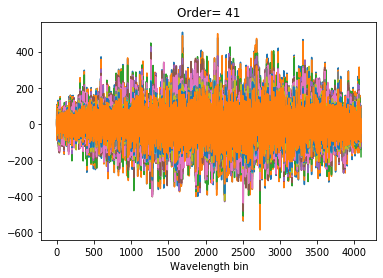

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

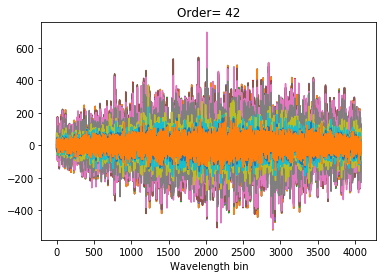

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

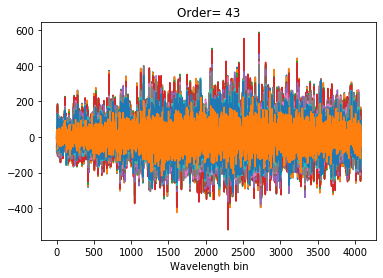

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

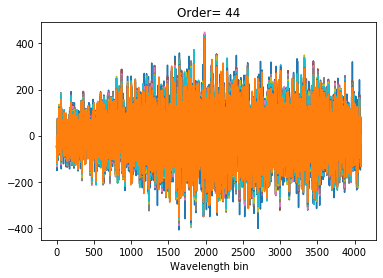

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

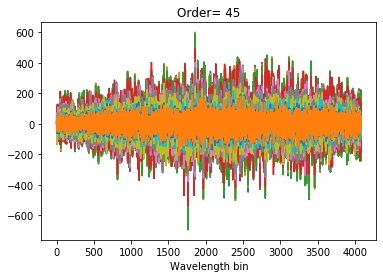

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

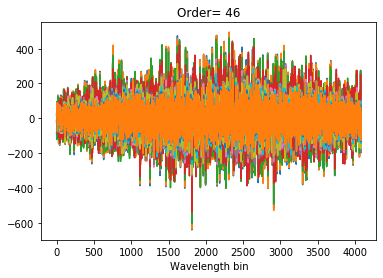

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

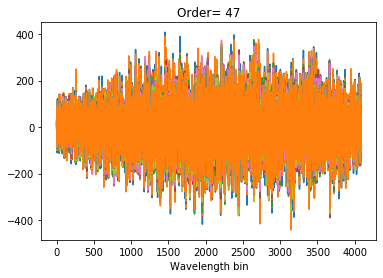

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

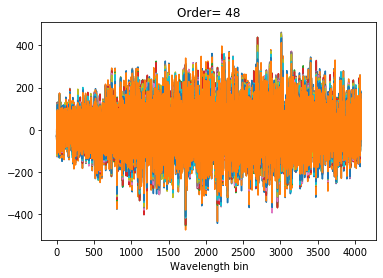

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

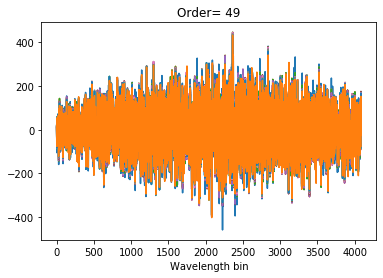

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

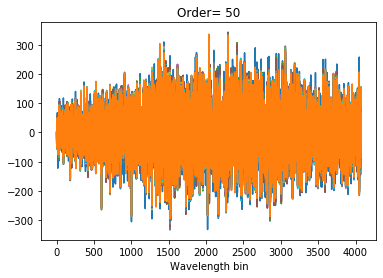

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

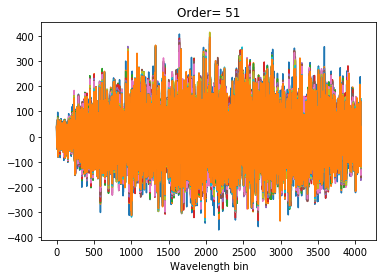

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

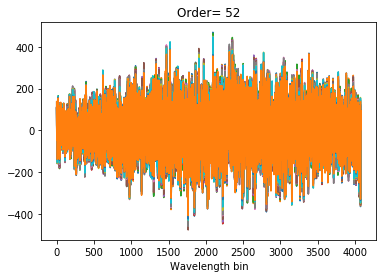

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

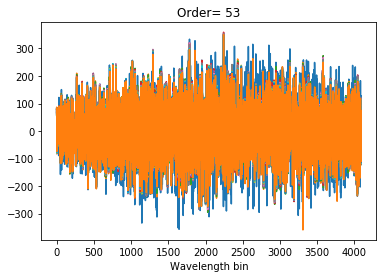

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

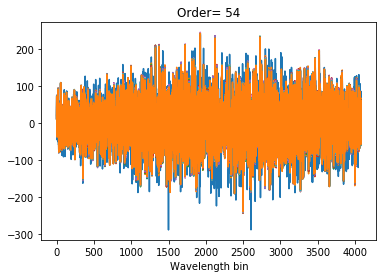

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

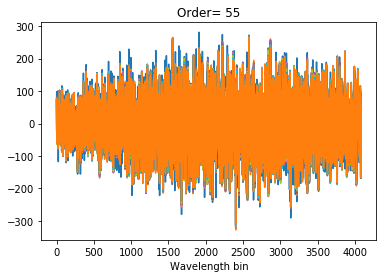

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

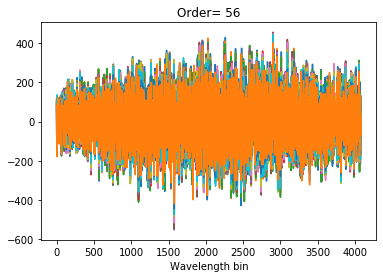

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

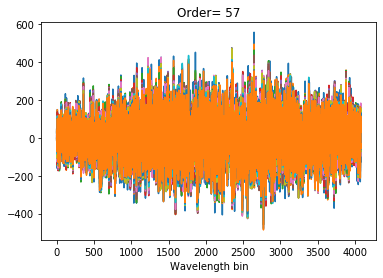

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

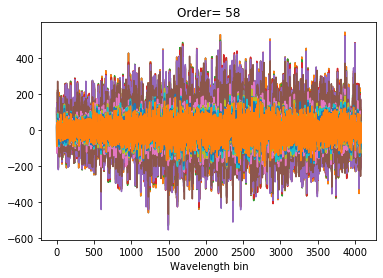

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

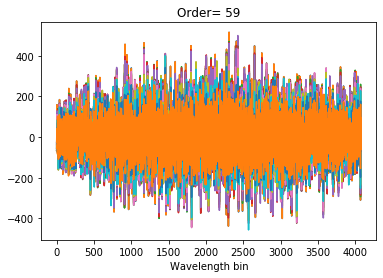

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

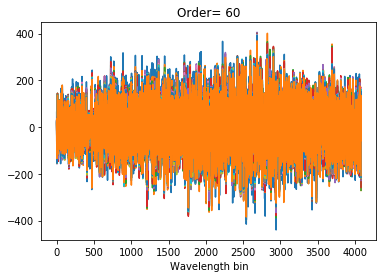

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

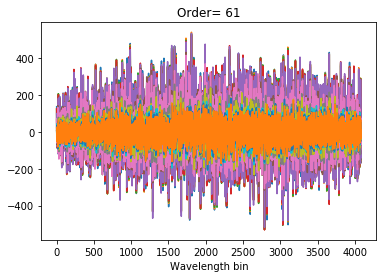

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

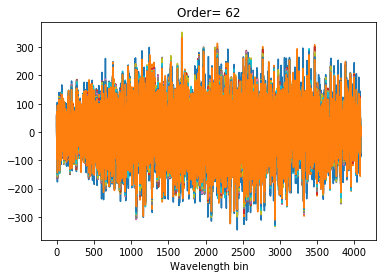

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

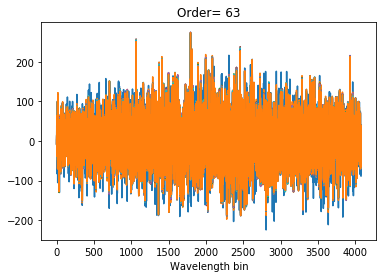

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

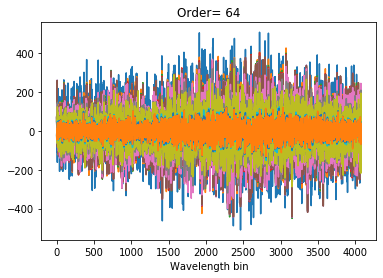

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

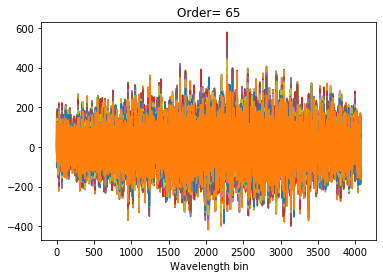

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

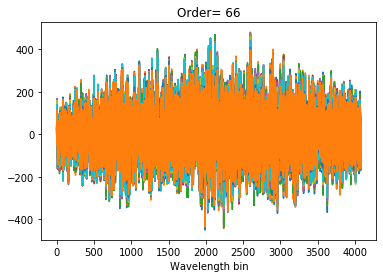

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

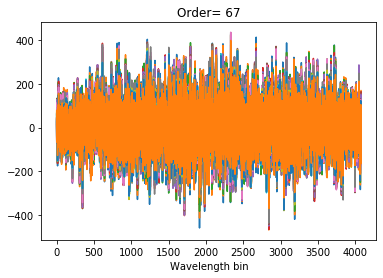

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


<Figure size 432x288 with 0 Axes>

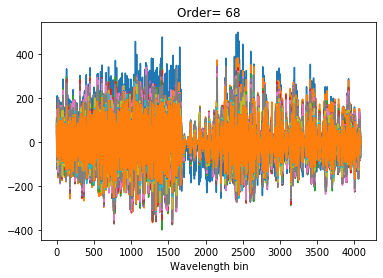

<Figure size 432x288 with 0 Axes>

In [55]:
n_sys=11
iteran=20000

input_file= "kelt9b-raw.h5"
output_file= input_file[:-3]+".postsys_true" # filename of the output

with  h5py.File(str(dir_result)+str(output_file), 'w') as h5f_sysrem:
    h5f_raw = h5py.File(str(dir_data)+str(input_file), 'r')

    airmass=h5f_raw["airmass"][:]

    for order in tnrange (69,ascii="True",desc= " Order:"):
        flux = h5f_raw["flux-order-"+str(order)][:] 
        error=(np.outer(np.std(flux,axis=1),np.std(flux,axis=0))/np.std(flux))

        sys_flux_order,sys_sys_order,a_sys,c_sys,a_std_sys,c_std_sys,error_sys=sysrem_full_flux(flux,error,n_sys,airmass,iteran)

        order_spec_sys=[]
        error_spec_sys=[]
        for sys in range(len(sys_flux_order)):
            order_spec=sys_flux_order[sys]
            totalerr=error_sys[sys]
            for wvbin in range(len(order_spec[0])):
                fl=order_spec[:,wvbin]
                c, low, upp =sigmaclip(fl, low=5,high=5)
                order_spec[:,wvbin][np.abs(fl-np.mean(c))>+5*np.std(c)]= np.mean(c)

            order_spec_sys.append(order_spec-np.median(order_spec,axis=1)[:,np.newaxis])
            error_spec_sys.append(totalerr)

        plt.figure()
        for i in range(len(sys_flux_order)):
            plt.plot((order_spec_sys/np.square(totalerr))[i][0])
        plt.xlabel('Wavelength bin')
        plt.title('Order= '+str(order))
        plt.show()
        plt.clf()

        h5f_sysrem.create_dataset("flux-order-"+str(order)+"sysrem", data=order_spec_sys,dtype='f', compression="gzip")
        h5f_sysrem.create_dataset("error-order-"+str(order)+"sysrem", data=error_spec_sys,dtype='f', compression="gzip")

    h5f_raw.close()


# Cross-correlation

## Definition

In [56]:
#Estimating the Doppler shift that we need for a range of Kp (orbital velocity) and Vsys (systemic velocity)
h5f_raw= h5py.File(str(dir_data)+"kelt9b-raw.h5", 'r')
rvcor=h5f_raw['rvcor'][:]
phase_p=h5f_raw['phase'][:]

kpmin  = -300
kpmax  =  300
vsysmin= -500
vsysmax=  500

v_step=1.

kp_sample= np.arange(kpmin,kpmax+v_step,v_step)
vsys_sample= np.arange(vsysmin,vsysmax+v_step,v_step)

v1=kpmax*np.sin(2.*np.pi*phase_p)+(vsysmax)-np.array(rvcor) #Positive means red shifted, predicted observed RV
v2=kpmin*np.sin(2.*np.pi*phase_p)+(vsysmax)-np.array(rvcor)
v3=kpmax*np.sin(2.*np.pi*phase_p)+(vsysmin)-np.array(rvcor)
v4=kpmin*np.sin(2.*np.pi*phase_p)+(vsysmin)-np.array(rvcor)

drvs= np.arange(np.min([v1,v2,v3,v4])-50., np.max([v1,v2,v3,v4])+50.+v_step, v_step)

## Doppler Shadow

In [61]:
def phoenix_read(wave_filename,flux_filename):
    fluxfits=fits.open(flux_filename)
    data_flux=fluxfits[0].data
    header_flux=fluxfits[0].header
    wvfits=fits.open(wave_filename)
    data_wv=wvfits[0].data
    header_wv=wvfits[0].header
    xphoe,yphoe=vac2air(data_wv),data_flux/intensity(vac2air(data_wv),header_flux["PHXTEFF"])
    return xphoe,yphoe,data_flux

def intensity(wavelength,temperature):
    upper=2*const.h.value*const.c.value**2*wavelength**-5
    lower=wavelength*const.k_B.value*temperature
    I_lamda= upper/(np.exp(const.h.value*const.c.value/lower)-1.)
    return I_lamda

In [ ]:
h5f_raw= h5py.File(str(dir_data)+"kelt9b-raw.h5", 'r')
rvcor=h5f_raw['rvcor'][:]
phase_p=h5f_raw['phase'][:]

kpmin  = -300
kpmax  =  300
vsysmin= -500
vsysmax=  500

v_step=1.

kp_sample= np.arange(kpmin,kpmax+v_step,v_step)
vsys_sample= np.arange(vsysmin,vsysmax+v_step,v_step)

v1=kpmax*np.sin(2.*np.pi*phase_p)+(vsysmax)-np.array(rvcor) #Positive means red shifted, predicted observed RV
v2=kpmin*np.sin(2.*np.pi*phase_p)+(vsysmax)-np.array(rvcor)
v3=kpmax*np.sin(2.*np.pi*phase_p)+(vsysmin)-np.array(rvcor)
v4=kpmin*np.sin(2.*np.pi*phase_p)+(vsysmin)-np.array(rvcor)

drvs= np.arange(np.min([v1,v2,v3,v4])-50., np.max([v1,v2,v3,v4])+50.+v_step, v_step)

You can download the high-resolution stellar spectrum model from http://phoenix.astro.physik.uni-goettingen.de/?page_id=15 

In [66]:
xphoe,yphoe,data_flux=phoenix_read('../model/WAVE_PHOENIX-ACES-AGSS-COND-2011.fits',\
                                   '../model/lte10200-4.00-0.0.PHOENIX-ACES-AGSS-COND-2011-HiRes.fits')
mask=(xphoe>1000)*(xphoe<11000)
w_modelphoe=np.arange(3000,9000,0.02)
w_mod,s_model=xphoe[mask],data_flux[mask]#/intensity(np.array(xphoe[mask])*1e-10,14000)
s_modeleqwv=sci.interp1d(w_mod,s_model)(w_modelphoe)


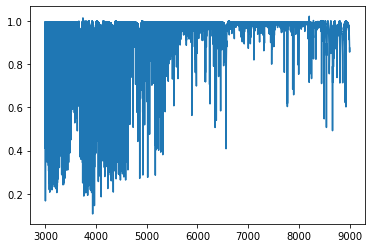

In [75]:
#Removing the continuum using maximum filter

binsize=800
binned=[]
x=[]
for i in range(0,s_modeleqwv.shape[0]-binsize,binsize):
    x.append(i+binsize/2.)
    binned.append(np.max(s_modeleqwv[i:i+binsize]))
conti_=sci.interp1d(np.asarray(x),np.asarray(binned),
                     kind='linear',bounds_error=False,fill_value='extrapolate')(np.arange(s_modeleqwv.shape[0]))

s_norm=s_modeleqwv/conti_  

plt.plot(w_modelphoe,s_norm)


In [76]:
#convolving the spectrum to HARPSN spectral resolution
s_modelphoe = pyasl.instrBroadGaussFast(w_modelphoe,s_norm, 115000,edgeHandling="firstlast")


In [77]:
#Saving to hdf5 file
with h5py.File(str(dir_model)+"kelt9b-phoenix_spectrum-harpsn.h5", 'w') as h5f_spec:
    h5f_spec.create_dataset("flux",data=s_modelphoe, compression="gzip", compression_opts=9)
    h5f_spec.create_dataset("wv",data=w_modelphoe, compression="gzip", compression_opts=9)

In [93]:
#Creating Doppler shifted stellar template

h5f_raw= h5py.File(str(dir_data)+"kelt9b-raw.h5", 'r')
h5f_spec = h5py.File(str(dir_model)+"kelt9b-phoenix_spectrum-harpsn.h5", 'r') 

with h5py.File(str(dir_model)+"dopplershadow-harpsn-cc-template.h5", 'w')  as h5f_temp:
    w_model,s_model=h5f_spec["wv"][:],h5f_spec["flux"][:]
    for order in tnrange(69):
        w=h5f_raw["wv-order-"+str(order)][:]
        masked=(w_model>w[0]-50)*(w_model<w[-1]+50)
        xtemp,ytempnorm=w_model[masked],s_model[masked]
        template_exo = np.zeros(shape=(len(drvs),len(w)),dtype="float")
        for i in range(len(drvs)):
            fi = sci.interp1d(xtemp*(1.0 + (drvs[i])*1000./const.c.value), ytempnorm)
            template_exo[i,:]= fi(w)
        h5f_temp.create_dataset("order"+str(order),data=template_exo, compression="gzip", compression_opts=9)
    h5f_temp.create_dataset("kp",data=kp_sample)
    h5f_temp.create_dataset("vsys",data=vsys_sample)
    h5f_temp.create_dataset("v_step",data=v_step)
    h5f_temp.create_dataset("drvs",data=drvs)
    
    h5f_spec.close()
    h5f_raw.close()

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:8: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`
  


In [94]:
def crossvar(fa,fia):
    fib    = np.transpose(fia)
    cc    = np.dot(fa,fib)
    return cc

In [95]:
with h5py.File(str(dir_result)+"dopplershadow.cc",'w') as h5f_cc:
    h5f_raw= h5py.File(str(dir_data)+"kelt9b-raw.h5", 'r')
    h5f_reduced= h5py.File(str(dir_result)+"kelt9b-raw.postsys_true", 'r')
    h5f_temp=h5py.File(str(dir_model)+"dopplershadow-harpsn-cc-template.h5", 'r')
    drvs=h5f_temp['drvs'][:]
    for order in tqdm_notebook(range(69)):
        y_temp_order= h5f_temp["order"+str(order)][:]
        y_temp_order= y_temp_order-np.median(y_temp_order,axis=1)[:,np.newaxis]
        
        cc_col=[]
        for sys in range(11):
            order_ready = h5f_reduced["flux-order-"+str(order)+'sysrem'][:][sys]
            var         = np.square(h5f_reduced["error-order-"+str(order)+'sysrem'][:][sys])
            order_ready = order_ready-np.median(order_ready,axis=1)[:,np.newaxis]
            CC= crossvar(order_ready/var,y_temp_order)
            cc_col.append(CC)
        h5f_cc.create_dataset("CC_Order_"+str(order),data=cc_col, compression="gzip", compression_opts=9)
    h5f_cc.create_dataset('drvs',data=drvs)
    h5f_cc.create_dataset('kp',data=kp_sample)
    h5f_cc.create_dataset('vsys',data=vsys_sample)
    h5f_temp.close()
    h5f_reduced.close()

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:6: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


In [84]:
def kpvsys_calc(kp,vsys,drvs,data,orb_phase,brv,mask):
    data=data[mask]
    orb_phase=orb_phase[mask]
    brv=brv[mask]
    
    Dresamp= np.zeros((len(kp),len(orb_phase),len(vsys)))
    for i,kp_i in enumerate(kp):
        v_predicted=kp_i*np.sin(2.*np.pi*orb_phase)+brv
        for orb in range(orb_phase.size):
          Dresamp[i,orb] = sci.interp1d(drvs,data[orb],kind="linear")(v_predicted[orb]+vsys)
    summed=Dresamp.sum(axis=1)
    return summed
def kp_fig1(kp_dvmap_all,kp_sample,dv_sample,name):
    plt.figure(figsize=(7,4))
    
    kp_indmax,dv_indmax = np.unravel_index(kp_dvmap_all.argmax(),kp_dvmap_all.shape)
    
    maskedpeak=np.abs(kp_dvmap_all)>-1
    if kp_sample[kp_indmax]+100 >np.max(kp_sample):
        kp_maskpeak=np.array([np.digitize([kp_sample[kp_indmax]-100],kp_sample)[0],np.argmax(kp_sample)])
    else:
        kp_maskpeak=np.digitize([kp_sample[kp_indmax]-100,kp_sample[kp_indmax]+100],kp_sample)

    dv_maskpeak=np.digitize([dv_sample[dv_indmax]-100,dv_sample[dv_indmax]+100],dv_sample)

    maskedpeak[kp_maskpeak[0]:kp_maskpeak[1],dv_maskpeak[0]:dv_maskpeak[1]]=1<0

    snmap=kp_dvmap_all/np.std(kp_dvmap_all[maskedpeak])
    

    axScatter = plt.subplot(1,1,1)
    axScatter.pcolormesh(dv_sample,kp_sample,snmap,cmap=cm.inferno,rasterized=True)
    
    axScatter.set_xlabel("$\Delta$V (km/s)",size=12)
    axScatter.set_ylabel("K$_{p}$ (km/s)",size=12)
#     axScatter.axvline(x=dv_sample[dv_indmax],color="white",ls="--",alpha= 0.5)
#     axScatter.axhline(y=kp_sample[kp_indmax],color="white",ls="--",alpha= 0.5)
    axScatter.tick_params(which="both",direction='in',labelsize=14)

    plt.subplots_adjust(wspace = 0.0)
    plt.subplots_adjust(hspace = 0.0)
    plt.show()
    print (kp_sample[kp_indmax])
    print (dv_sample[dv_indmax])
    print (snmap[kp_indmax,dv_indmax])
    return snmap[kp_indmax,dv_indmax],kp_sample[kp_indmax]
def fakevl_calc(kp,vsys,drvs,data,orb_phase,brv,mask):
    data=data[mask]
    orb_phase=orb_phase[mask]
    brv=brv[mask]
    
    Dresamp = np.zeros([kp.size]+[data[1].size]+[vsys.size])
    for i,k in enumerate(kp):
        v_predicted=k*orb_phase+brv
        for n in range(orb_phase.size):
          Dresamp[i,n] = sci.interp1d(drvs,data[n],kind="linear")(v_predicted[n]+vsys)
    summed=Dresamp.sum(axis=1)
    
    return summed

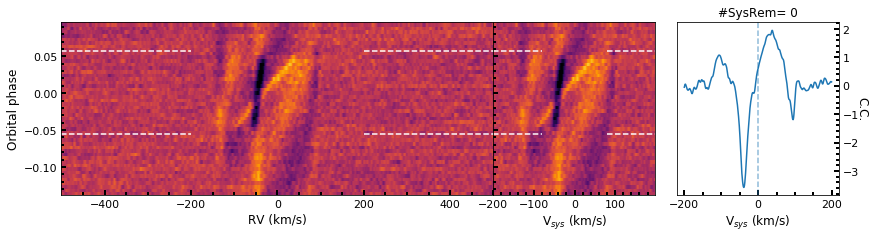

<Figure size 432x288 with 0 Axes>

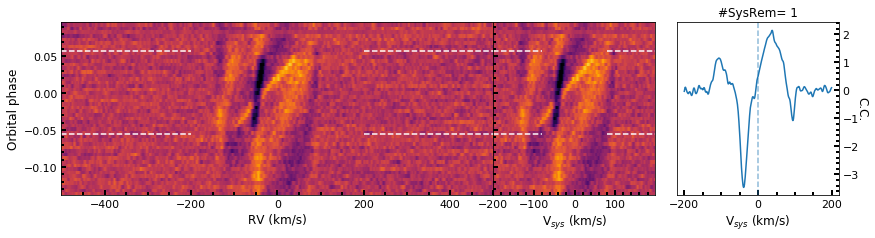

<Figure size 432x288 with 0 Axes>

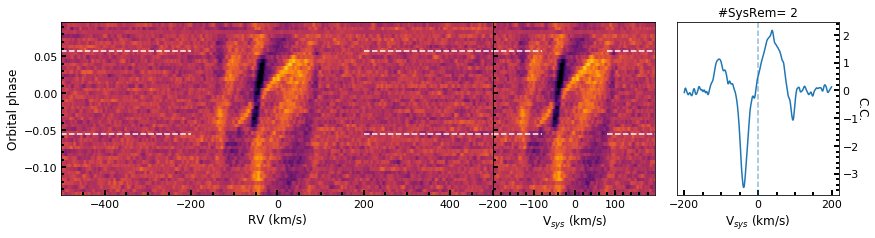

<Figure size 432x288 with 0 Axes>

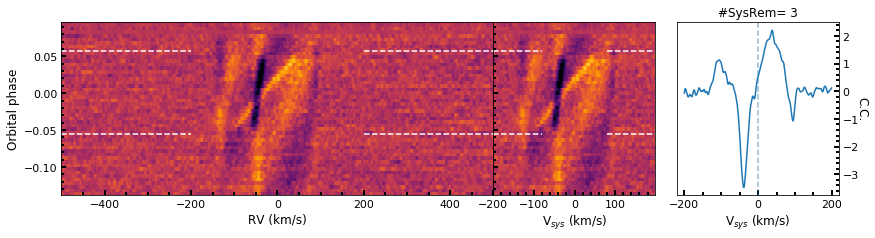

<Figure size 432x288 with 0 Axes>

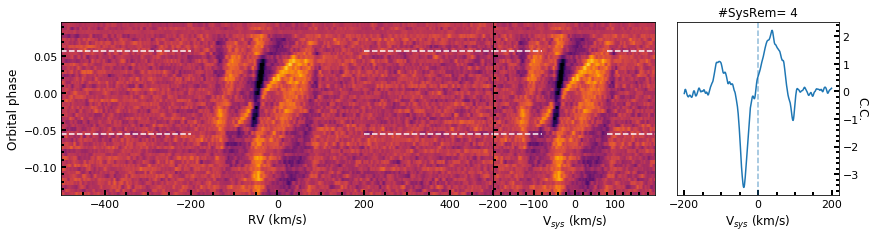

<Figure size 432x288 with 0 Axes>

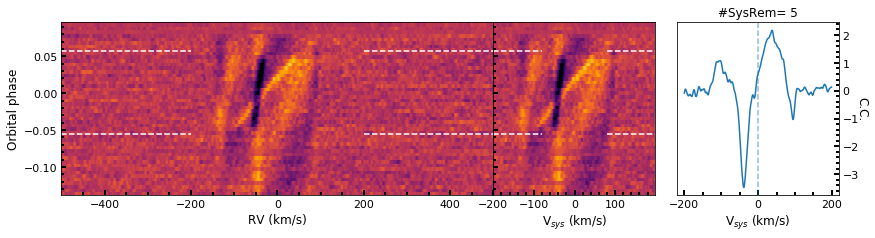

<Figure size 432x288 with 0 Axes>

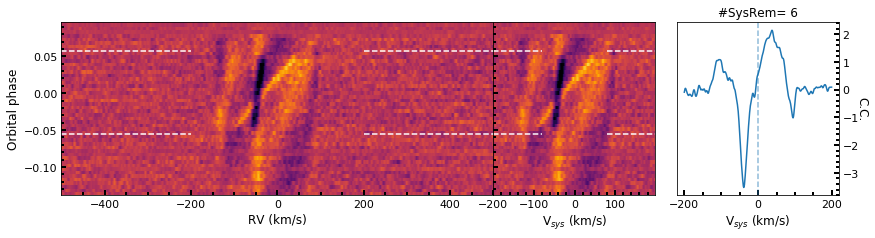

<Figure size 432x288 with 0 Axes>

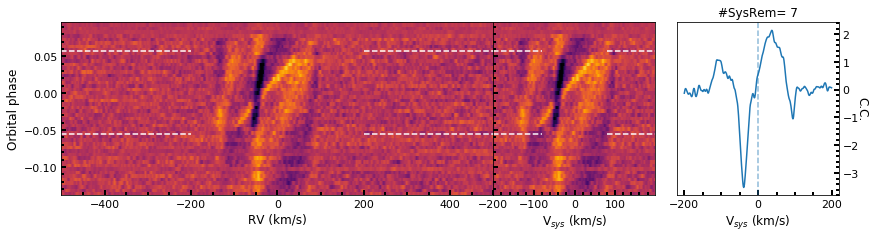

<Figure size 432x288 with 0 Axes>

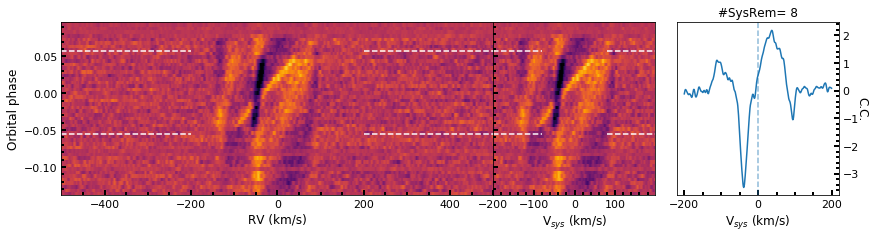

<Figure size 432x288 with 0 Axes>

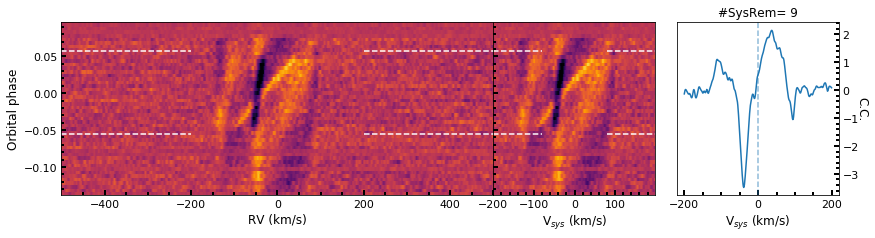

<Figure size 432x288 with 0 Axes>

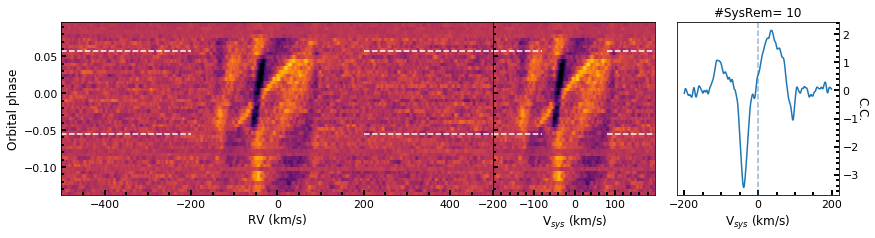

<Figure size 432x288 with 0 Axes>

In [99]:
rect_im1 = [0.05, 0.8, 0.4,0.4]
rect_im2 = [0.05+0.4, 0.8, 0.15, 0.4]
rect_imcc= [0.05+0.4+0.15+0.02, 0.8, 0.15,0.4]      

h5f_cc=h5py.File(str(dir_result)+"dopplershadow.cc",'r')

h5f_raw=h5py.File(str(dir_data)+"kelt9b-raw.h5", 'r')

drvs       = h5f_cc['drvs'][:]
vsys_sample= h5f_cc['vsys'][:]
kp_sample  = h5f_cc['kp'][:]
phase_p    = h5f_raw['phase'][:]
rvcor      = h5f_raw['rvcor'][:]
scaletrans = h5f_raw['scaletrans'][:]
tw         = h5f_raw['tw'][:]

vsys_sample=np.array(np.arange(-200,200,1))

summed_all=[]
cc_alg=[]
for sys in range(11):
    
        cc_orderall=[]
        for order in range(69):
            if order ==38:
                pass
            else:            
                cc_orderall.append(h5f_cc["CC_Order_"+str(order)][:][sys])

        cc_tot_=np.sum(cc_orderall,axis=0)-np.median(np.sum(cc_orderall,axis=0),axis=1)[:,np.newaxis]
        cc_tot_norm=cc_tot_#/np.abs(np.min(cc_tot_))
        mask=scaletrans>0

        rv_expected= -rvcor
        cc_alg1=np.zeros((len(phase_p),len(vsys_sample)))
        
        for ph in range (len(phase_p)):
            v_ex=vsys_sample+rv_expected[ph]
            f_rv=sci.interp1d(drvs,cc_tot_norm[ph])
            cc_alg1[ph]=f_rv(v_ex)

        cc_alg.append(cc_alg1)

        transitweight=np.outer(scaletrans,np.ones(len(cc_alg1[0])))
        masked_max=np.abs(np.sum(cc_alg1,axis=0)) >0
        zer1,zer2=np.digitize([-300,300],drvs)
        masked_max[zer1:zer2]=1<0

        mask=(scaletrans>0)
        summedcc=np.sum(cc_alg1[mask],axis=0)
        summed_all.append(summedcc)
        sn_curve=summedcc/np.std(summedcc[masked_max])

        plt.figure(figsize=(15,6))
        ax1=plt.axes(rect_im1)
        ax1.pcolormesh(drvs,phase_p,cc_tot_norm,cmap=cm.inferno,vmin=np.mean(cc_alg1)-5*np.std(cc_alg1),
                       vmax=np.mean(cc_alg1)+5*np.std(cc_alg1))
        ax1.set_ylabel("Orbital phase",size=12)
        ax1.set_xlabel("RV (km/s)",size=12)
        ax1.minorticks_on()
        ax1.axhline(xmin=0.0,xmax=0.3,y=phase_p[scaletrans>0][0],ls='--',color='white')
        ax1.axhline(xmin=0.7,xmax=1.0,y=phase_p[scaletrans>0][0],ls='--',color='white')
        ax1.axhline(xmin=0.0,xmax=0.3,y=phase_p[scaletrans>0][-1],ls='--',color='white')        
        ax1.axhline(xmin=0.7,xmax=1.0,y=phase_p[scaletrans>0][-1],ls='--',color='white')        
        ax1.tick_params(which="both",direction='in',length=3, width=2,labelsize=11)
        ax1.tick_params(which="major",direction='in',length=5, width=2)
        ax1.set_xlim(-500,500)
        
        ax2=plt.axes(rect_im2)
        im2=ax2.pcolormesh(vsys_sample,phase_p,cc_alg1,cmap=cm.inferno,vmin=np.mean(cc_alg1)-5*np.std(cc_alg1),
                           vmax=np.mean(cc_alg1)+5*np.std(cc_alg1))
        ax2.set_ylabel("")
        ax2.set_xlabel("V$_{sys}$ (km/s)",size=12)
        ax2.minorticks_on()
        ax2.tick_params(which="both",direction='in',length=3, width=2,labelsize=11)
        ax2.tick_params(which="major",direction='in',length=5, width=2)
        ax2.set_yticklabels("")
        ax2.axhline(xmin=0.0,xmax=0.3,y=phase_p[scaletrans>0][0],ls='--',color='white')
        ax2.axhline(xmin=0.7,xmax=1.0,y=phase_p[scaletrans>0][0],ls='--',color='white')
        ax2.axhline(xmin=0.0,xmax=0.3,y=phase_p[scaletrans>0][-1],ls='--',color='white')        
        ax2.axhline(xmin=0.7,xmax=1.0,y=phase_p[scaletrans>0][-1],ls='--',color='white')        
        
        ax3=plt.axes(rect_imcc)
        ax3.plot(vsys_sample,sn_curve,"-")
        ax3.axvline(x=0,ls="--",alpha=0.5)
        ax3.set_xlabel("V$_{sys}$ (km/s)",size=12)
        ax3.yaxis.set_ticks_position('right')
        ax3.set_ylabel("C.C.",size=12,rotation=270,labelpad=10)
        ax3.yaxis.set_label_position("right")
        ax3.minorticks_on()
        ax3.tick_params(which="both",direction='in',length=3, width=2,labelsize=11)
        ax3.tick_params(which="major",direction='in',length=5, width=2)
        plt.title('#SysRem= '+str(sys))
        plt.show()
        plt.clf()

h5f_cc.close()
h5f_raw.close()


## Species in Planet's Atmosphere

The planetary spectrum template can be downloaded from http://cdsarc.u-strasbg.fr/ftp/J/A+A/627/A165/fits/

In [121]:
h5f_raw= h5py.File(str(dir_data)+"kelt9b-raw.h5", 'r')
rvcor=h5f_raw['rvcor'][:]
phase_p=h5f_raw['phase'][:]

kpmin  =    0
kpmax  =  300
vsysmin= -300
vsysmax=  300

v_step=1.

kp_sample= np.arange(kpmin,kpmax+v_step,v_step)
vsys_sample= np.arange(vsysmin,vsysmax+v_step,v_step)

v1=kpmax*np.sin(2.*np.pi*phase_p)+(vsysmax)-np.array(rvcor) #Positive means red shifted, predicted observed RV
v2=kpmin*np.sin(2.*np.pi*phase_p)+(vsysmax)-np.array(rvcor)
v3=kpmax*np.sin(2.*np.pi*phase_p)+(vsysmin)-np.array(rvcor)
v4=kpmin*np.sin(2.*np.pi*phase_p)+(vsysmin)-np.array(rvcor)

drvs= np.arange(np.min([v1,v2,v3,v4])-50., np.max([v1,v2,v3,v4])+50.+v_step, v_step)

In [119]:
#Load model for Fe II
hdu=fits.open(str(dir_model)+'4000K_1_Fe_p.fits') # wavelength in nm, vacuum
wv,flux=hdu[0].data[0]*10.,hdu[0].data[1] #wavelength in Angstrom
wv_ind=np.argsort(wv) #sorting the wavelength

w_model,s_model=vac2air(wv[wv_ind]),flux[wv_ind] #air wavelength

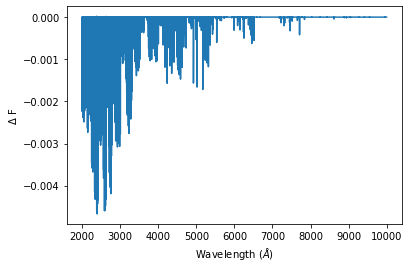

<Figure size 432x288 with 0 Axes>

In [120]:
#Maximum filter to remove the upper envelope
binsize=800
binned=[]
x=[]
for i in range(0,s_model.shape[0]-binsize,binsize):
   x.append(i+binsize/2.)
   binned.append(np.max(s_model[i:i+binsize]))
conti_=sci.interp1d(np.asarray(x),np.asarray(binned),
                     kind='linear',bounds_error=False,fill_value='extrapolate')(np.arange(s_model.shape[0]))

s_norm=s_model-conti_   
plt.figure()
plt.plot(w_model,s_norm)
plt.xlabel('Wavelength ($\AA$)')
plt.ylabel('$\Delta$ F')
plt.show()
plt.clf()

In [122]:
#Creating Doppler shifted stellar template

h5f_raw= h5py.File(str(dir_data)+"kelt9b-raw.h5", 'r')

with h5py.File(str(dir_model)+"kelt9b-FeII-cc-template.h5", 'w')  as h5f_temp:
    w_model,s_model=w_model,s_norm
    for order in tnrange(69):
        w=h5f_raw["wv-order-"+str(order)][:]
        masked=(w_model>w[0]-50)*(w_model<w[-1]+50)
        xtemp,ytempnorm=w_model[masked],s_model[masked]
        template_exo = np.zeros(shape=(len(drvs),len(w)),dtype="float")
        for i in range(len(drvs)):
            fi = sci.interp1d(xtemp*(1.0 + (drvs[i])*1000./const.c.value), ytempnorm)
            template_exo[i,:]= fi(w)
        h5f_temp.create_dataset("order"+str(order),data=template_exo, compression="gzip", compression_opts=9)
    h5f_temp.create_dataset("kp",data=kp_sample)
    h5f_temp.create_dataset("vsys",data=vsys_sample)
    h5f_temp.create_dataset("v_step",data=v_step)
    h5f_temp.create_dataset("drvs",data=drvs)
    
    h5f_spec.close()
    h5f_raw.close()

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:7: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`
  import sys


In [ ]:
def crossvar(fa,fia):
    fib    = np.transpose(fia)
    cc    = np.dot(fa,fib)
    return cc

In [124]:
with h5py.File(str(dir_result)+"FeII.cc",'w') as h5f_cc:
    h5f_raw= h5py.File(str(dir_data)+"kelt9b-raw.h5", 'r')
    h5f_reduced= h5py.File(str(dir_result)+"kelt9b-raw.postsys_true", 'r')
    h5f_temp=h5py.File(str(dir_model)+"kelt9b-FeII-cc-template.h5", 'r')
    drvs=h5f_temp['drvs'][:]
    for order in tqdm_notebook(range(69)):
        y_temp_order= h5f_temp["order"+str(order)][:]
        y_temp_order= y_temp_order-np.median(y_temp_order,axis=1)[:,np.newaxis]
        
        cc_col=[]
        for sys in range(11):
            order_ready = h5f_reduced["flux-order-"+str(order)+'sysrem'][:][sys]
            var         = np.square(h5f_reduced["error-order-"+str(order)+'sysrem'][:][sys])
            order_ready = order_ready-np.median(order_ready,axis=1)[:,np.newaxis]
            CC= crossvar(order_ready/var,y_temp_order)
            cc_col.append(CC)
        h5f_cc.create_dataset("CC_Order_"+str(order),data=cc_col, compression="gzip", compression_opts=9)
    h5f_cc.create_dataset('drvs',data=drvs)
    h5f_cc.create_dataset('kp',data=kp_sample)
    h5f_cc.create_dataset('vsys',data=vsys_sample)
    h5f_temp.close()
    h5f_reduced.close()

/Users/snugroho/anaconda3/envs/astroconda/lib/python3.7/site-packages/ipykernel_launcher.py:7: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  import sys


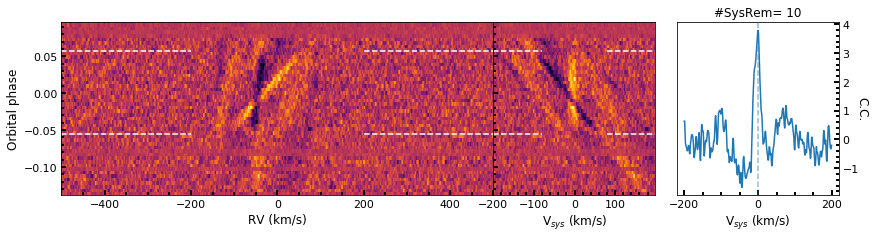

<Figure size 432x288 with 0 Axes>

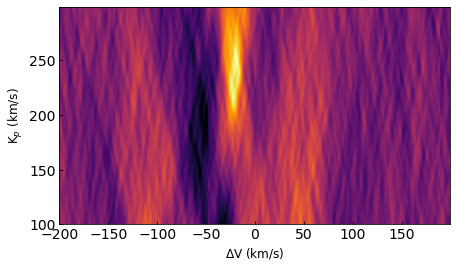

250
-19
6.912432603093849


In [129]:
rect_im1 = [0.05, 0.8, 0.4,0.4]
rect_im2 = [0.05+0.4, 0.8, 0.15, 0.4]
rect_imcc= [0.05+0.4+0.15+0.02, 0.8, 0.15,0.4]      

with h5py.File(str(dir_result)+"FeII.cc",'r') as h5f_cc:
    h5f_raw=h5py.File(str(dir_data)+"kelt9b-raw.h5", 'r')

    drvs       = h5f_cc['drvs'][:]
    vsys_sample= h5f_cc['vsys'][:]
    kp_sample  = np.arange(100,300,1)#h5f_cc['kp'][:]
    
    phase_p    = h5f_raw['phase'][:]
    rvcor      = h5f_raw['rvcor'][:]
    scaletrans = h5f_raw['scaletrans'][:]
    tw         = h5f_raw['tw'][:]

    vsys_sample=np.array(np.arange(-200,200,1))

    summed_all=[]
    cc_alg=[]
    for sys in range(10,11):
            cc_orderall=[]
            for order in range(69):
                cc_orderall.append(h5f_cc["CC_Order_"+str(order)][:][sys])

            cc_tot_=np.sum(cc_orderall,axis=0)-np.median(np.sum(cc_orderall,axis=0),axis=1)[:,np.newaxis]
            cc_tot_norm=cc_tot_
            mask=scaletrans>0

            rv_expected= 251*np.sin(2*np.pi*phase_p)-rvcor-19
            cc_alg1=np.zeros((len(phase_p),len(vsys_sample)))
            for ph in range (len(phase_p)):
                v_ex=vsys_sample+rv_expected[ph]
                f_rv=sci.interp1d(drvs,cc_tot_norm[ph])
                cc_alg1[ph]=f_rv(v_ex)
            cc_alg.append(cc_alg1)

            transitweight=np.outer(scaletrans,np.ones(len(cc_alg1[0])))
            masked_max=np.abs(np.sum(cc_alg1,axis=0)) >0
            zer1,zer2=np.digitize([-300,300],drvs)
            masked_max[zer1:zer2]=1<0

            mask=(scaletrans>0) #masking the out of transit data
            summedcc=np.sum(cc_alg1[mask],axis=0)
            summed_all.append(summedcc)
            sn_curve=summedcc/np.std(summedcc[masked_max])

            plt.figure(figsize=(15,6))
            ax1=plt.axes(rect_im1)
            ax1.pcolormesh(drvs,phase_p,cc_tot_norm,cmap=cm.inferno,vmin=np.mean(cc_alg1)-5*np.std(cc_alg1),
                           vmax=np.mean(cc_alg1)+5*np.std(cc_alg1))
            ax1.set_ylabel("Orbital phase",size=12)
            ax1.set_xlabel("RV (km/s)",size=12)
            ax1.minorticks_on()
            ax1.axhline(xmin=0.0,xmax=0.3,y=phase_p[scaletrans>0][0],ls='--',color='white')
            ax1.axhline(xmin=0.7,xmax=1.0,y=phase_p[scaletrans>0][0],ls='--',color='white')
            ax1.axhline(xmin=0.0,xmax=0.3,y=phase_p[scaletrans>0][-1],ls='--',color='white')        
            ax1.axhline(xmin=0.7,xmax=1.0,y=phase_p[scaletrans>0][-1],ls='--',color='white')        
            ax1.tick_params(which="both",direction='in',length=3, width=2,labelsize=11)
            ax1.tick_params(which="major",direction='in',length=5, width=2)
            ax1.set_xlim(-500,500)

            ax2=plt.axes(rect_im2)
            im2=ax2.pcolormesh(vsys_sample,phase_p,cc_alg1,cmap=cm.inferno,vmin=np.mean(cc_alg1)-5*np.std(cc_alg1),
                               vmax=np.mean(cc_alg1)+5*np.std(cc_alg1))
            ax2.set_ylabel("")
            ax2.set_xlabel("V$_{sys}$ (km/s)",size=12)
            ax2.minorticks_on()
            ax2.tick_params(which="both",direction='in',length=3, width=2,labelsize=11)
            ax2.tick_params(which="major",direction='in',length=5, width=2)
            ax2.set_yticklabels("")
            ax2.axhline(xmin=0.0,xmax=0.3,y=phase_p[scaletrans>0][0],ls='--',color='white')
            ax2.axhline(xmin=0.7,xmax=1.0,y=phase_p[scaletrans>0][0],ls='--',color='white')
            ax2.axhline(xmin=0.0,xmax=0.3,y=phase_p[scaletrans>0][-1],ls='--',color='white')        
            ax2.axhline(xmin=0.7,xmax=1.0,y=phase_p[scaletrans>0][-1],ls='--',color='white')        

            ax3=plt.axes(rect_imcc)
            ax3.plot(vsys_sample,sn_curve,"-")
            ax3.axvline(x=0,ls="--",alpha=0.5)
            ax3.set_xlabel("V$_{sys}$ (km/s)",size=12)
            ax3.yaxis.set_ticks_position('right')
            ax3.set_ylabel("C.C.",size=12,rotation=270,labelpad=10)
            ax3.yaxis.set_label_position("right")
            ax3.minorticks_on()
            ax3.tick_params(which="both",direction='in',length=3, width=2,labelsize=11)
            ax3.tick_params(which="major",direction='in',length=5, width=2)
            plt.title('#SysRem= '+str(sys))
            plt.show()
            plt.clf()

            summed=kpvsys_calc(kp_sample,vsys_sample,drvs,cc_tot_norm*tw[:,np.newaxis],
                               np.array(phase_p),-np.array(rvcor),mask)

            snaftr=kp_fig1(summed,kp_sample,vsys_sample,'Fe II')
    h5f_raw.close()
